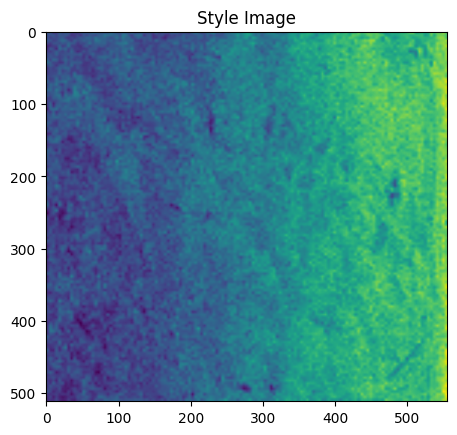

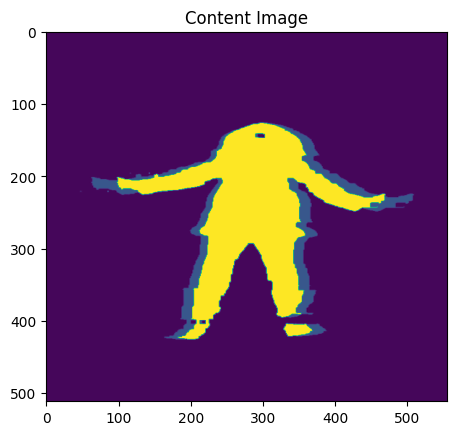

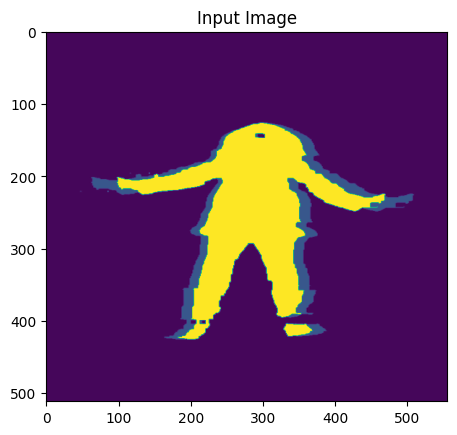

Model Building


<ipython-input-17-575fed0abfa5>:83: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-17-575fed0abfa5>:84: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


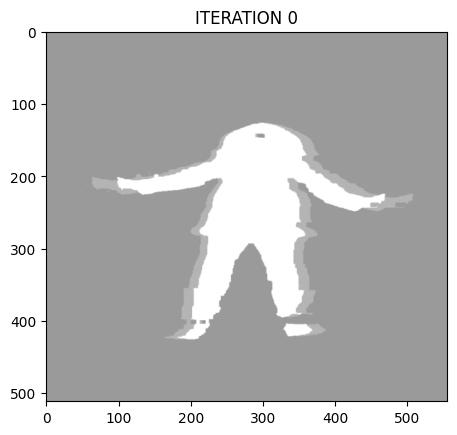

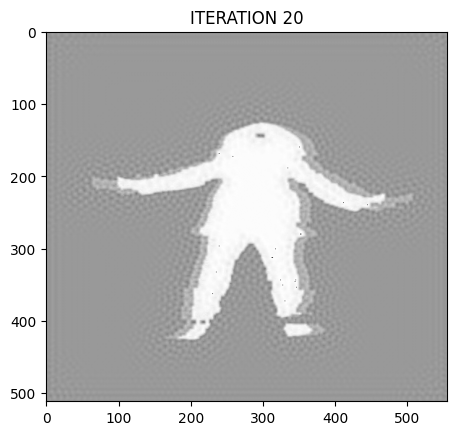

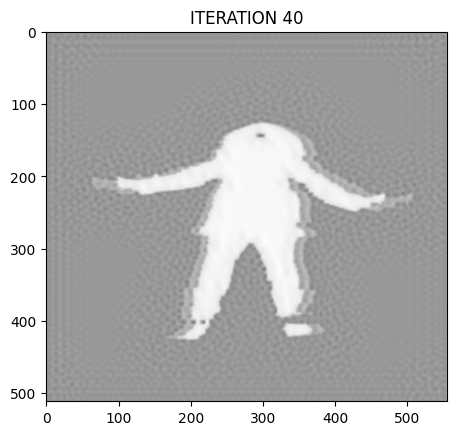

Style Loss: 9.3358 Content Loss: 3.5145



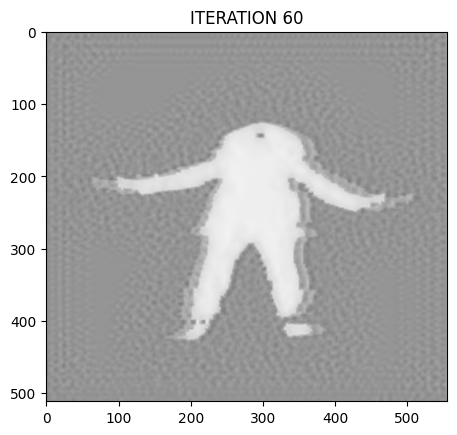

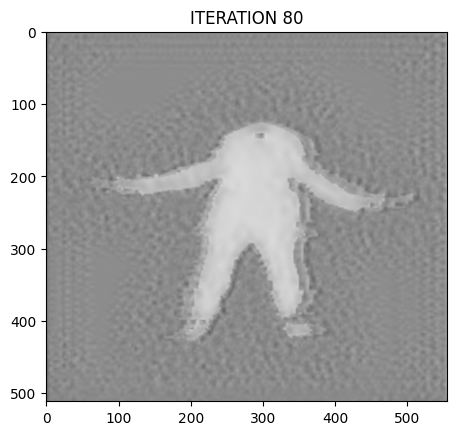

Style Loss: 1.7491 Content Loss: 4.2076



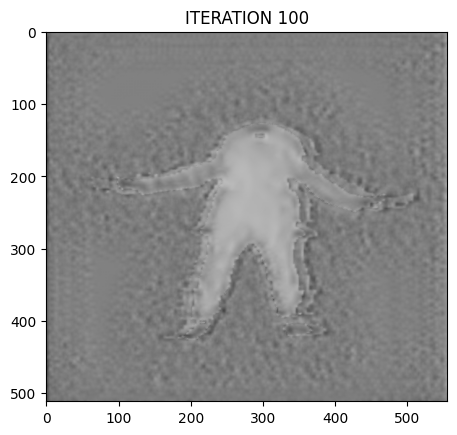

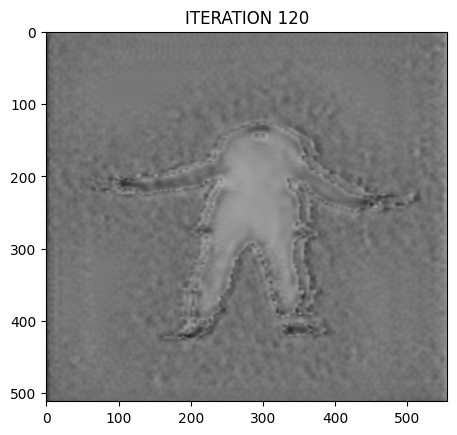

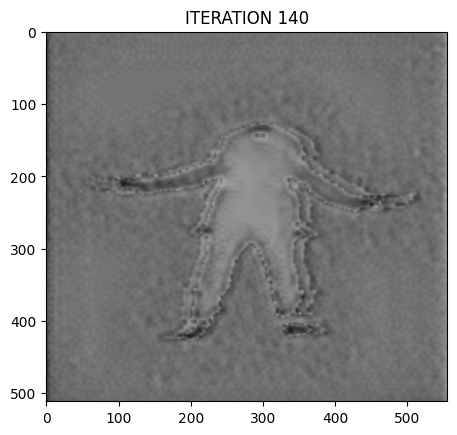

Style Loss: 0.4153 Content Loss: 3.7006



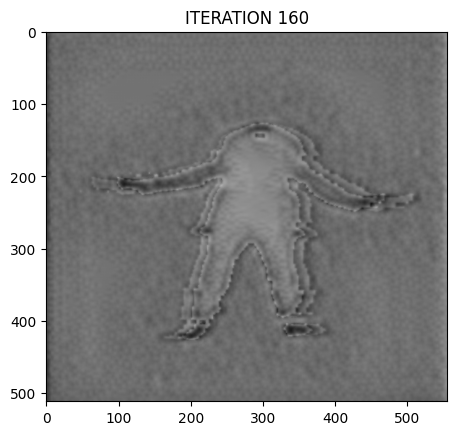

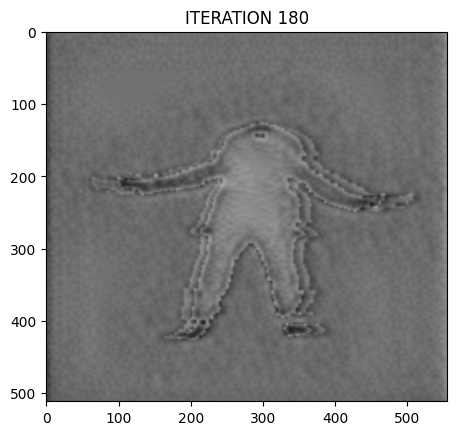

Style Loss: 0.3429 Content Loss: 3.3799



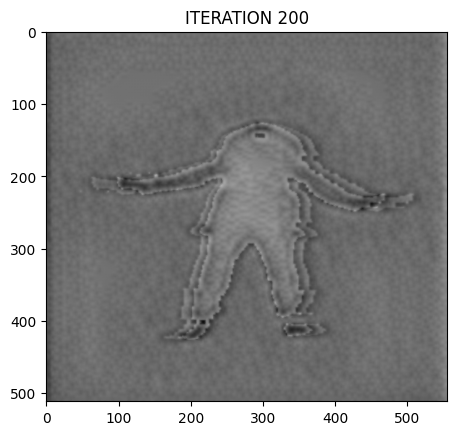

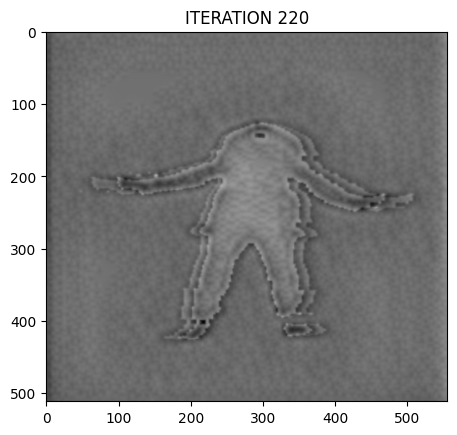

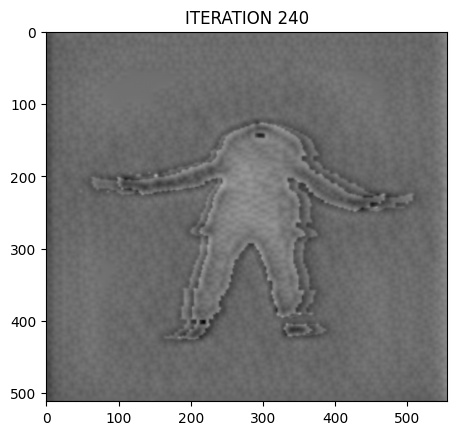

Style Loss: 0.3260 Content Loss: 3.2158



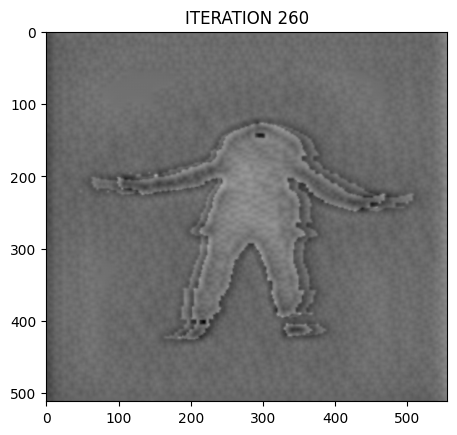

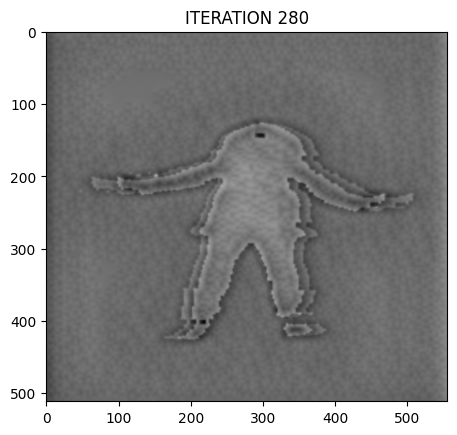

Style Loss: 0.3192 Content Loss: 3.1479



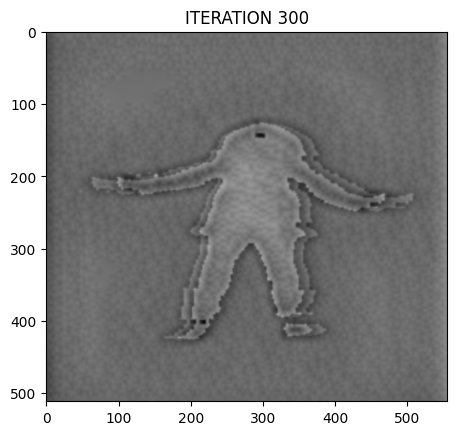

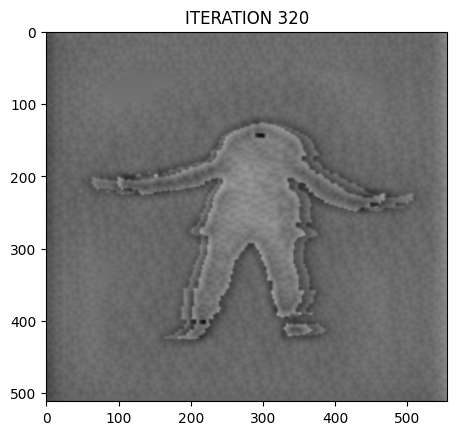

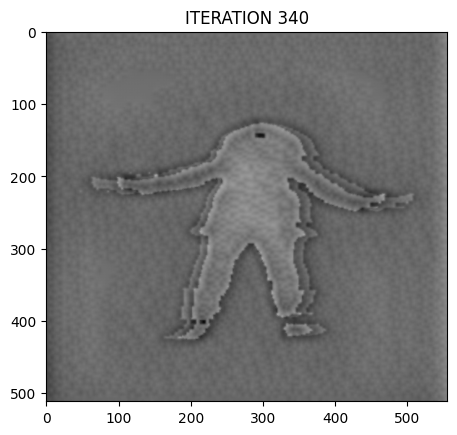

Style Loss: 0.3162 Content Loss: 3.1202



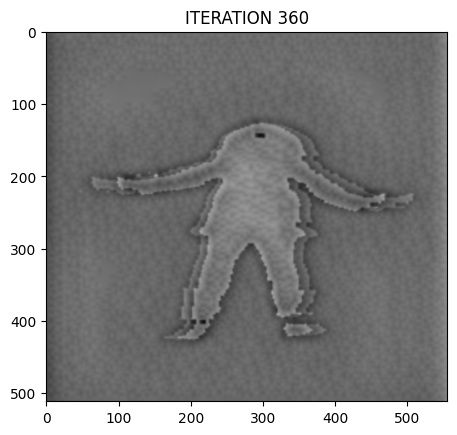

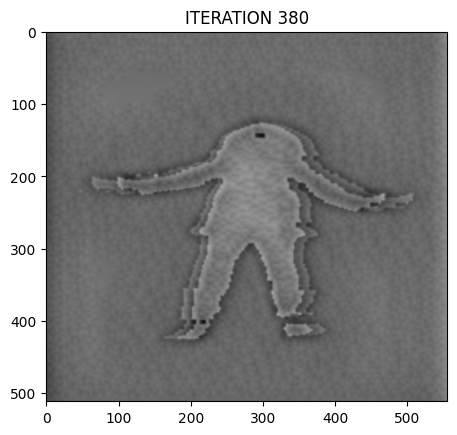

Style Loss: 0.3153 Content Loss: 3.1060



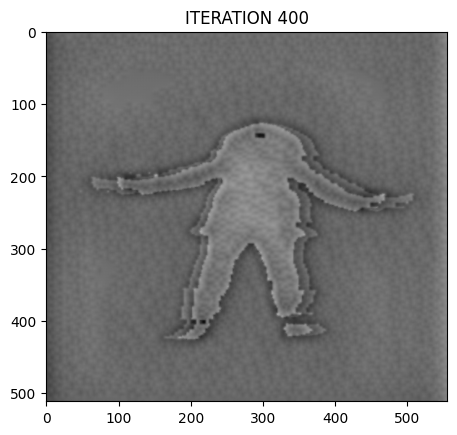

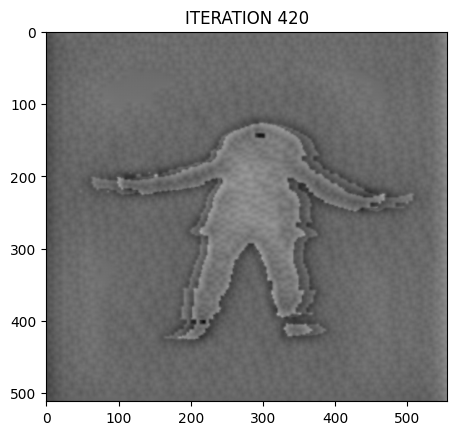

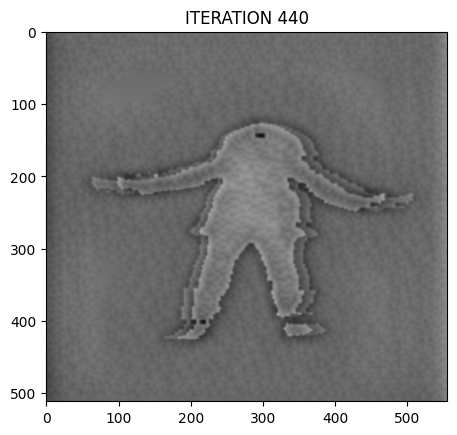

Style Loss: 0.3150 Content Loss: 3.0971



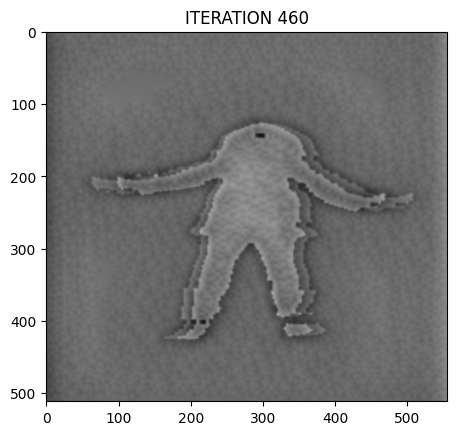

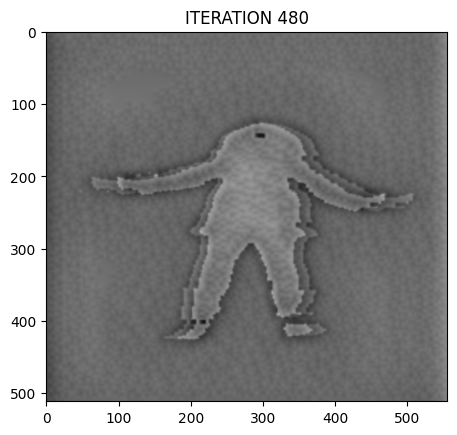

Style Loss: 0.3148 Content Loss: 3.0912



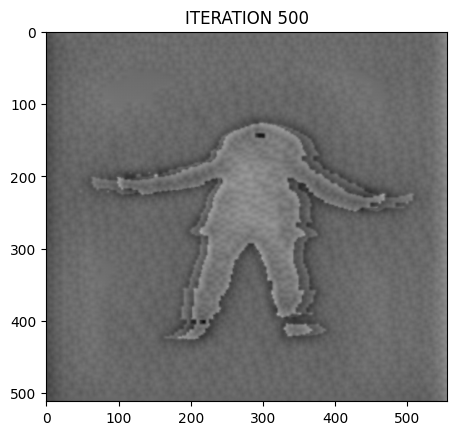

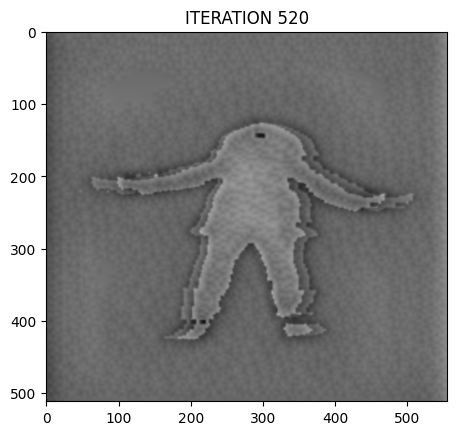

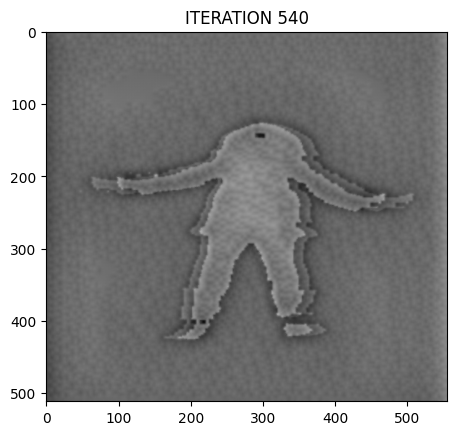

Style Loss: 0.3148 Content Loss: 3.0861



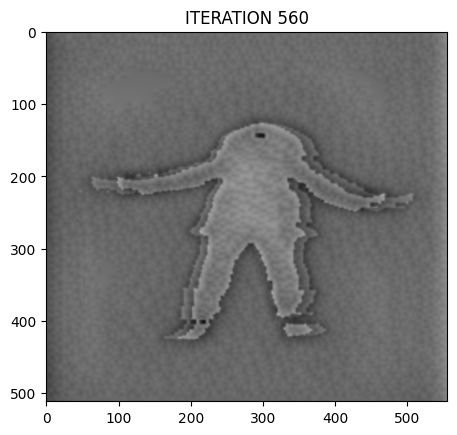

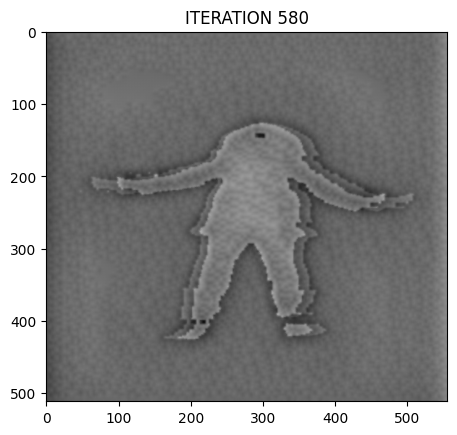

Style Loss: 0.3145 Content Loss: 3.0824



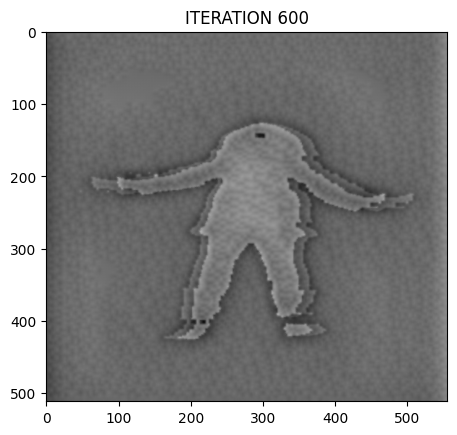

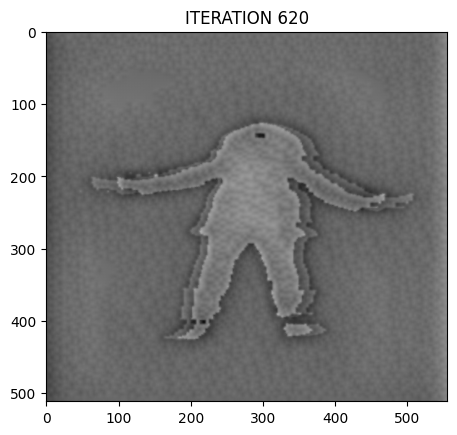

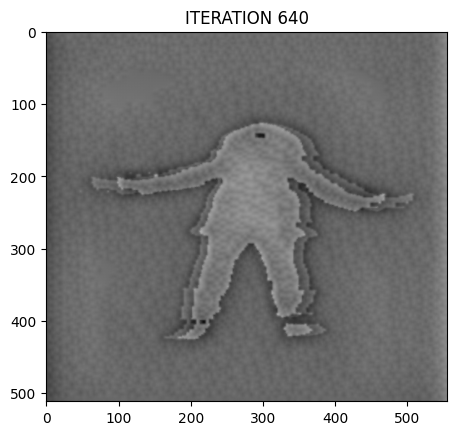

Style Loss: 0.3144 Content Loss: 3.0793



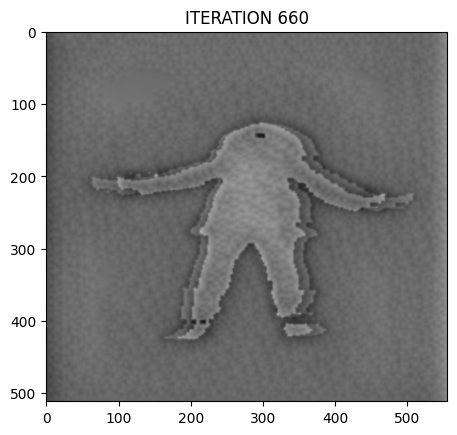

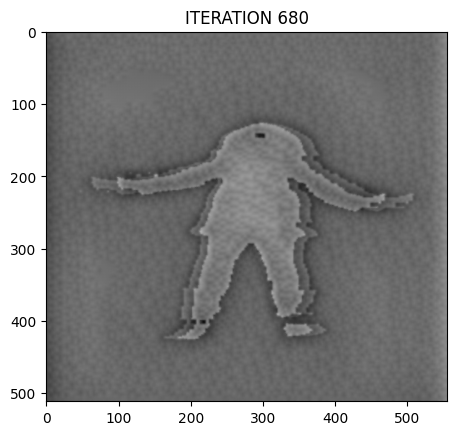

Style Loss: 0.3143 Content Loss: 3.0767



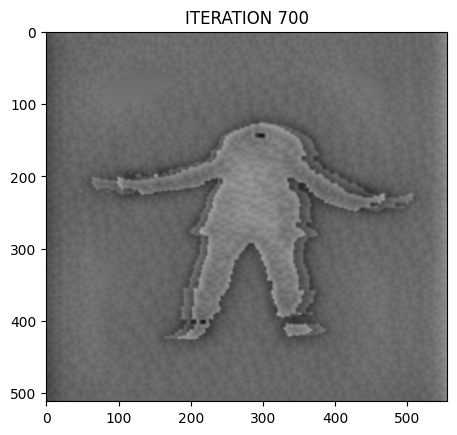

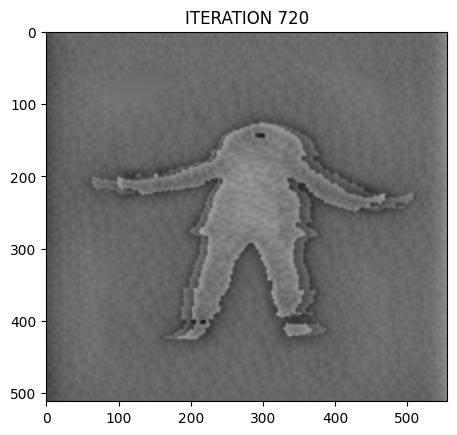

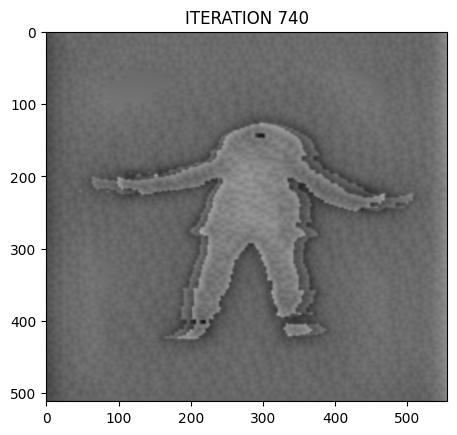

Style Loss: 0.3143 Content Loss: 3.0744



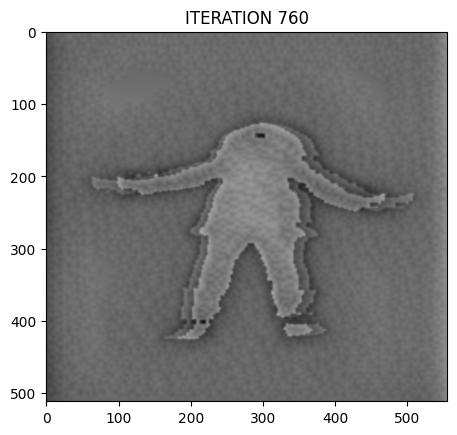

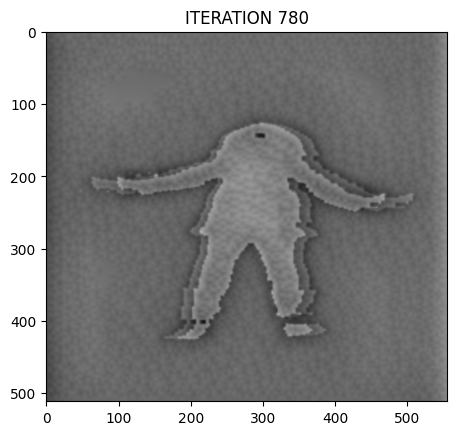

Style Loss: 0.3143 Content Loss: 3.0723



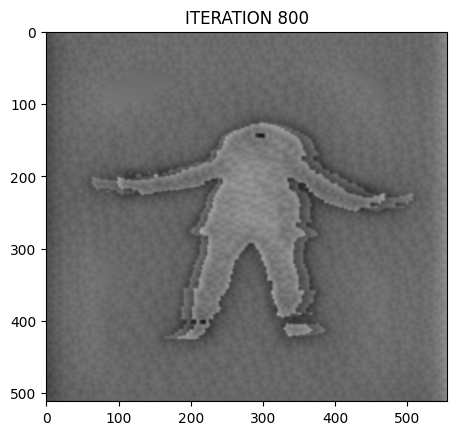

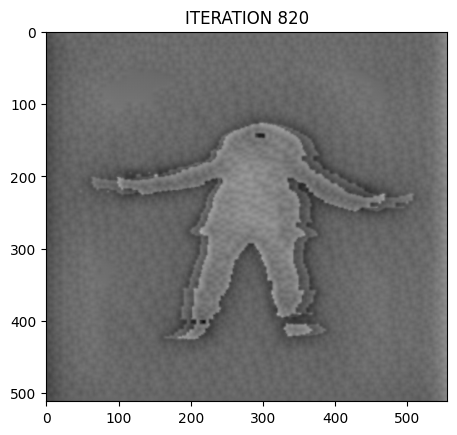

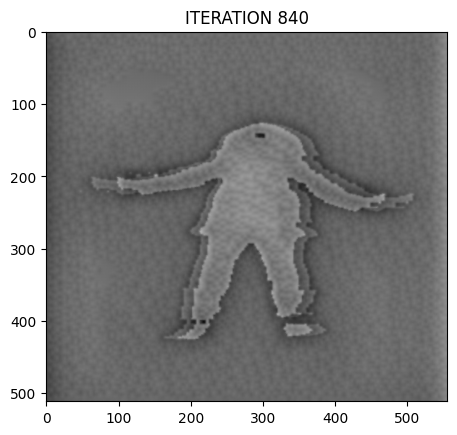

Style Loss: 0.3142 Content Loss: 3.0705



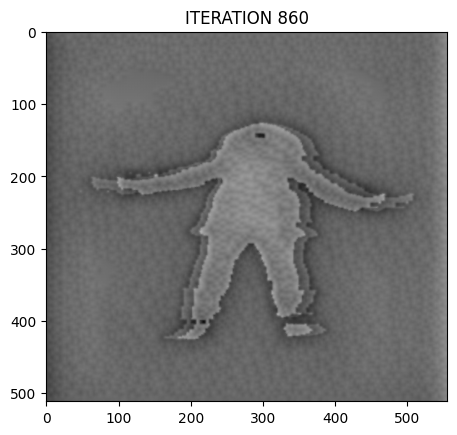

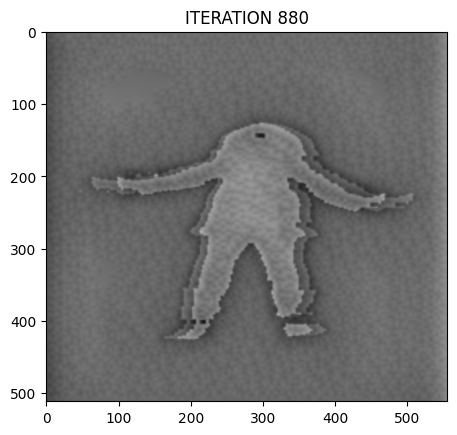

Style Loss: 0.3140 Content Loss: 3.0690



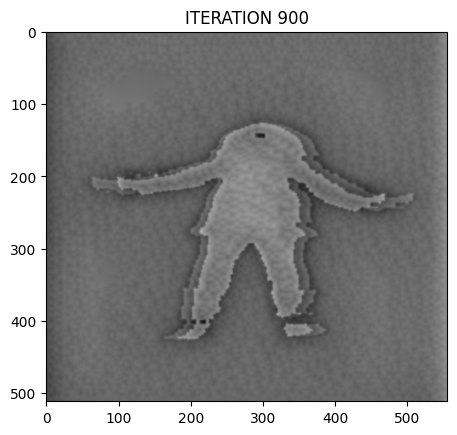

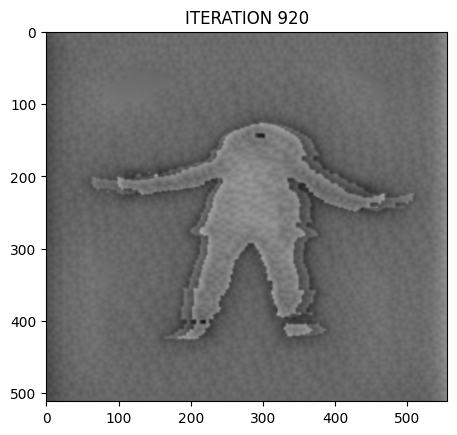

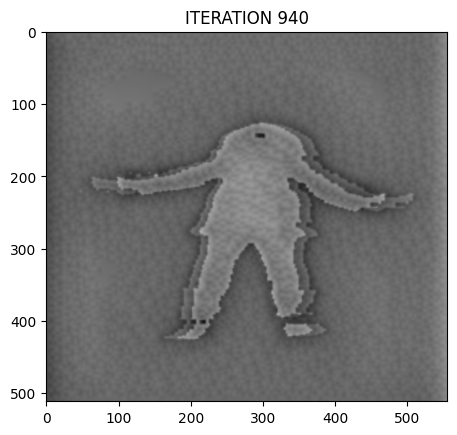

Style Loss: 0.3137 Content Loss: 3.0678



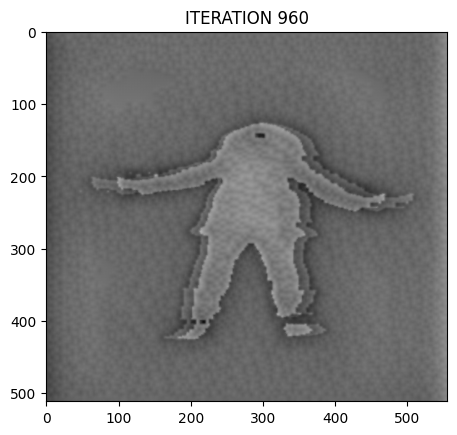

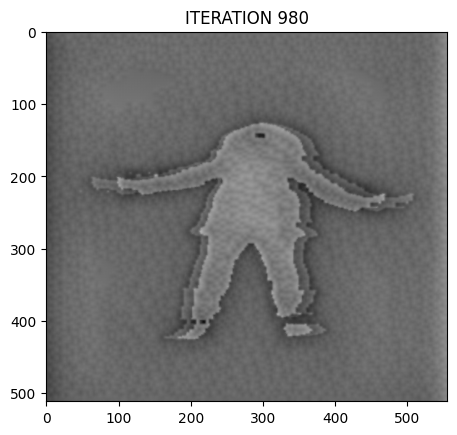

Style Loss: 0.3135 Content Loss: 3.0667



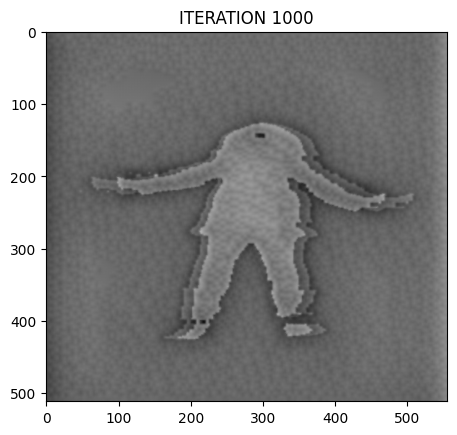

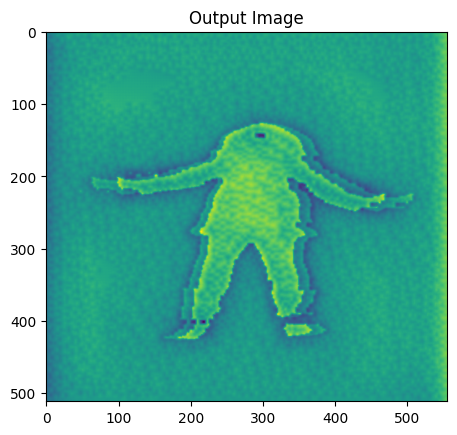

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
import torchvision.models as models

import copy


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#Experimental variables
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

# Define the Hybrid Dilated Convolution layer
class HybridDilatedConv(nn.Module):
    def __init__(self, in_channels, out_channels, dilation):
        super(HybridDilatedConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=dilation, dilation=dilation)

    def forward(self, x):
        return self.conv(x)

def image_loader(image_name, content_imsize, style_imsize):
    # Load content image
    content_loader = transforms.Compose([transforms.Resize(content_imsize), transforms.ToTensor()])
    content_image = Image.open(image_name['content'])
    content_image = content_loader(content_image).unsqueeze(0).to(device, torch.float)

    # Load style image and resize it to match the content image's size
    style_loader = transforms.Compose([transforms.Resize(content_imsize), transforms.ToTensor()])
    style_image = Image.open(image_name['style'])
    style_image = style_loader(style_image).unsqueeze(0).to(device, torch.float)

    return content_image, style_image
def imshow(tensor,title):

    unloader = transforms.ToPILImage()
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = unloader(image)
    plt.imshow(image)
    plt.title(title)
    plt.pause(0.001)

def gram_matrix(input):
    batch_size, no_feature_maps, d1, d2 = input.size()
    # (d1,d2)=dimensions of a f. map (N=d1*d2)
    features = input.view(batch_size*no_feature_maps, d1*d2)  # resise F_XL into \hat F_XL
    # computing the gram product
    G = torch.mm(features, features.t())
    #normalizing
    return G.div(batch_size*no_feature_maps*d1*d2)



class ContentLoss(nn.Module):
    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()
    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()
    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        return (img - self.mean) / self.std



# This type of optimizer was prefered by the author of the paper
def get_input_optimizer(input_img):
    # this line to show that input is a parameter that requires a gradient
    optimizer = optim.LBFGS([input_img.requires_grad_()])
    return optimizer

def get_style_model_and_losses(cnn, normalization_mean, normalization_std,style_img, content_img,content_layers=content_layers_default,style_layers=style_layers_default):
    cnn = copy.deepcopy(cnn)

    # normalization
    normalization = Normalization(normalization_mean, normalization_std).to(device)

    content_losses = []
    style_losses = []

    # make a new nn.Sequential to put in modules that are supposed to be activated sequentially
    model = nn.Sequential(normalization)

    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_%d' % i

            if i == 4:  # Replace the 4th convolution with HDC
                hdc_layer = HybridDilatedConv(layer.in_channels, layer.out_channels, dilation=2)
                model.add_module(name, hdc_layer)
            else:
                model.add_module(name, layer)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_%d'%i
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_%d'%i
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_%d'%i
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_%d"%i, content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_%d"%i, style_loss)
            style_losses.append(style_loss)

    #pretty much that ok so this last part we're gonna just trim off the last layers because we
    # don't care about them it's fully connected feed-forward layers that are used for the output
    # we're not trying to do object recognition here we're trying to do generating an image so we can remove them it doesn't there that they don't
    for i in range(len(model)-1,-1,-1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses


# This will run the neural style transfer
# It will create image that goes above 1 or below 0, however it will be normalized
def run_style_transfer(model, style_losses, content_losses, input_img, num_steps=300, style_weight=1000000, content_weight=1):
    optimizer = get_input_optimizer(input_img)
    run = [0]

    while run[0] <= num_steps:
        def closure():
            # Correct the values of the updated input image
            input_img.data.clamp_(0, 1)
            optimizer.zero_grad()
            model(input_img)

            style_score = 0
            content_score = 0

            for style_layer in style_losses:
                style_score += (1/5) * style_layer.loss
            for content_layer in content_losses:
                content_score += content_layer.loss

            style_score *= style_weight
            content_score *= content_weight

            loss = style_score + content_score
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print('Style Loss: {:.4f} Content Loss: {:.4f}\n'.format(style_score.item(), content_score.item()))

            return style_score + content_score

        imshow(input_img.expand(-1, 3, -1, -1), "ITERATION %d" % run[0])

        optimizer.step(closure)
    # A last correction to have the tensors between 0 and 1
    input_img.data.clamp_(0, 1)

    return input_img


imsize = 512 if torch.cuda.is_available() else 128


imsize_content = (512, 556)
imsize_style = (512, 556)

image_names = {
    'content': "content.jpeg",
    'style': "style.jpeg"
}

content_img, style_img = image_loader(image_names, imsize_content, imsize_style)

#content_img, style_img= content_img.expand(-1, 3, -1, -1),style_img.expand(-1, 3, -1, -1)

#assert style_img.size() == content_img.size()

plt.ion()

plt.figure()
imshow(style_img, title='Style Image')

plt.figure()
imshow(content_img, title='Content Image')


# Importing the VGG 19 model
cnn = models.vgg19(pretrained=True).features.to(device).eval()

#The image the starting image weare modifying and outputting remember
input_img = content_img.clone()

#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')



# VGG network are normalized with special values for the mean and std
#These values are from the data they are trained on
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

no_steps=3000


print('Model Building')
model, style_losses, content_losses = get_style_model_and_losses(cnn,cnn_normalization_mean, cnn_normalization_std, style_img, content_img, content_layers_default, style_layers_default)

output = run_style_transfer(model, style_losses, content_losses, input_img,num_steps=1000)

plt.figure()
imshow(output, title='Output Image')


plt.ioff()
plt.show()



In [ ]:


output_image = output.clone().cpu()
output_image = output_image.squeeze(0)
output_image = transforms.ToPILImage()(output_image)
output_image.save("output_image.jpg")

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
import torchvision.models as models

import copy


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#Experimental variables
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

# Define the Hybrid Dilated Convolution layer
class HybridDilatedConv(nn.Module):
    def __init__(self, in_channels, out_channels, dilation):
        super(HybridDilatedConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=dilation, dilation=dilation)

    def forward(self, x):
        return self.conv(x)

def image_loader(image_name, content_imsize, style_imsize):
    # Load content image
    content_loader = transforms.Compose([transforms.Resize(content_imsize), transforms.ToTensor()])
    content_image = Image.open(image_name['content'])
    content_image = content_loader(content_image).unsqueeze(0).to(device, torch.float)

    # Load style image and resize it to match the content image's size
    style_loader = transforms.Compose([transforms.Resize(content_imsize), transforms.ToTensor()])
    style_image = Image.open(image_name['style'])
    style_image = style_loader(style_image).unsqueeze(0).to(device, torch.float)

    return content_image, style_image
def imshow(tensor,title):

    unloader = transforms.ToPILImage()
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = unloader(image)
    plt.imshow(image)
    plt.title(title)
    plt.pause(0.001)

def gram_matrix(input):
    batch_size, no_feature_maps, d1, d2 = input.size()
    # (d1,d2)=dimensions of a f. map (N=d1*d2)
    features = input.view(batch_size*no_feature_maps, d1*d2)  # resise F_XL into \hat F_XL
    # computing the gram product
    G = torch.mm(features, features.t())
    #normalizing
    return G.div(batch_size*no_feature_maps*d1*d2)



class ContentLoss(nn.Module):
    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()
    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()
    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        return (img - self.mean) / self.std



# This type of optimizer was prefered by the author of the paper
def get_input_optimizer(input_img):
    # this line to show that input is a parameter that requires a gradient
    optimizer = optim.LBFGS([input_img.requires_grad_()])
    return optimizer

def get_style_model_and_losses(cnn, normalization_mean, normalization_std,style_img, content_img,content_layers=content_layers_default,style_layers=style_layers_default):
    cnn = copy.deepcopy(cnn)

    # normalization
    normalization = Normalization(normalization_mean, normalization_std).to(device)

    content_losses = []
    style_losses = []

    # make a new nn.Sequential to put in modules that are supposed to be activated sequentially
    model = nn.Sequential(normalization)

    i = 0
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_%d' % i

            if i == 4:  # Replace the 4th convolution with HDC
                hdc_layer = HybridDilatedConv(layer.in_channels, layer.out_channels, dilation=2)
                model.add_module(name, hdc_layer)
            else:
                model.add_module(name, layer)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_%d'%i
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_%d'%i
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_%d'%i
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers:
            # add content loss:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_%d"%i, content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # add style loss:
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_%d"%i, style_loss)
            style_losses.append(style_loss)

    #pretty much that ok so this last part we're gonna just trim off the last layers because we
    # don't care about them it's fully connected feed-forward layers that are used for the output
    # we're not trying to do object recognition here we're trying to do generating an image so we can remove them it doesn't there that they don't
    for i in range(len(model)-1,-1,-1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses


# This will run the neural style transfer
# It will create image that goes above 1 or below 0, however it will be normalized
def run_style_transfer(model, style_losses, content_losses, input_img, num_steps=300, style_weight=1000000, content_weight=1):
    optimizer = get_input_optimizer(input_img)
    run = [0]

    while run[0] <= num_steps:
        def closure():
            # Correct the values of the updated input image
            input_img.data.clamp_(0, 1)
            optimizer.zero_grad()
            model(input_img)

            style_score = 0
            content_score = 0

            for style_layer in style_losses:
                style_score += (1/5) * style_layer.loss
            for content_layer in content_losses:
                content_score += content_layer.loss

            style_score *= style_weight
            content_score *= content_weight

            loss = style_score + content_score
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print('Style Loss: {:.4f} Content Loss: {:.4f}\n'.format(style_score.item(), content_score.item()))

            return style_score + content_score

        imshow(input_img.expand(-1, 3, -1, -1), "ITERATION %d" % run[0])

        optimizer.step(closure)
    # A last correction to have the tensors between 0 and 1
    input_img.data.clamp_(0, 1)

    return input_img


imsize = 512 if torch.cuda.is_available() else 128


imsize_content = (512, 556)
imsize_style = (512, 556)





In [ ]:
def NST(n):
  image_names = {
      'content': "download (%d).png"%n,
      'style': "style.jpeg"
  }

  content_img, style_img = image_loader(image_names, imsize_content, imsize_style)

  #content_img, style_img= content_img.expand(-1, 3, -1, -1),style_img.expand(-1, 3, -1, -1)

  #assert style_img.size() == content_img.size()

  plt.ion()

  plt.figure()
  imshow(style_img, title='Style Image')

  plt.figure()
  imshow(content_img, title='Content Image')


  # Importing the VGG 19 model
  cnn = models.vgg19(pretrained=True).features.to(device).eval()

  #The image the starting image weare modifying and outputting remember
  input_img = content_img.clone()

  #input_img = torch.randn(content_img.data.size(), device=device)

  # add the original input image to the figure:
  plt.figure()
  imshow(input_img, title='Input Image')



  # VGG network are normalized with special values for the mean and std
  #These values are from the data they are trained on
  cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
  cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

  no_steps=3000


  print('Model Building')
  model, style_losses, content_losses = get_style_model_and_losses(cnn,cnn_normalization_mean, cnn_normalization_std, style_img, content_img, content_layers_default, style_layers_default)

  output = run_style_transfer(model, style_losses, content_losses, input_img,num_steps=1500)

  output_image = output.clone().cpu()
  output_image = output_image.squeeze(0)
  output_image = transforms.ToPILImage()(output_image)
  output_image.save("output_image%d.jpg"%n)

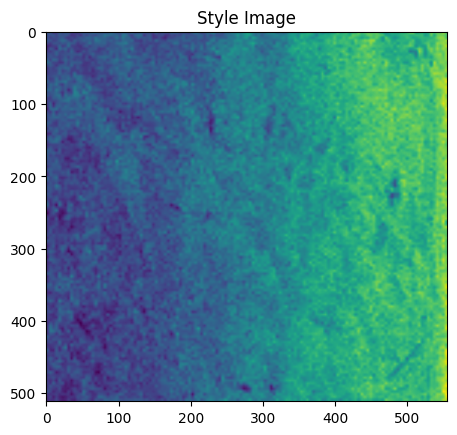

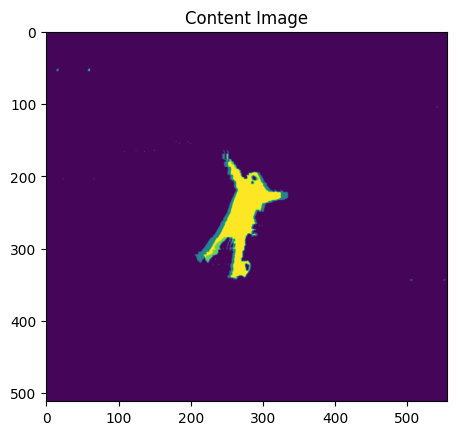

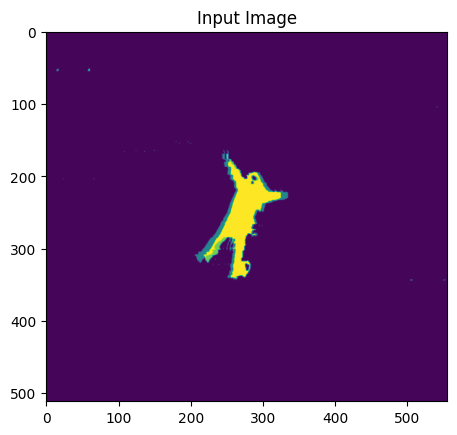

Model Building


<ipython-input-19-0a7c5306545e>:83: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.mean = torch.tensor(mean).view(-1, 1, 1)
<ipython-input-19-0a7c5306545e>:84: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.std = torch.tensor(std).view(-1, 1, 1)


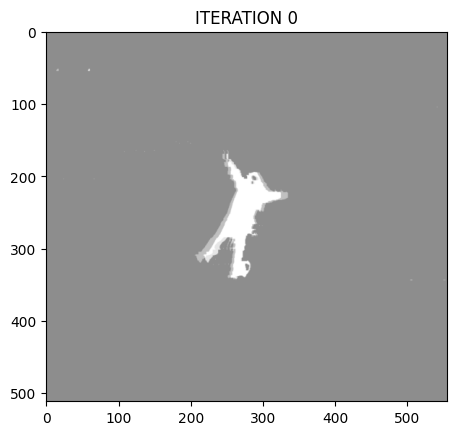

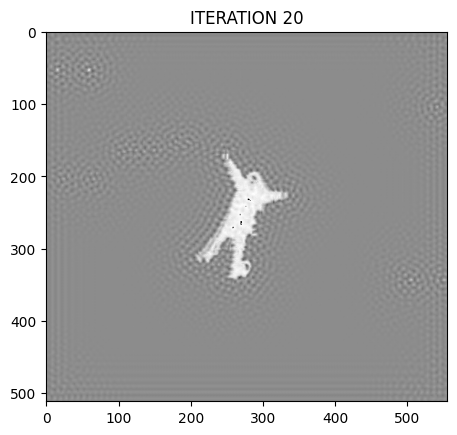

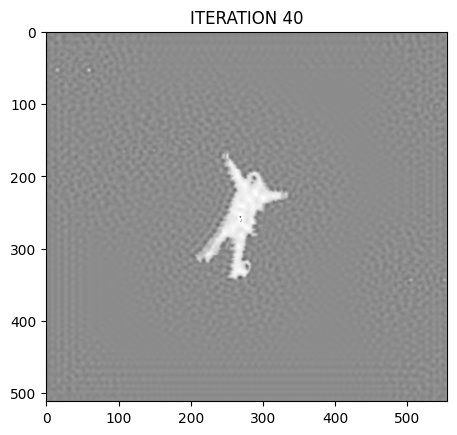

Style Loss: 3.3919 Content Loss: 3.3334



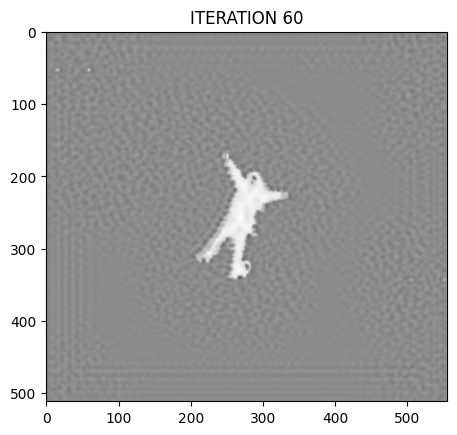

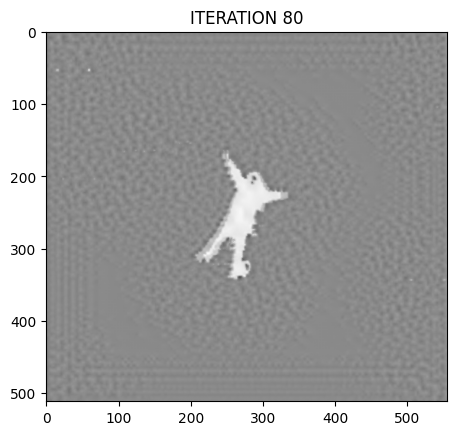

Style Loss: 2.2756 Content Loss: 3.2730



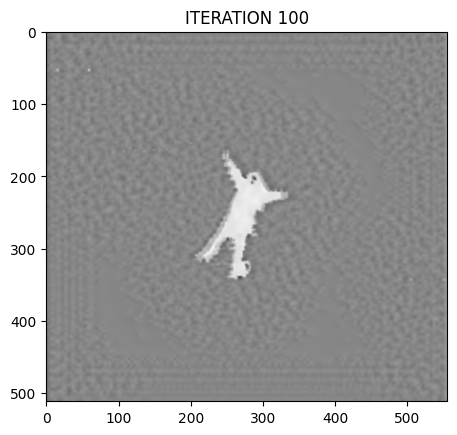

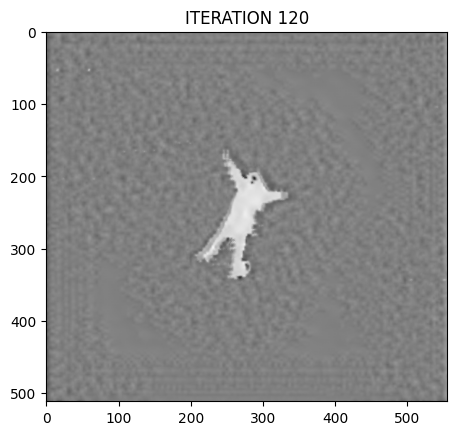

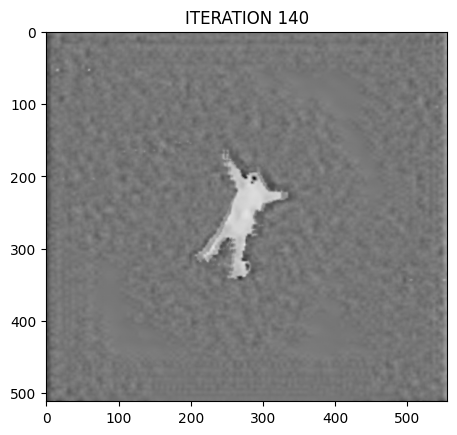

Style Loss: 0.5561 Content Loss: 3.3336



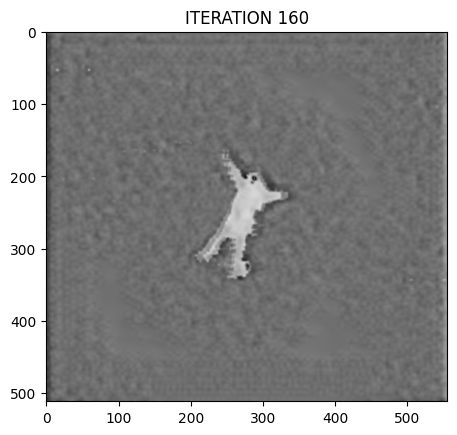

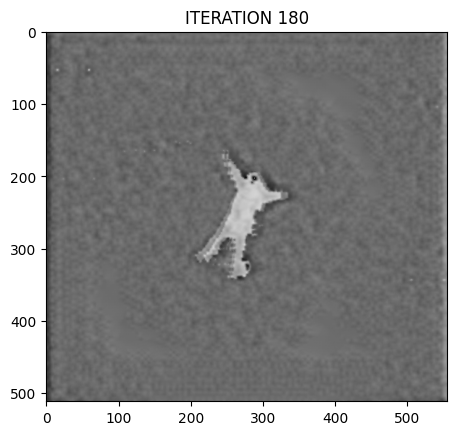

Style Loss: 0.2701 Content Loss: 3.2052



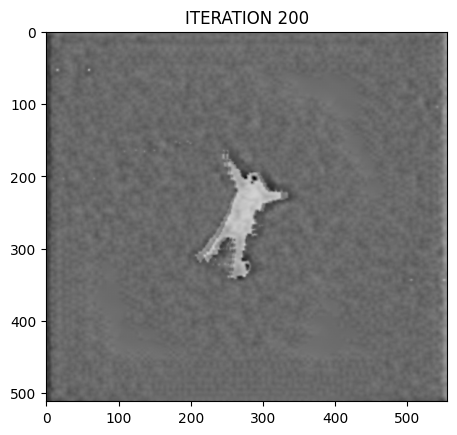

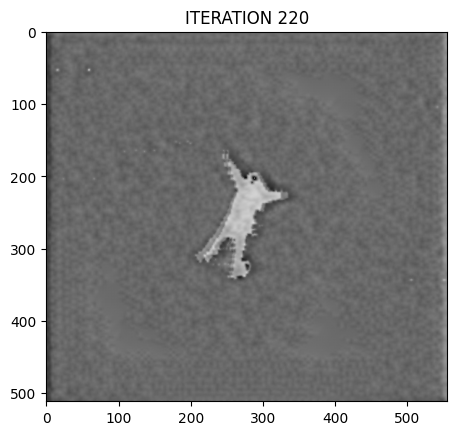

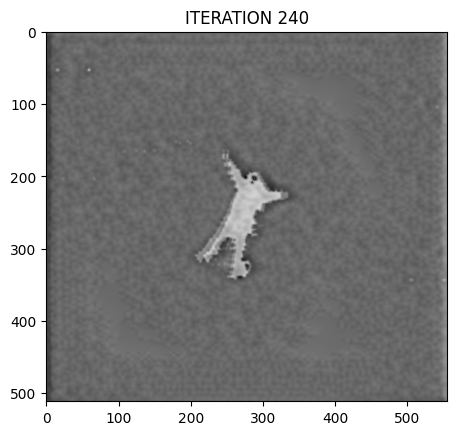

Style Loss: 0.2591 Content Loss: 3.1234



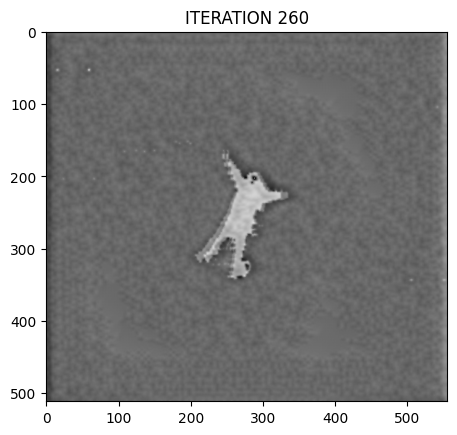

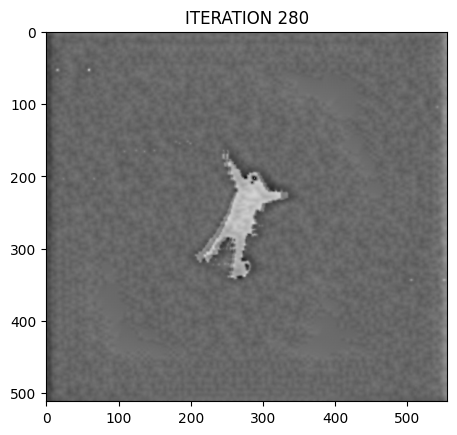

Style Loss: 0.2608 Content Loss: 3.0942



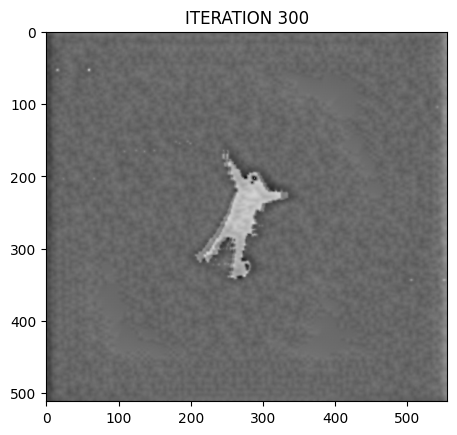

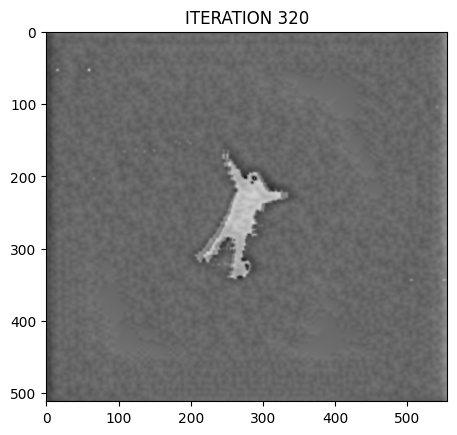

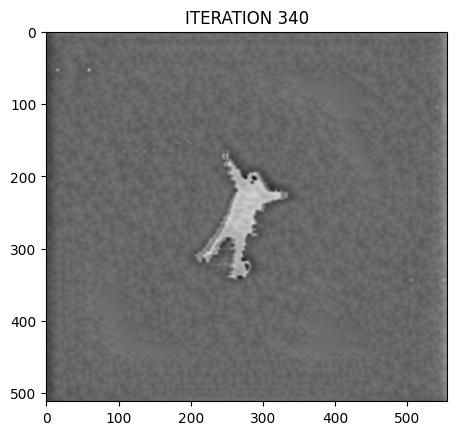

Style Loss: 0.2623 Content Loss: 3.0816



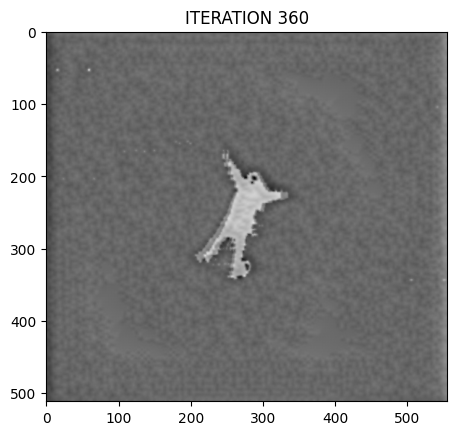

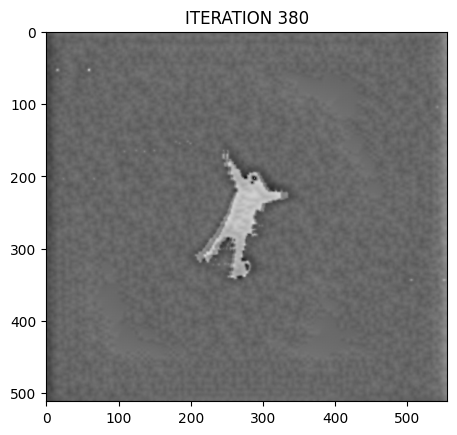

Style Loss: 0.2630 Content Loss: 3.0747



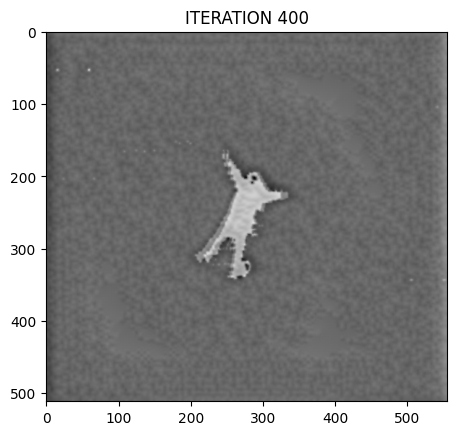

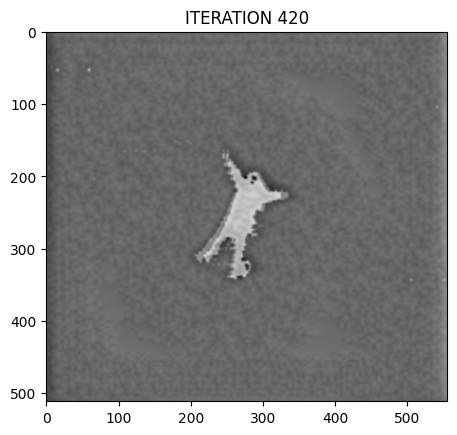

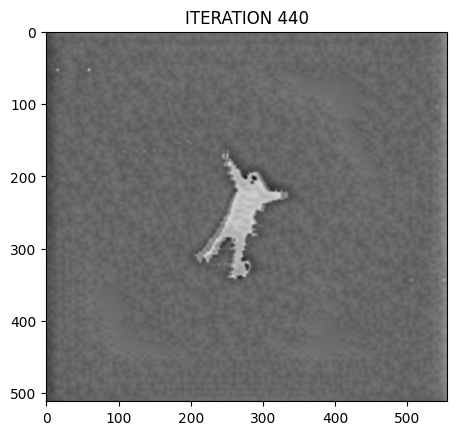

Style Loss: 0.2637 Content Loss: 3.0701



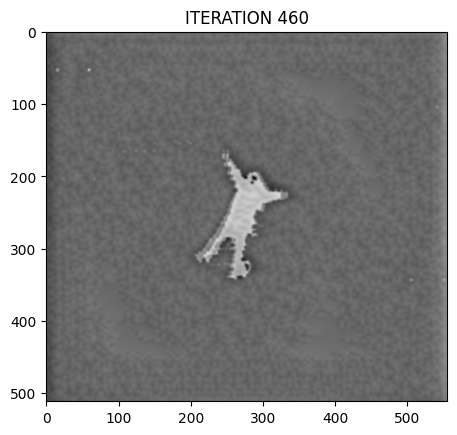

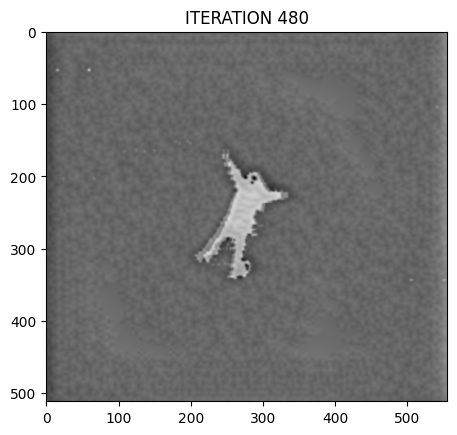

Style Loss: 0.2641 Content Loss: 3.0670



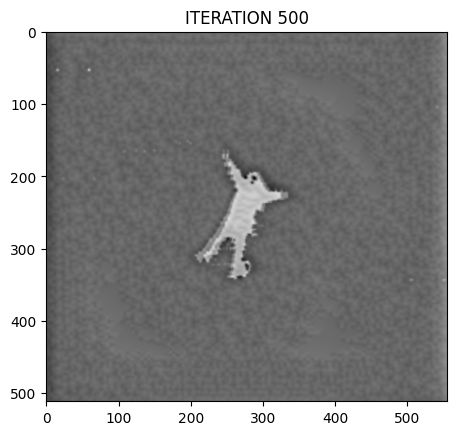

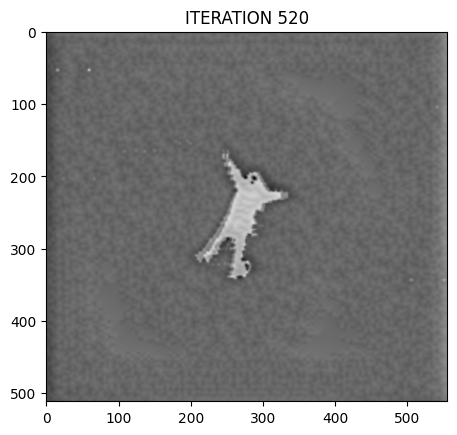

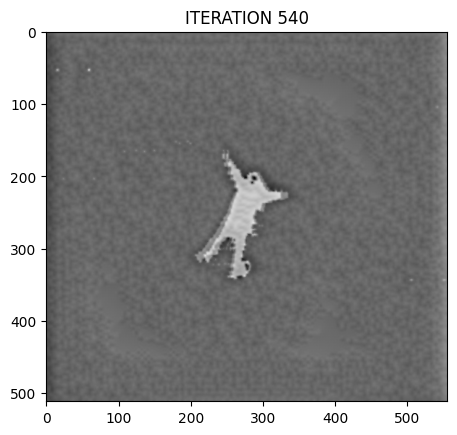

Style Loss: 0.2643 Content Loss: 3.0648



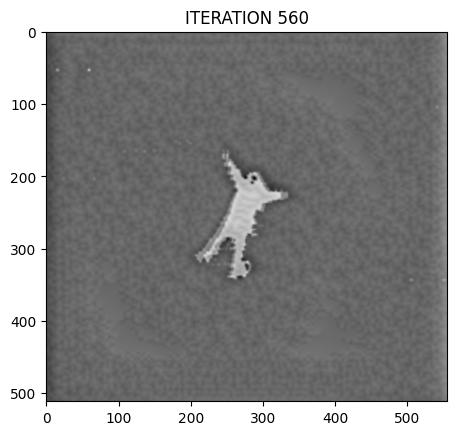

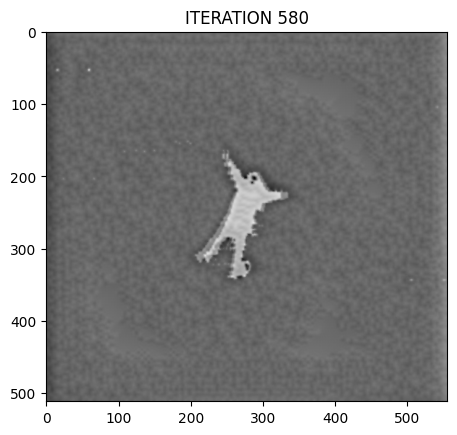

Style Loss: 0.2643 Content Loss: 3.0632



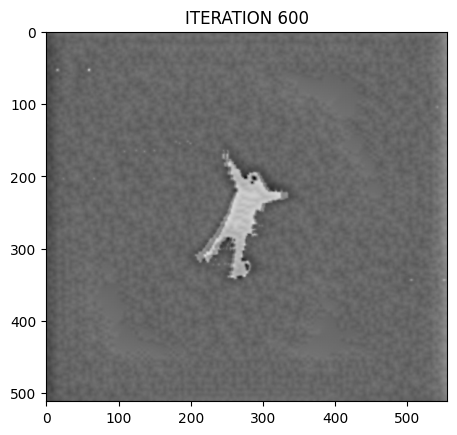

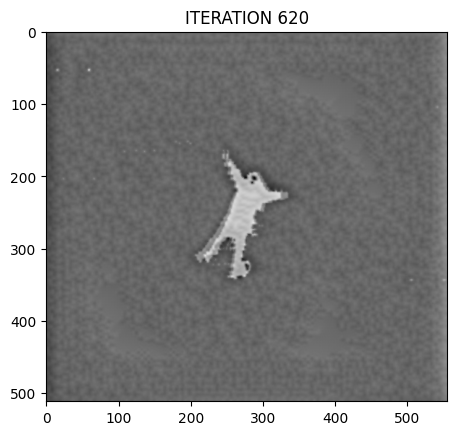

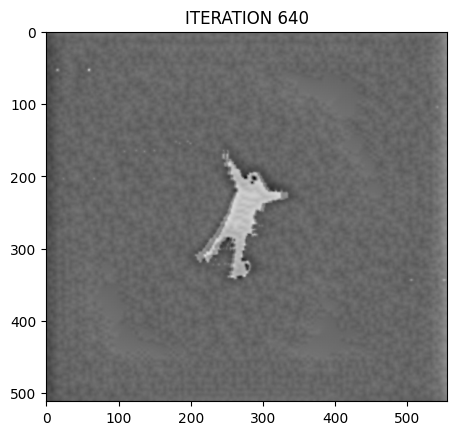

Style Loss: 0.2644 Content Loss: 3.0616



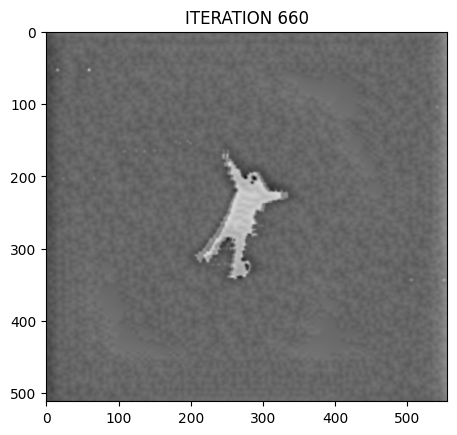

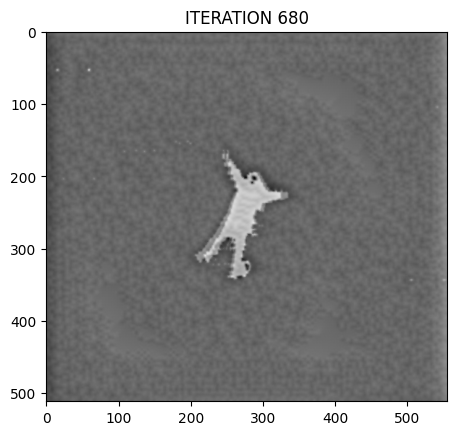

Style Loss: 0.2644 Content Loss: 3.0601



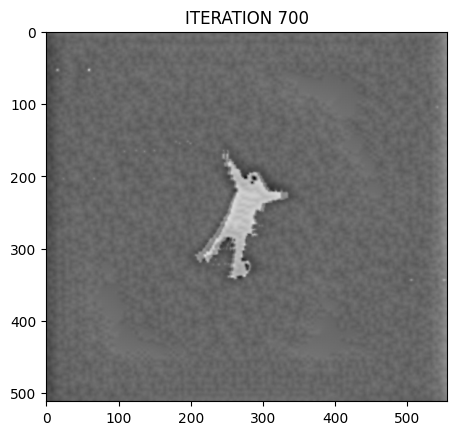

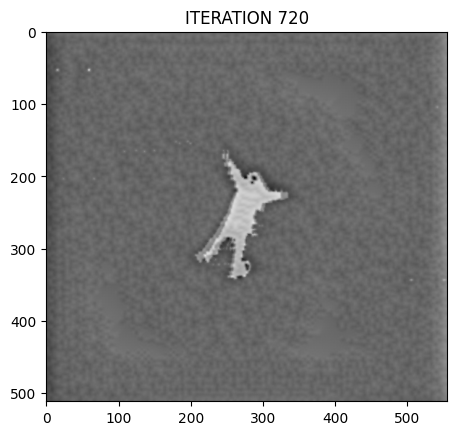

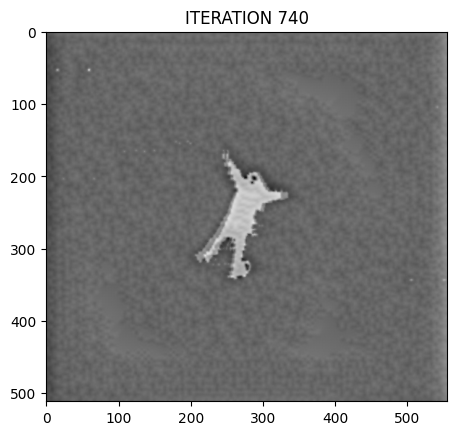

Style Loss: 0.2642 Content Loss: 3.0589



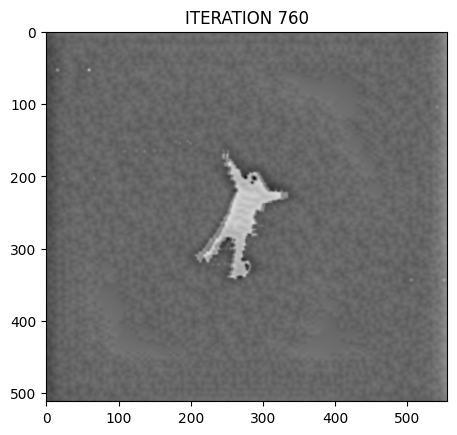

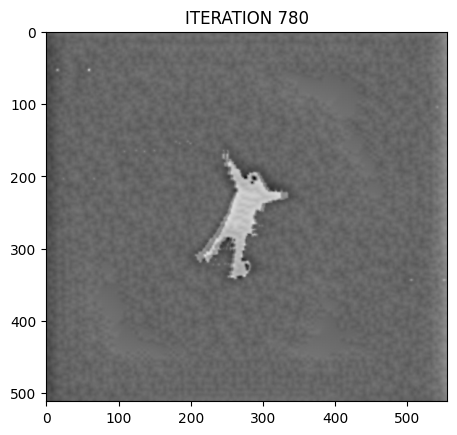

Style Loss: 0.2642 Content Loss: 3.0576



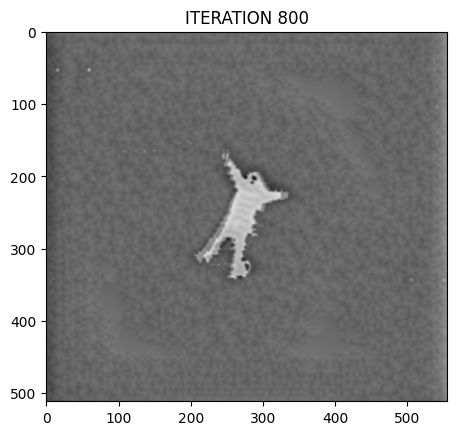

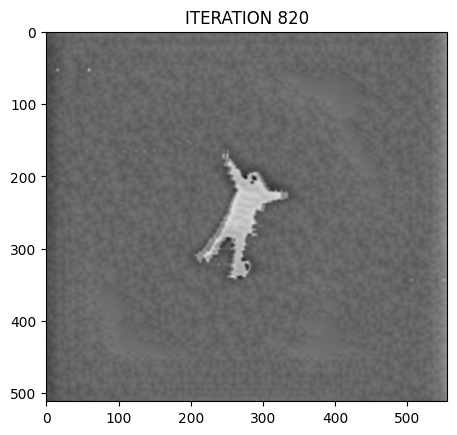

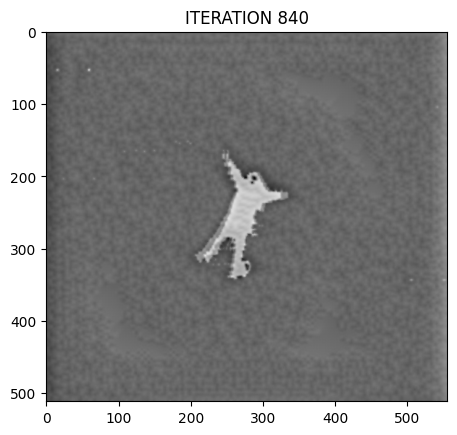

Style Loss: 0.2641 Content Loss: 3.0566



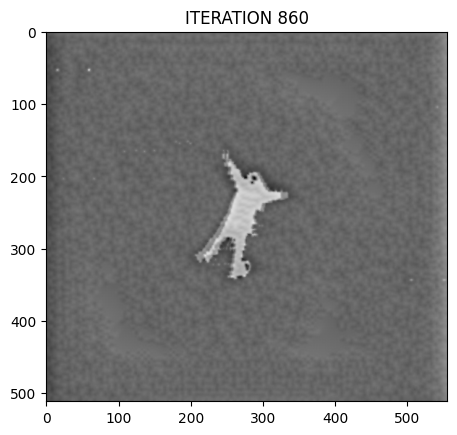

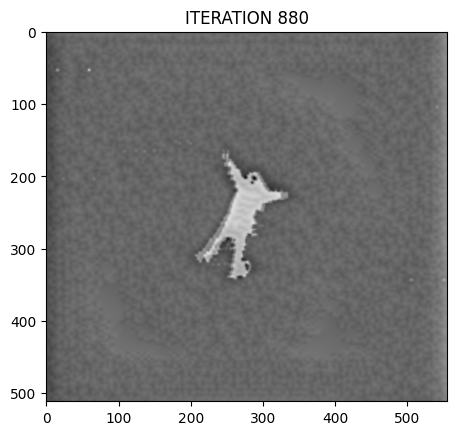

Style Loss: 0.2639 Content Loss: 3.0556



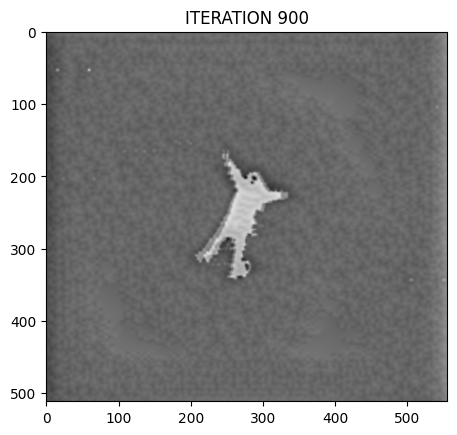

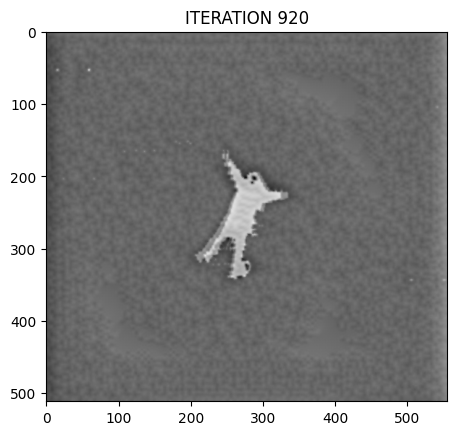

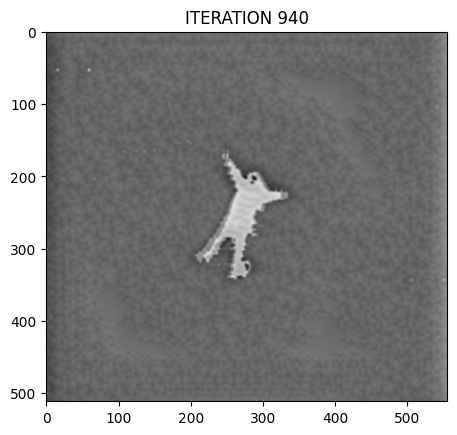

Style Loss: 0.2637 Content Loss: 3.0547



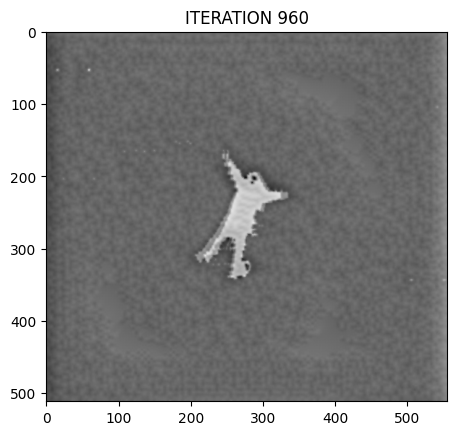

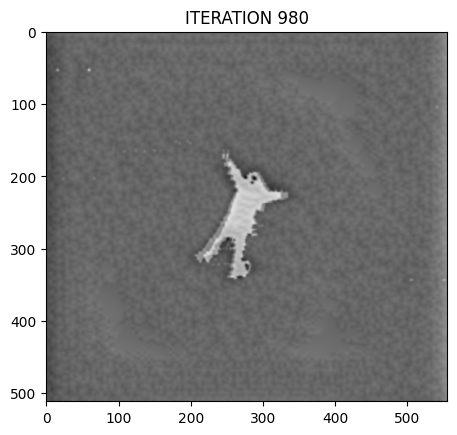

Style Loss: 0.2634 Content Loss: 3.0539



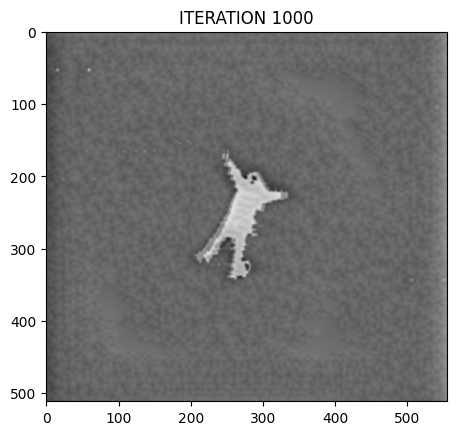

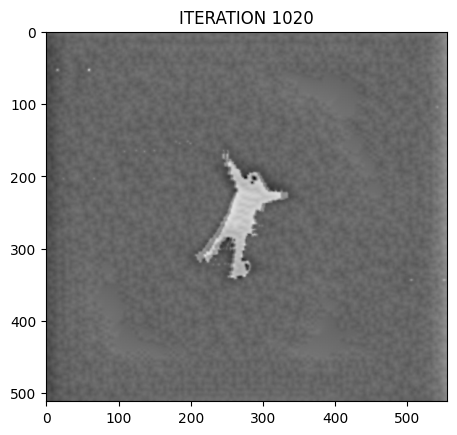

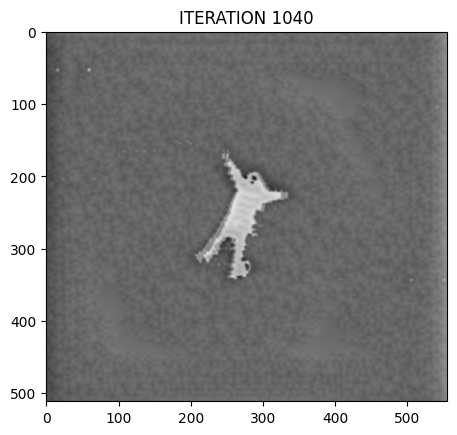

Style Loss: 0.2632 Content Loss: 3.0530



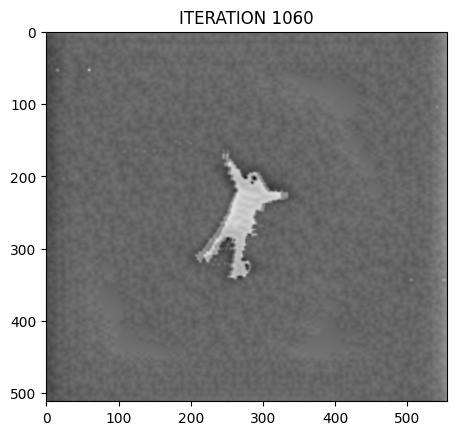

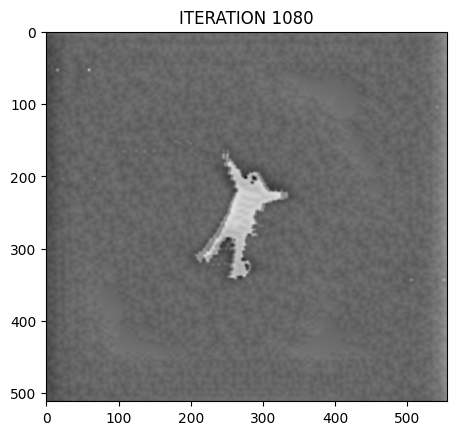

Style Loss: 0.2630 Content Loss: 3.0521



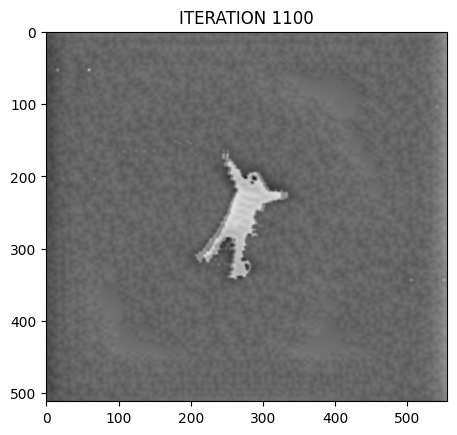

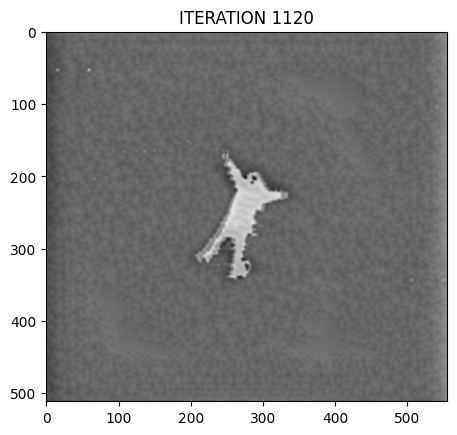

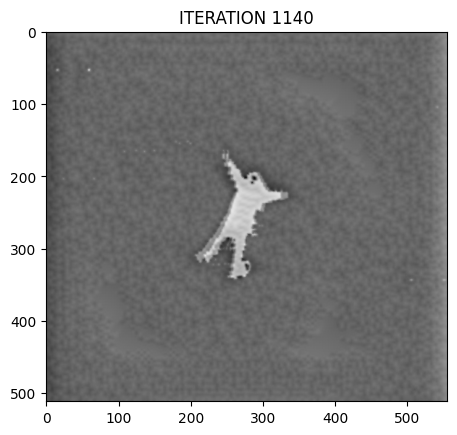

Style Loss: 0.2627 Content Loss: 3.0514



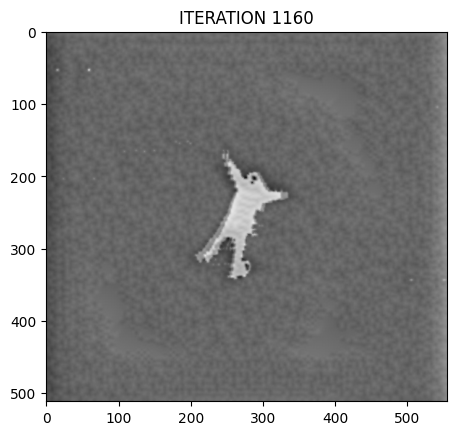

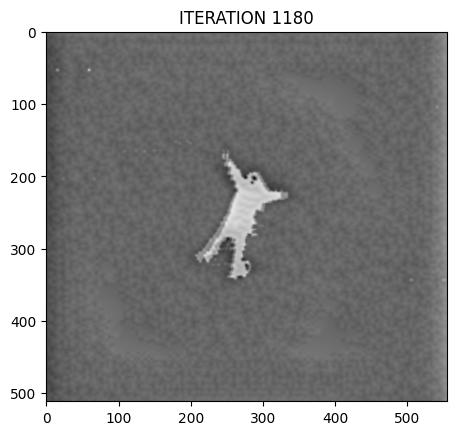

Style Loss: 0.2622 Content Loss: 3.0509



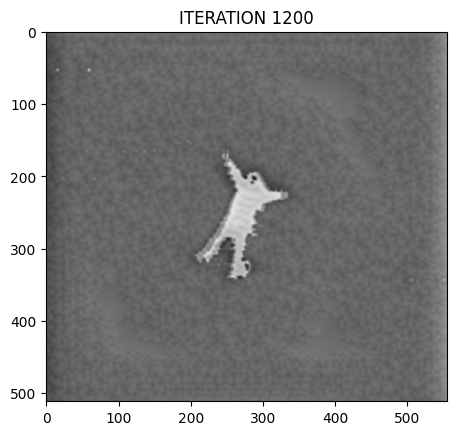

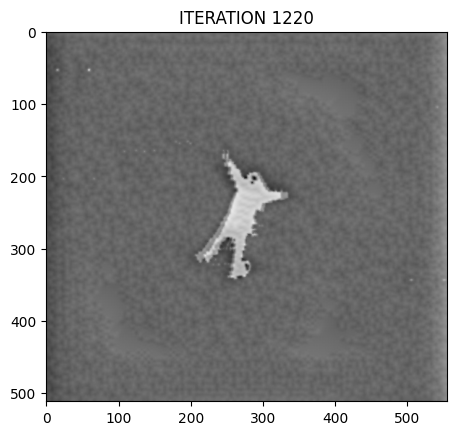

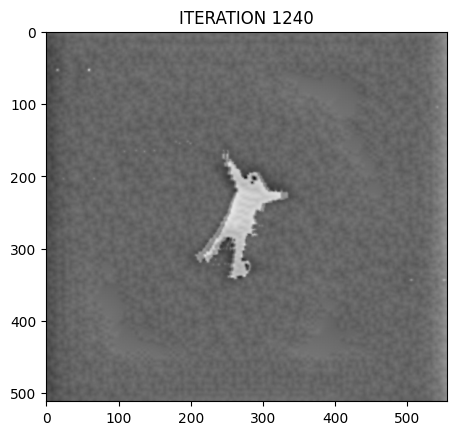

Style Loss: 0.2615 Content Loss: 3.0505



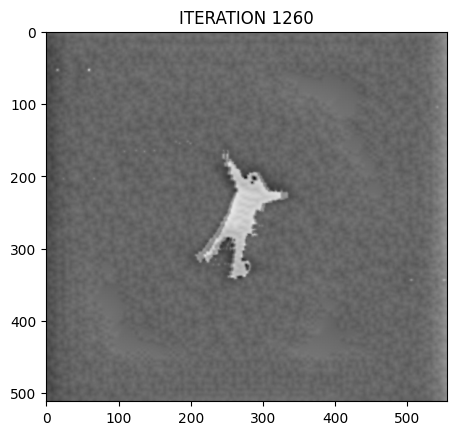

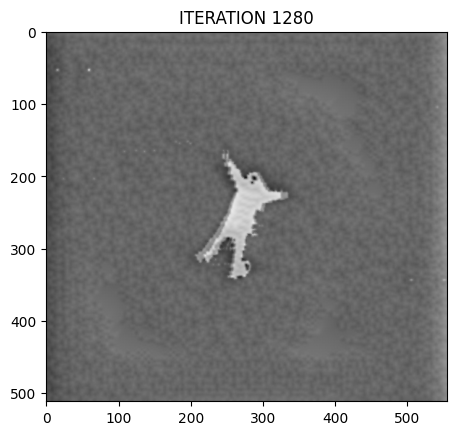

Style Loss: 0.2611 Content Loss: 3.0499



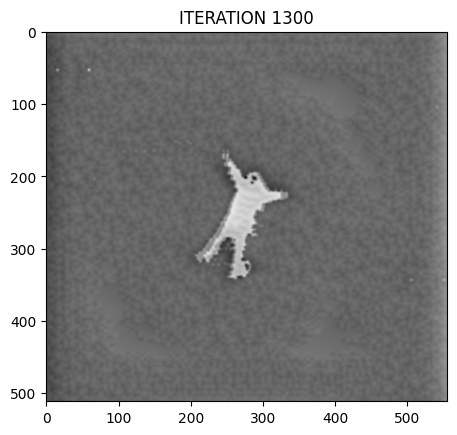

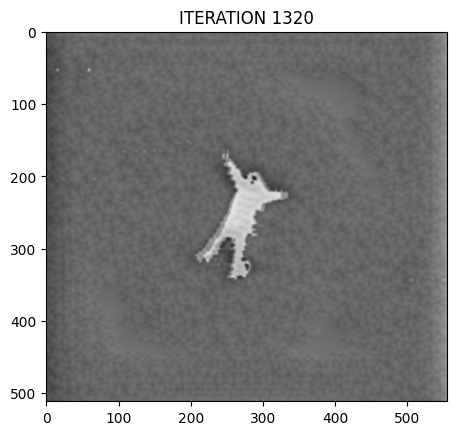

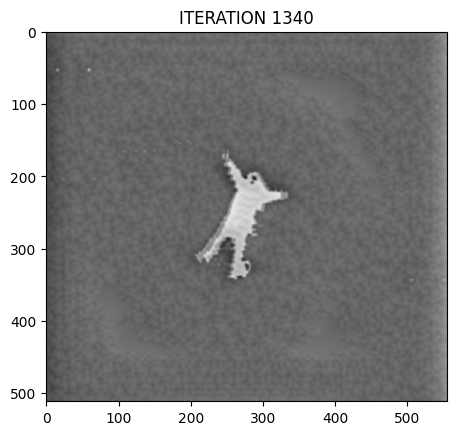

Style Loss: 0.2606 Content Loss: 3.0494



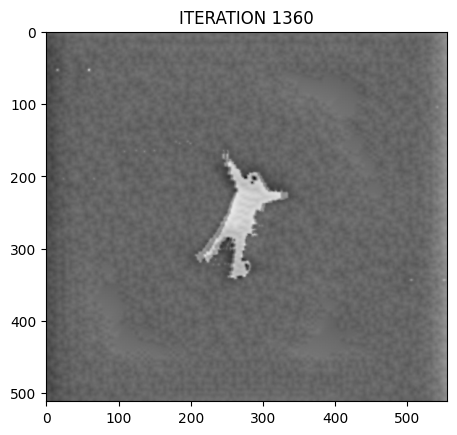

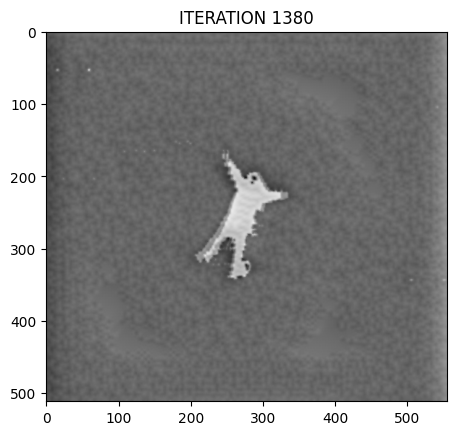

Style Loss: 0.2601 Content Loss: 3.0490



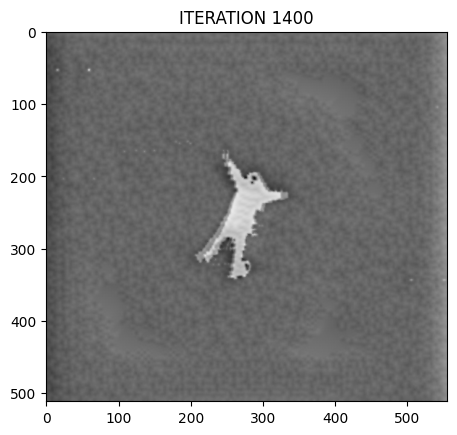

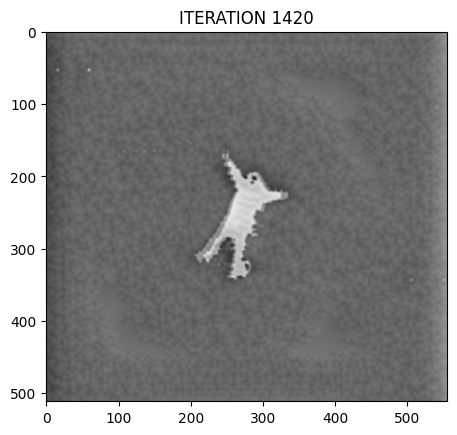

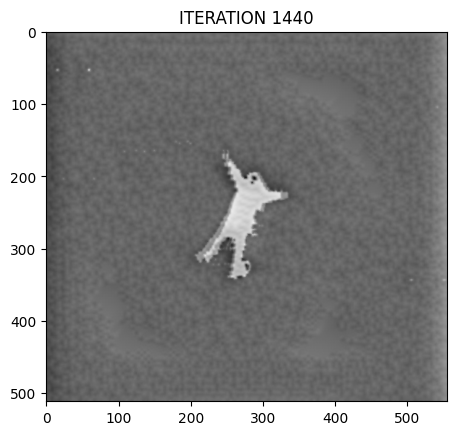

Style Loss: 0.2595 Content Loss: 3.0486



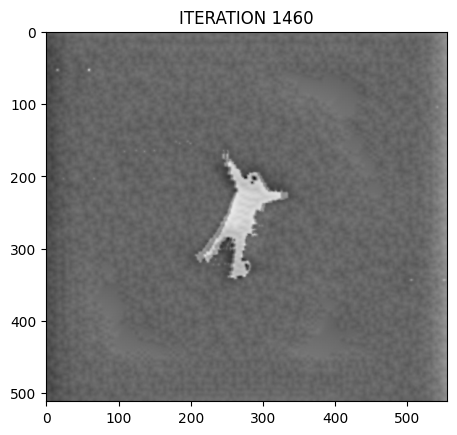

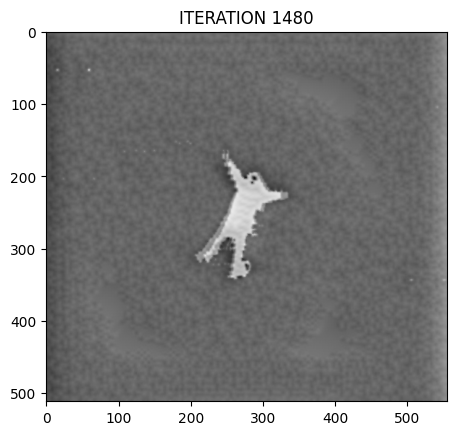

Style Loss: 0.2589 Content Loss: 3.0482



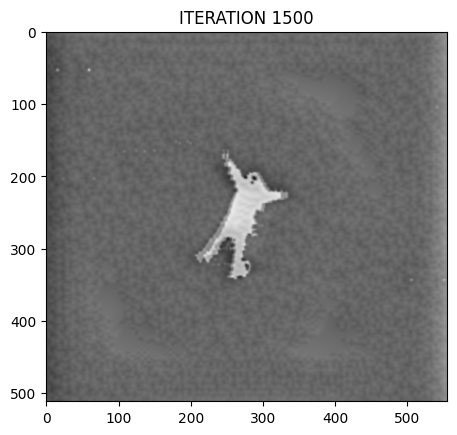

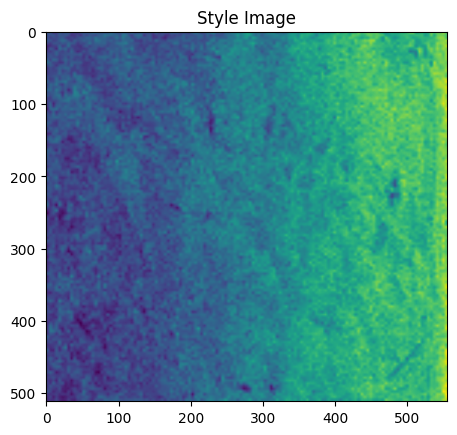

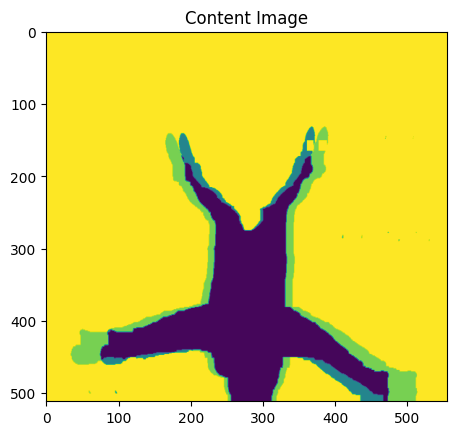

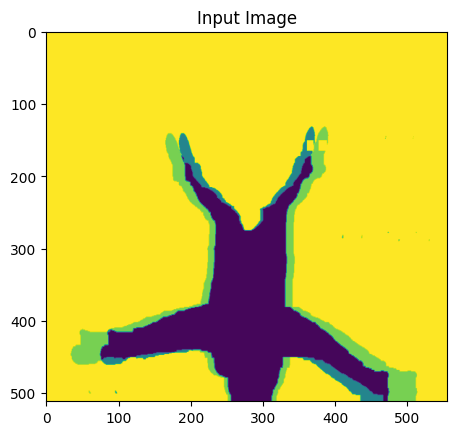

Model Building


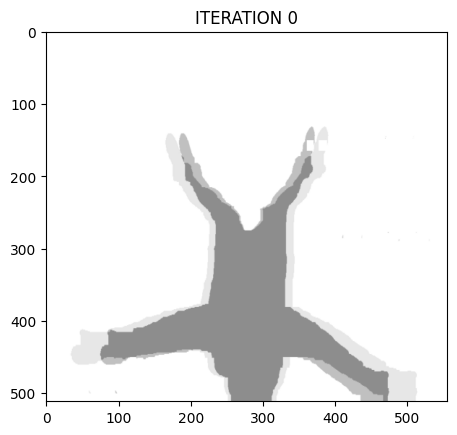

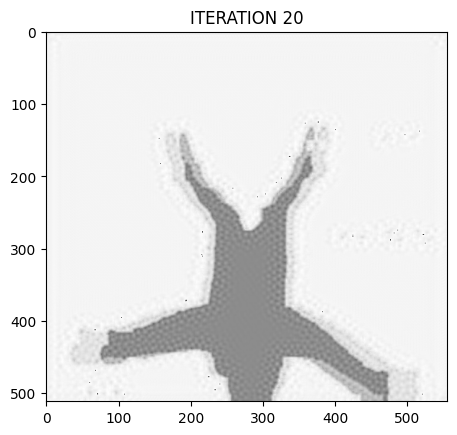

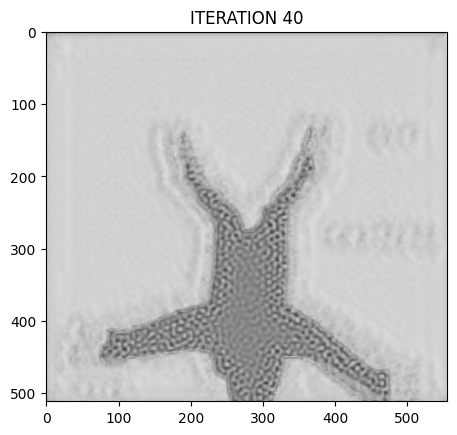

Style Loss: 18.8502 Content Loss: 6.8863



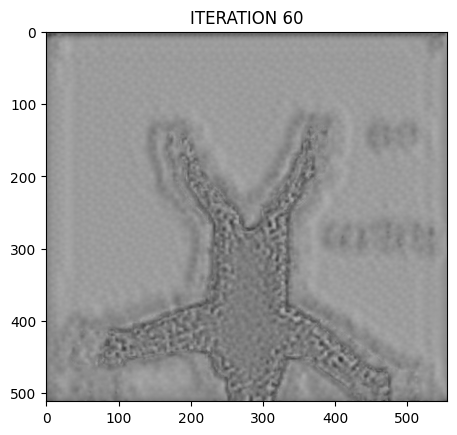

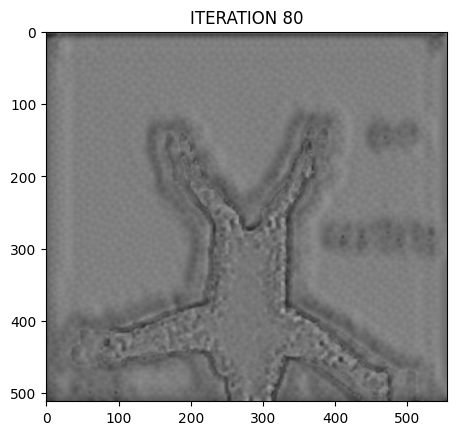

Style Loss: 0.5461 Content Loss: 5.5428



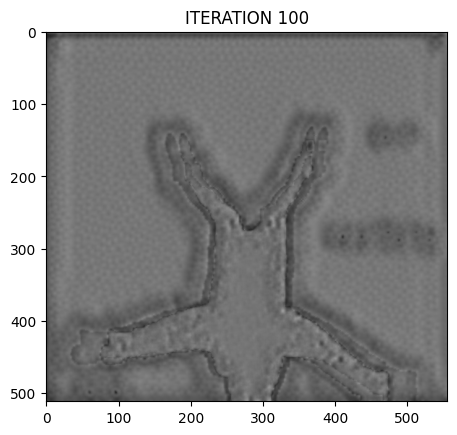

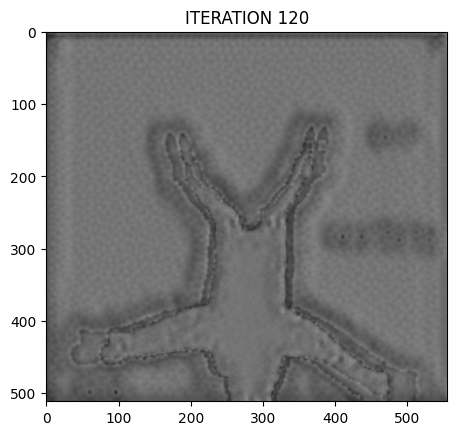

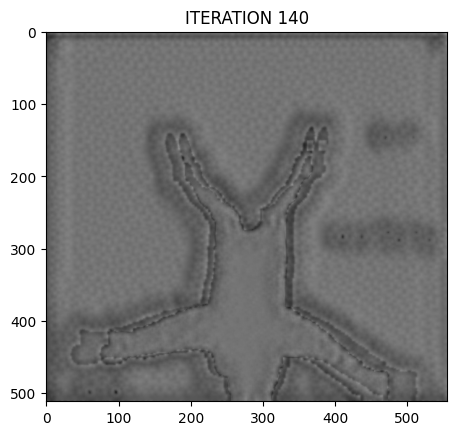

Style Loss: 0.3855 Content Loss: 4.6785



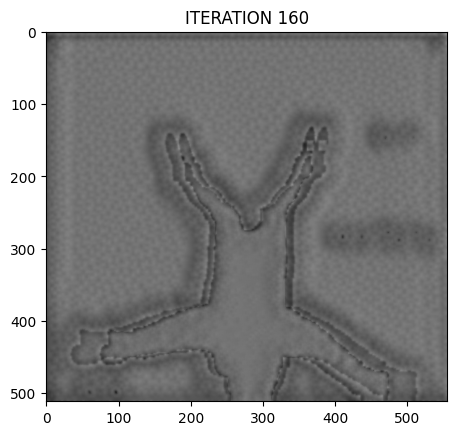

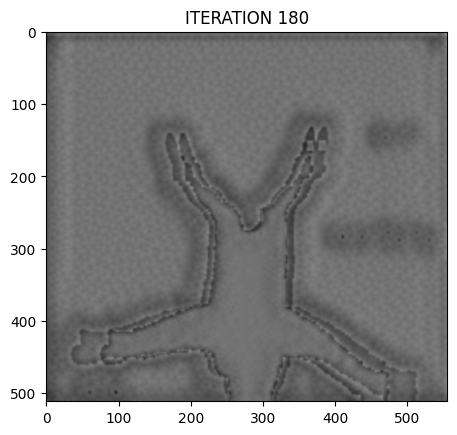

Style Loss: 0.3483 Content Loss: 4.3737



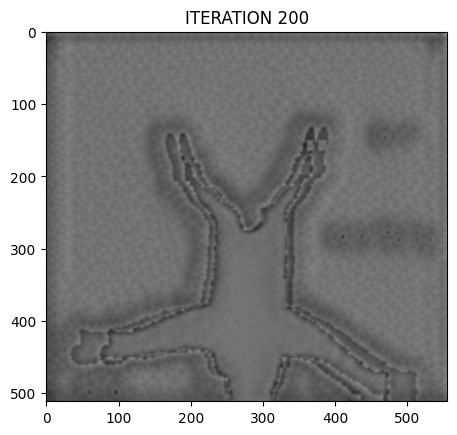

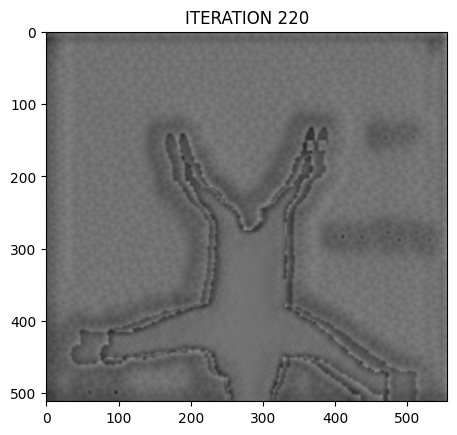

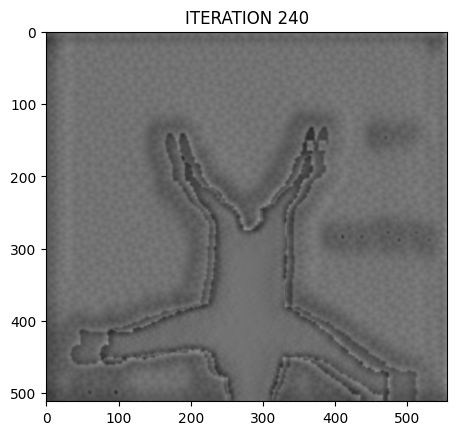

Style Loss: 0.3316 Content Loss: 4.2377



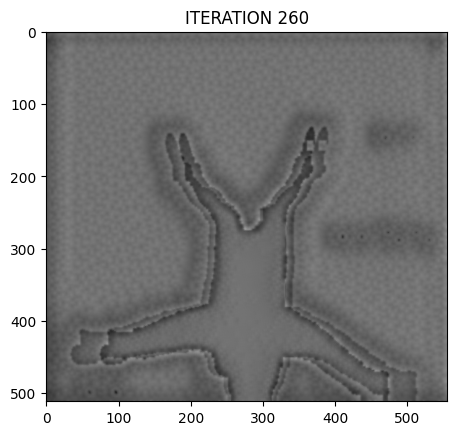

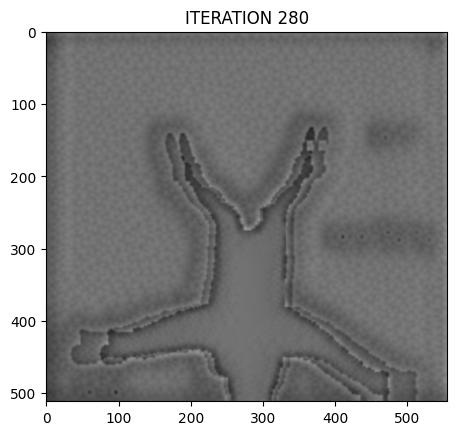

Style Loss: 0.3247 Content Loss: 4.1600



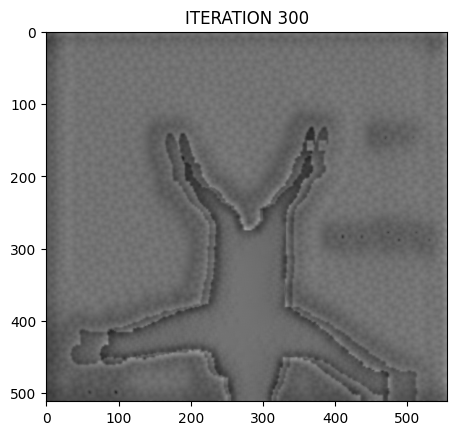

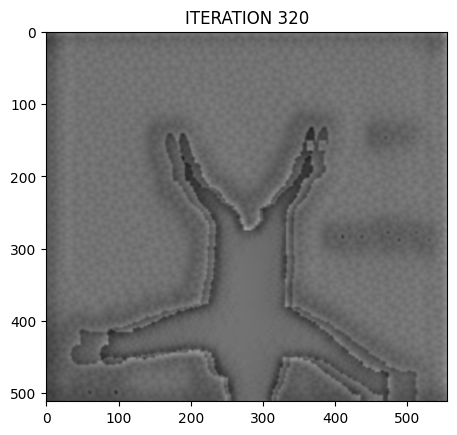

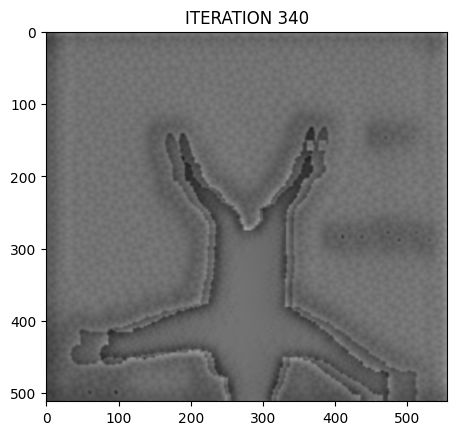

Style Loss: 0.3200 Content Loss: 4.1239



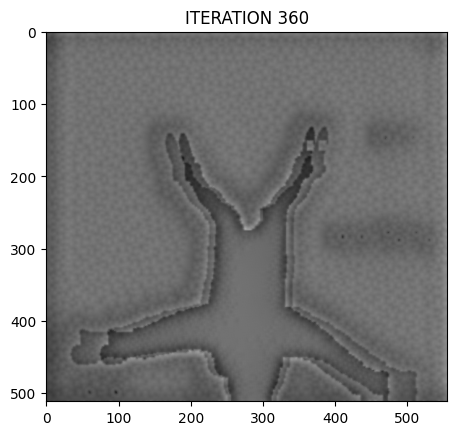

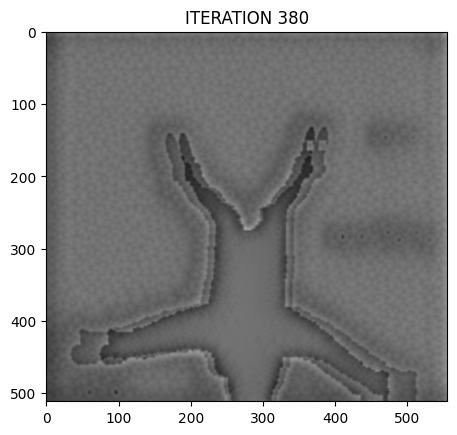

Style Loss: 0.3174 Content Loss: 4.1009



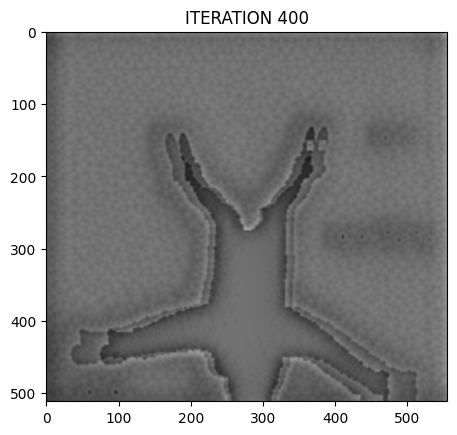

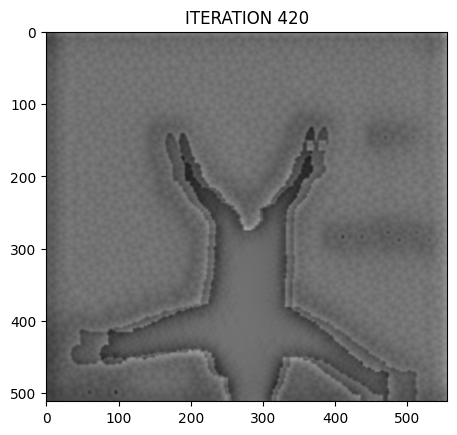

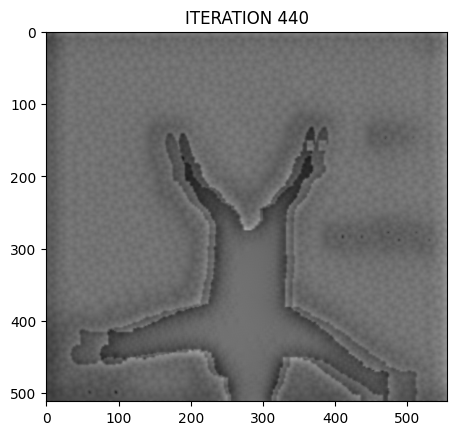

Style Loss: 0.3162 Content Loss: 4.0852



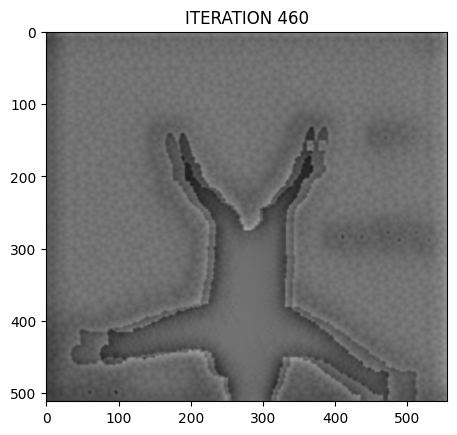

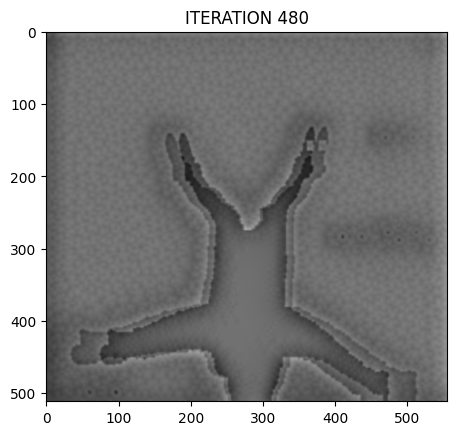

Style Loss: 0.3150 Content Loss: 4.0737



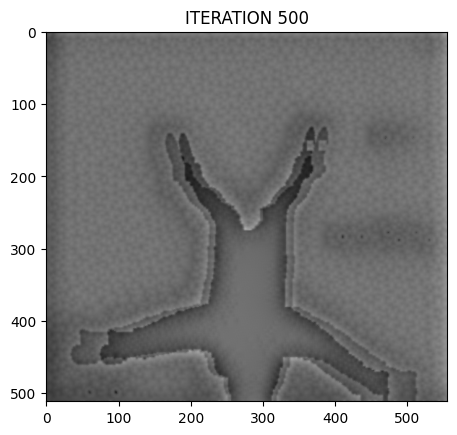

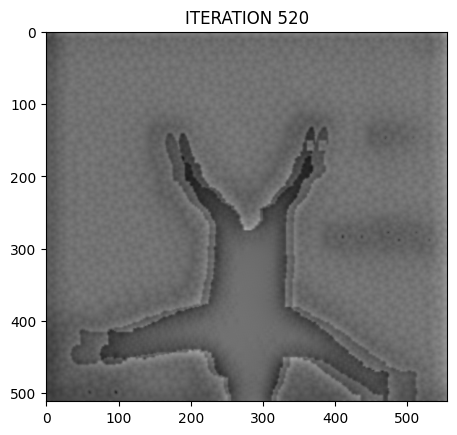

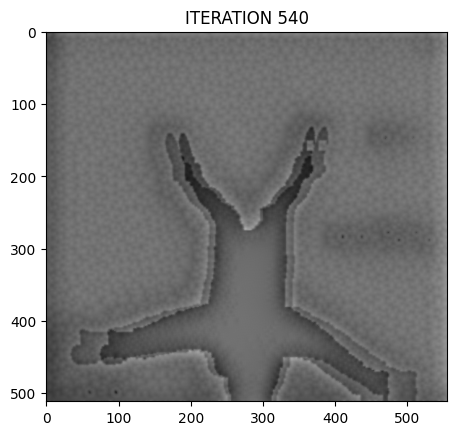

Style Loss: 0.3137 Content Loss: 4.0659



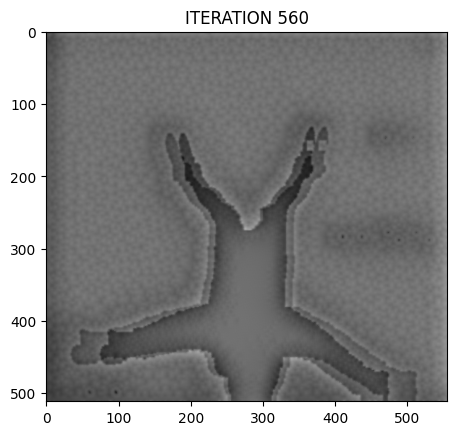

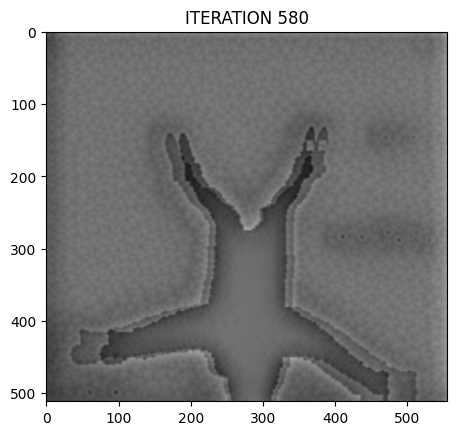

Style Loss: 0.3124 Content Loss: 4.0604



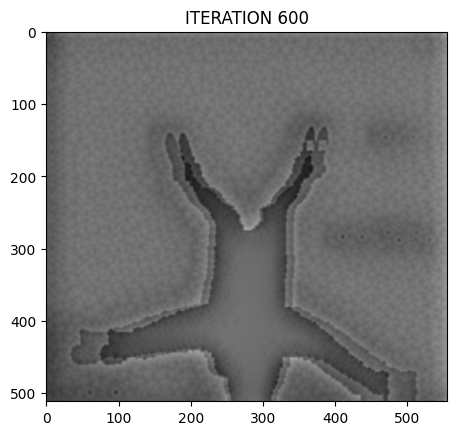

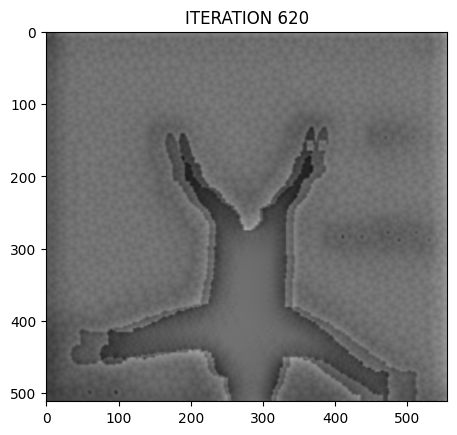

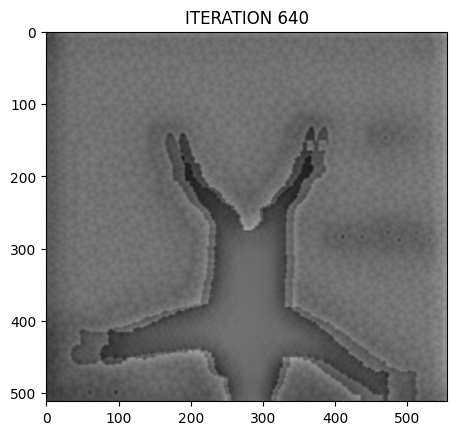

Style Loss: 0.3115 Content Loss: 4.0557



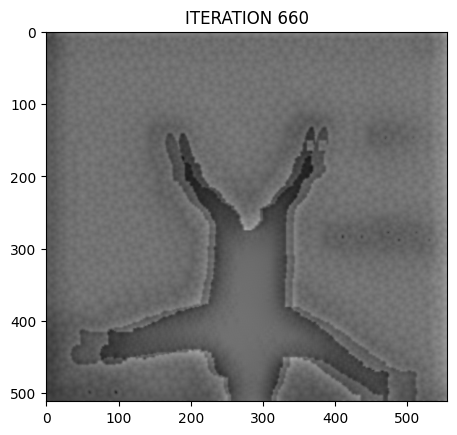

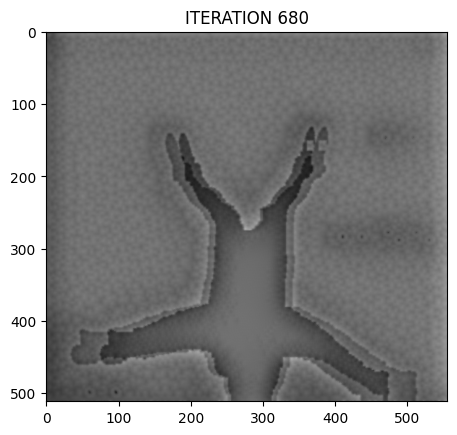

Style Loss: 0.3107 Content Loss: 4.0519



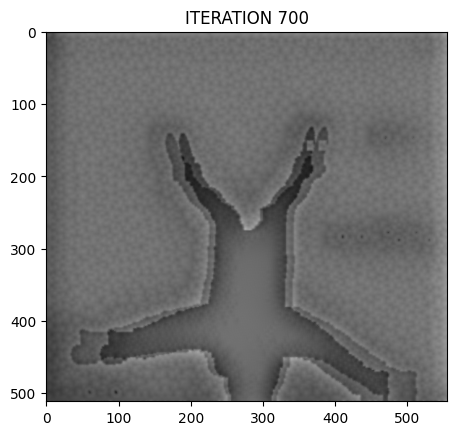

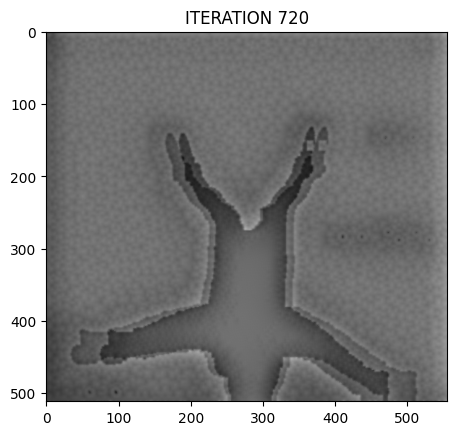

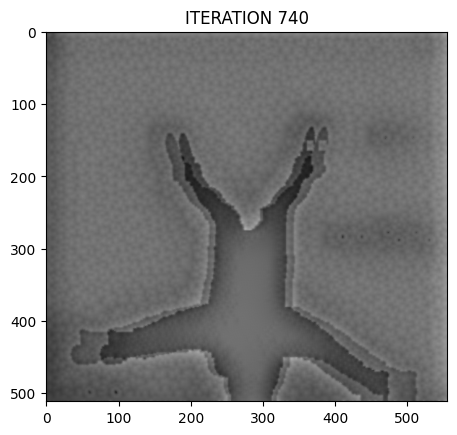

Style Loss: 0.3099 Content Loss: 4.0489



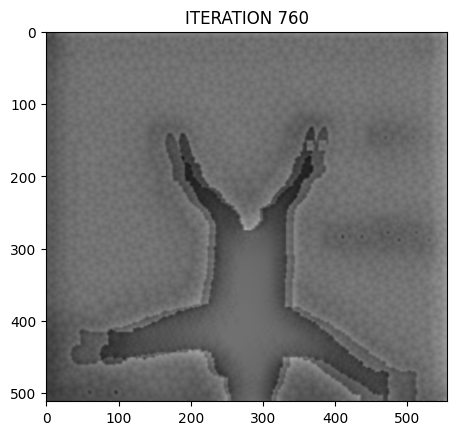

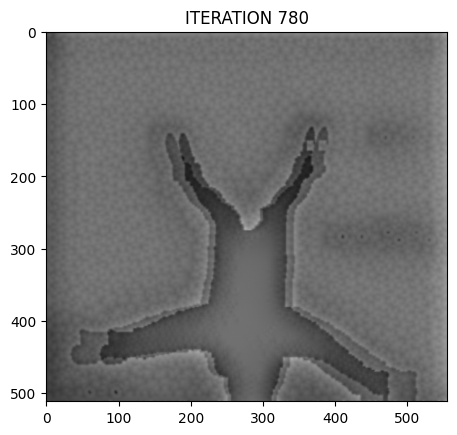

Style Loss: 0.3092 Content Loss: 4.0462



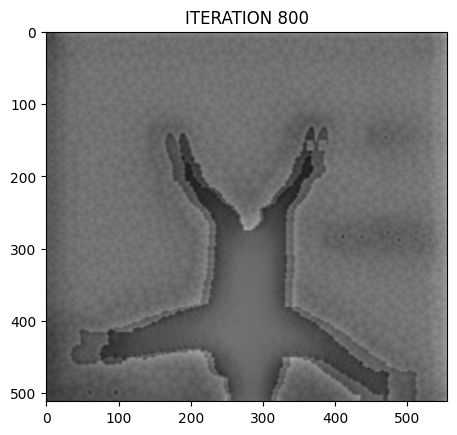

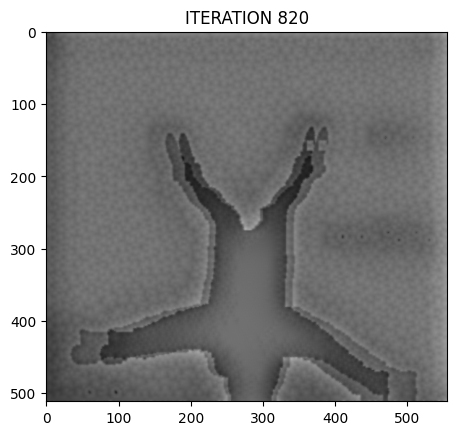

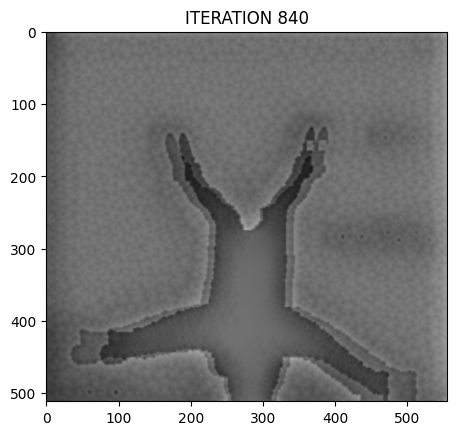

Style Loss: 0.3085 Content Loss: 4.0439



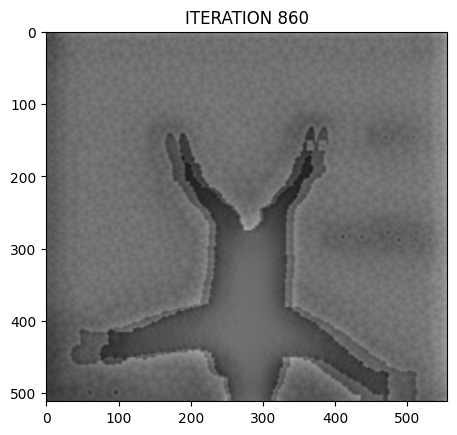

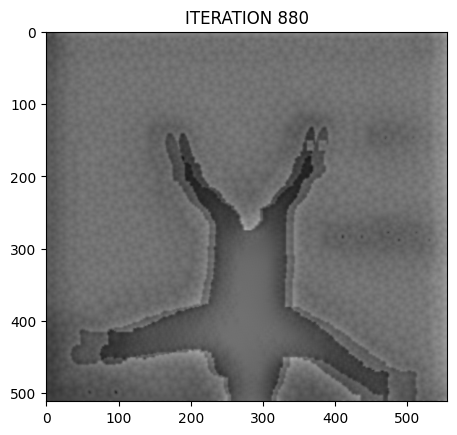

Style Loss: 0.3080 Content Loss: 4.0416



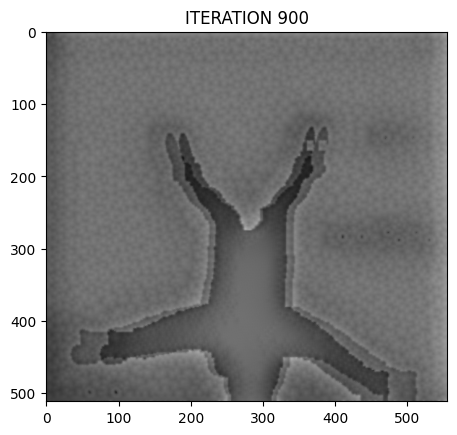

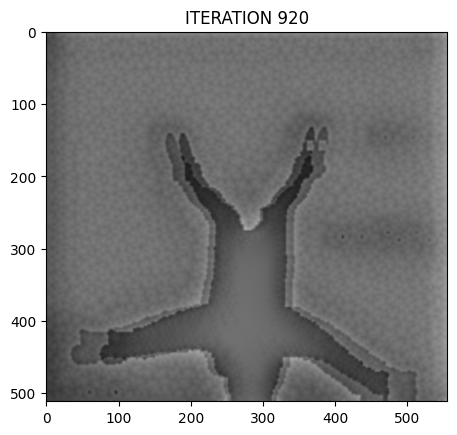

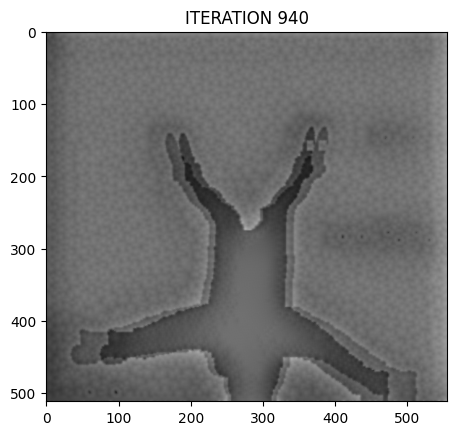

Style Loss: 0.3077 Content Loss: 4.0395



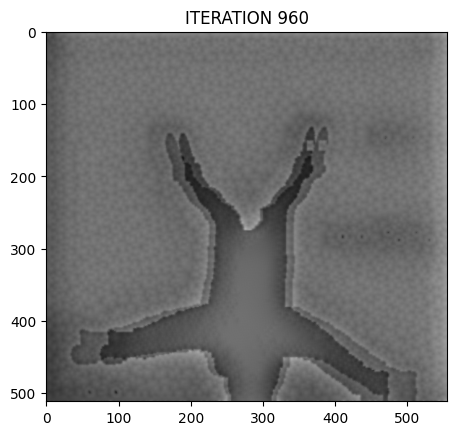

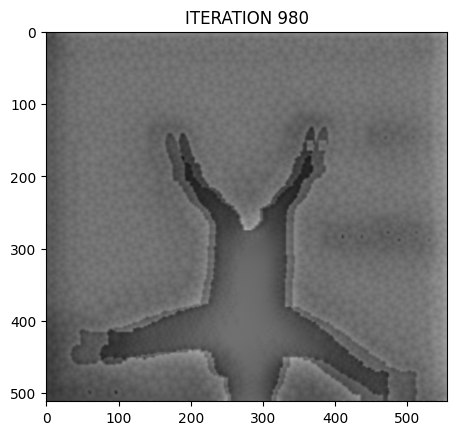

Style Loss: 0.3073 Content Loss: 4.0377



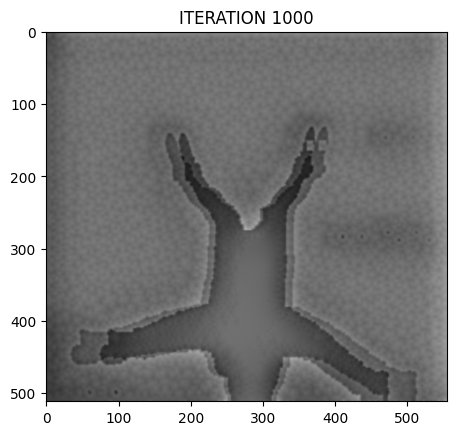

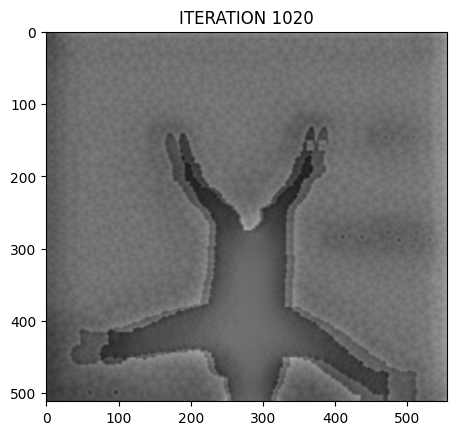

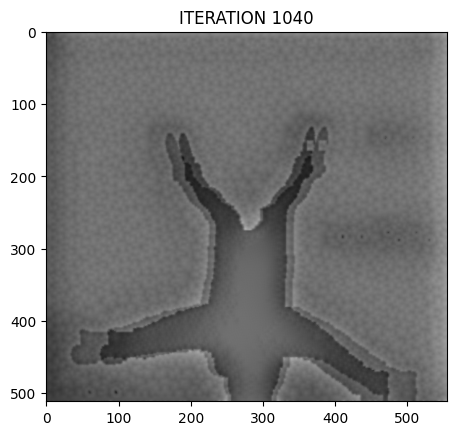

Style Loss: 0.3070 Content Loss: 4.0360



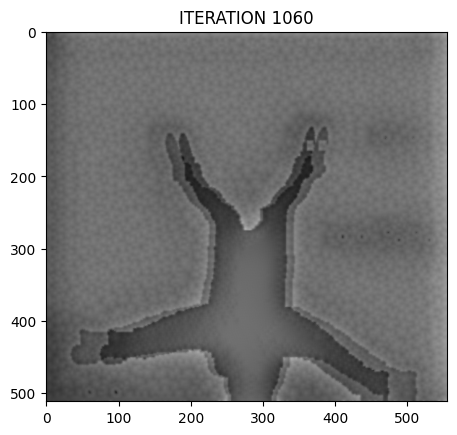

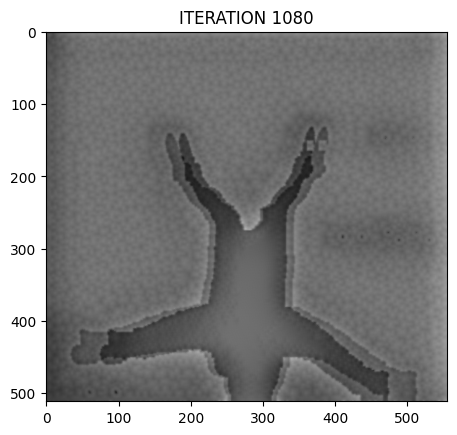

Style Loss: 0.3067 Content Loss: 4.0346



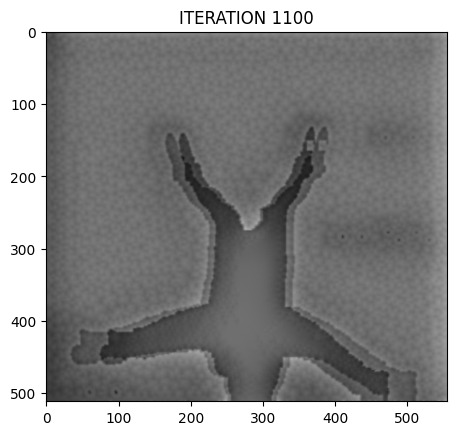

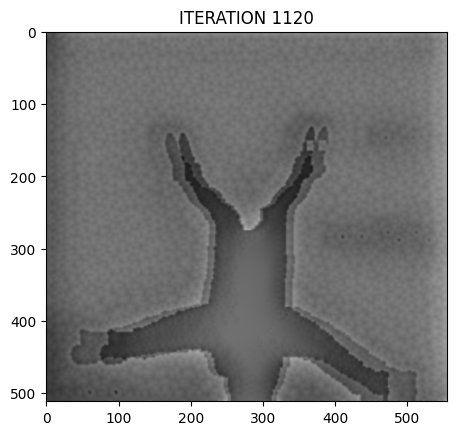

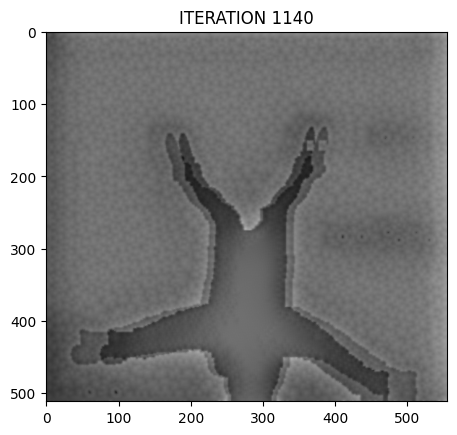

Style Loss: 0.3064 Content Loss: 4.0334



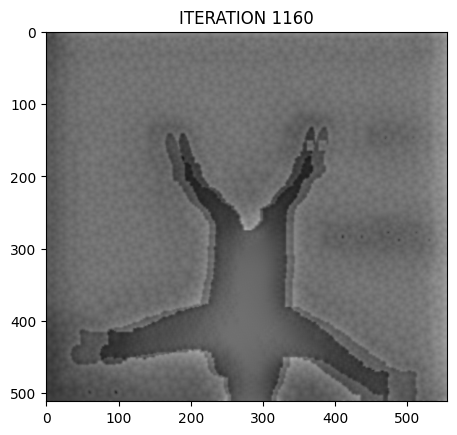

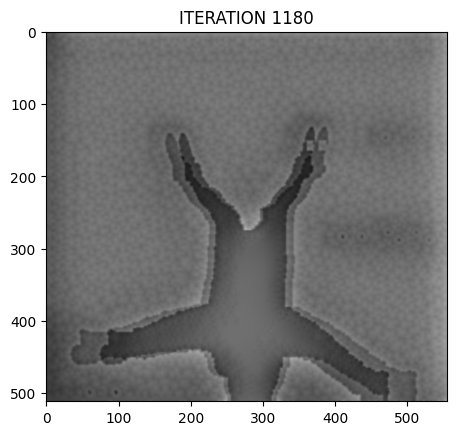

Style Loss: 0.3061 Content Loss: 4.0322



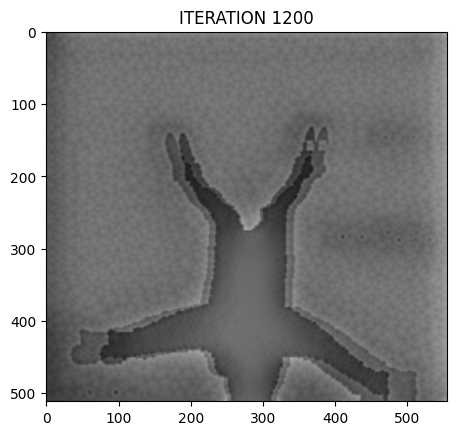

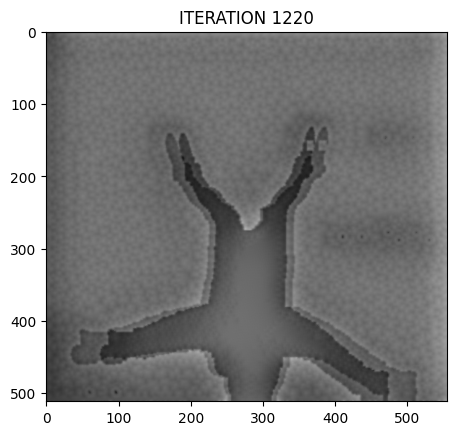

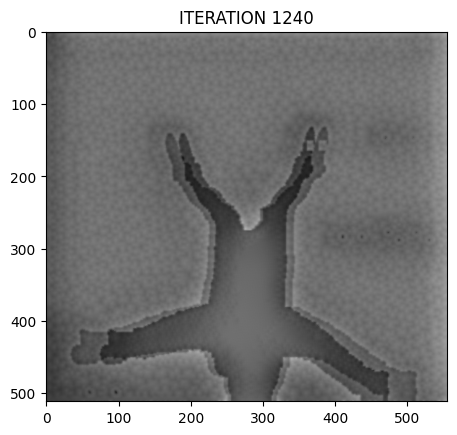

Style Loss: 0.3058 Content Loss: 4.0313



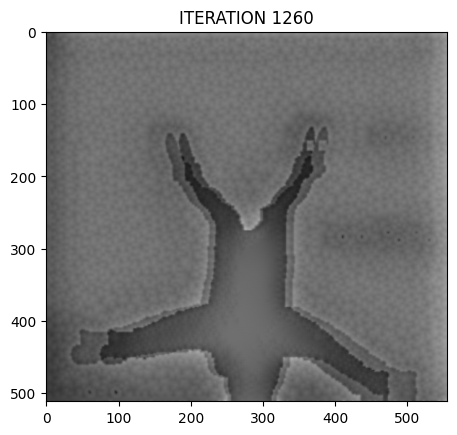

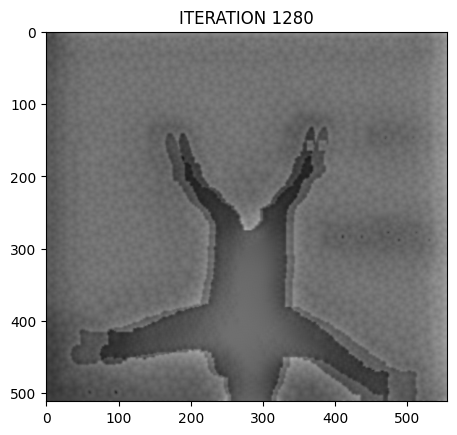

Style Loss: 0.3055 Content Loss: 4.0303



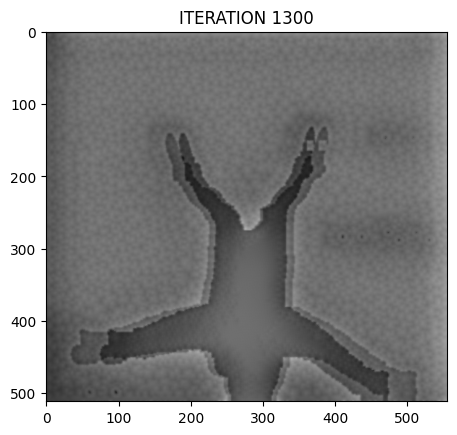

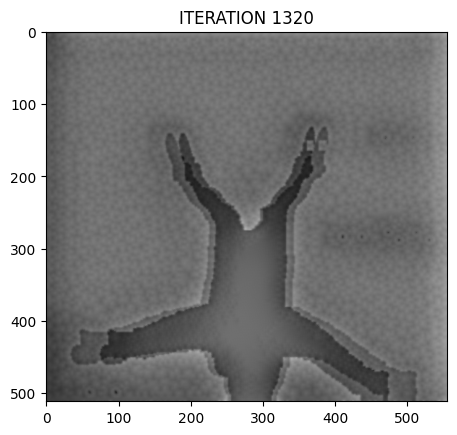

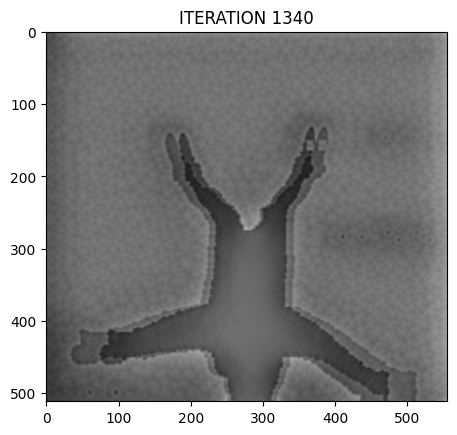

Style Loss: 0.3053 Content Loss: 4.0294



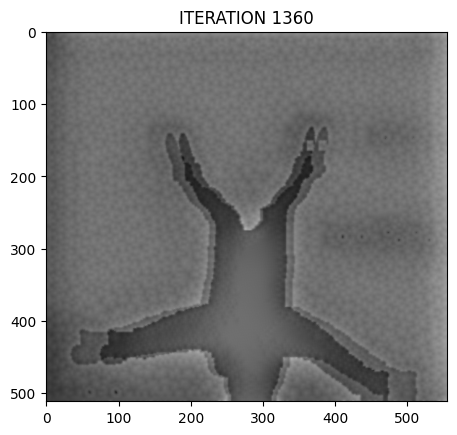

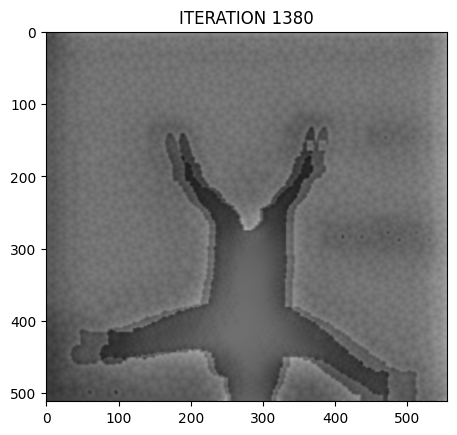

Style Loss: 0.3050 Content Loss: 4.0285



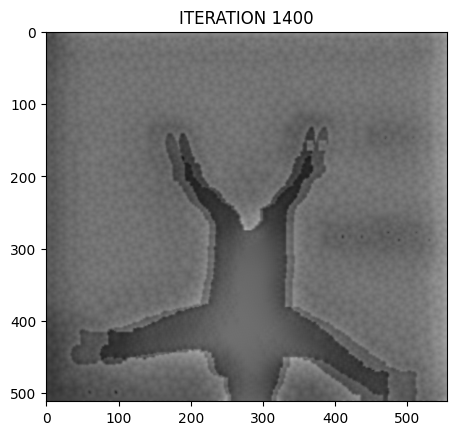

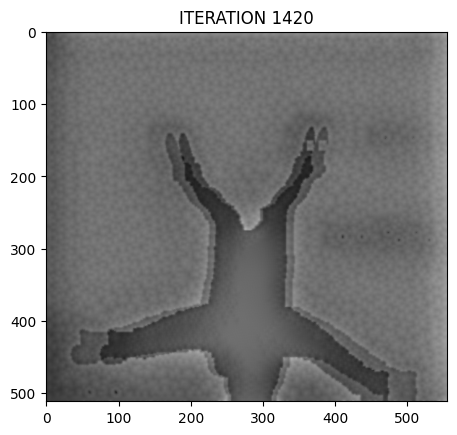

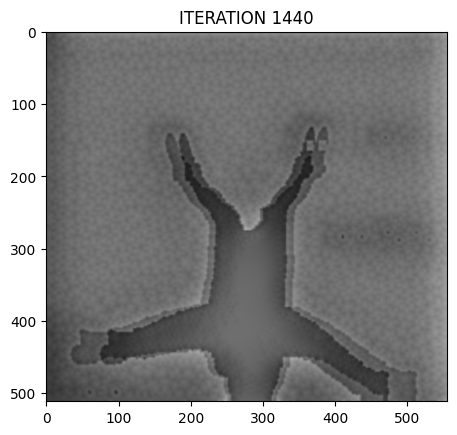

Style Loss: 0.3046 Content Loss: 4.0278



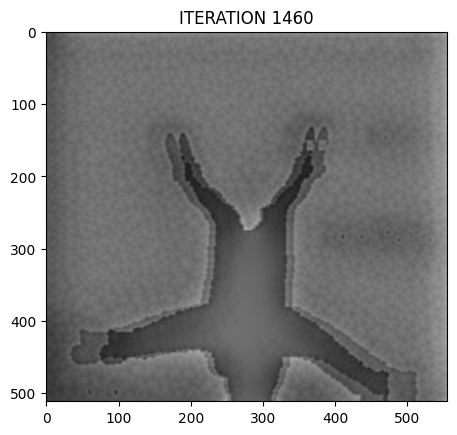

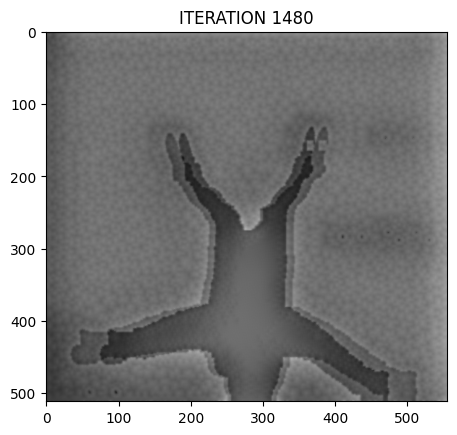

Style Loss: 0.3042 Content Loss: 4.0270



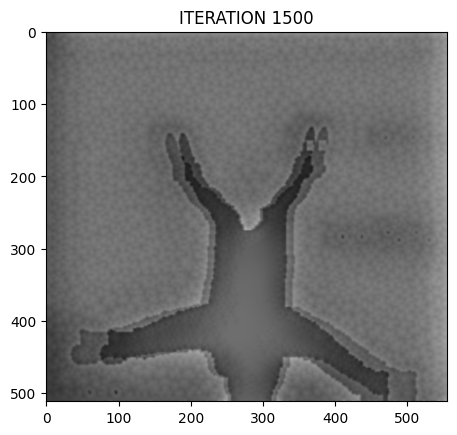

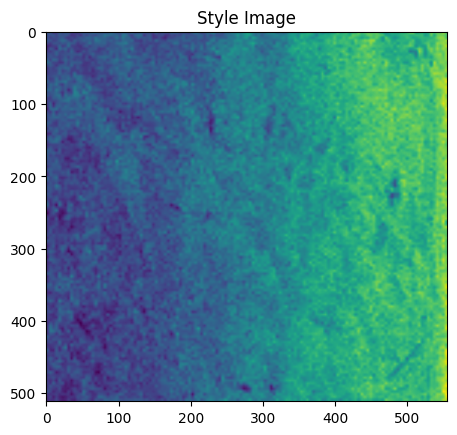

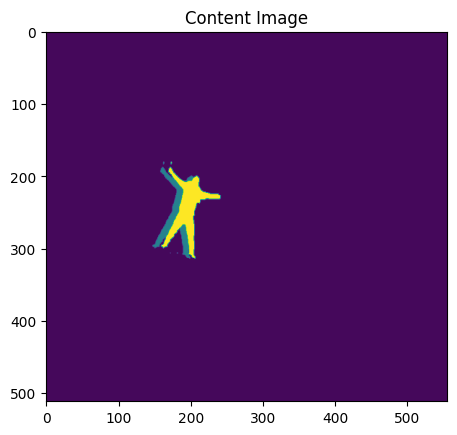

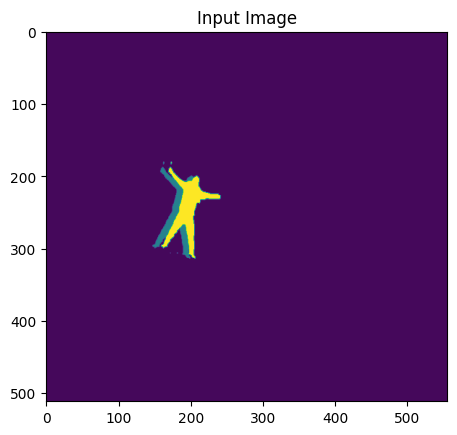

Model Building


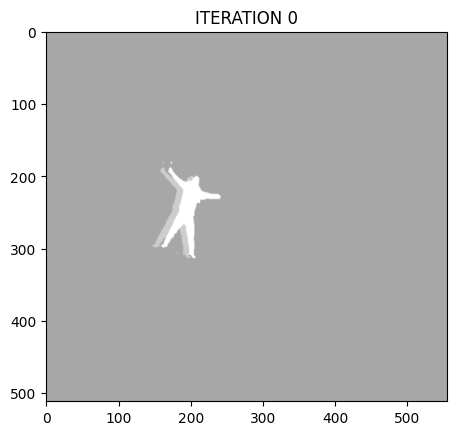

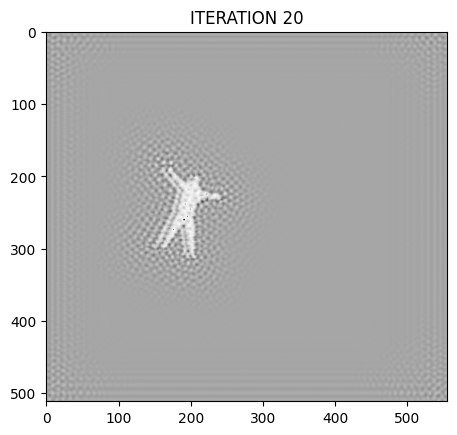

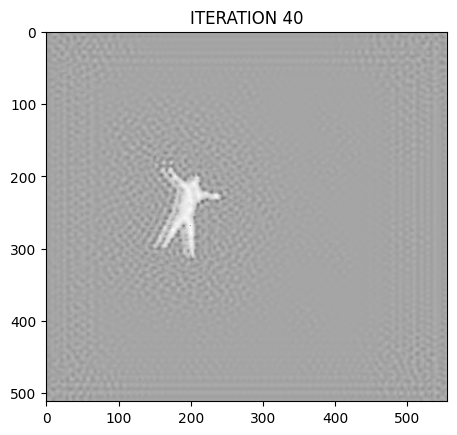

Style Loss: 9.5898 Content Loss: 3.5176



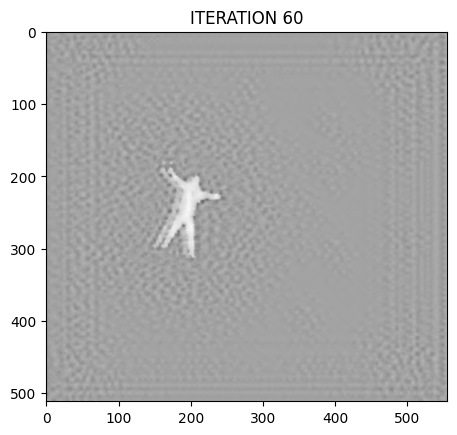

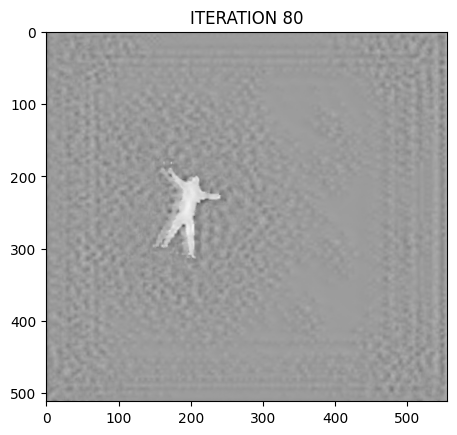

Style Loss: 3.0642 Content Loss: 3.6620



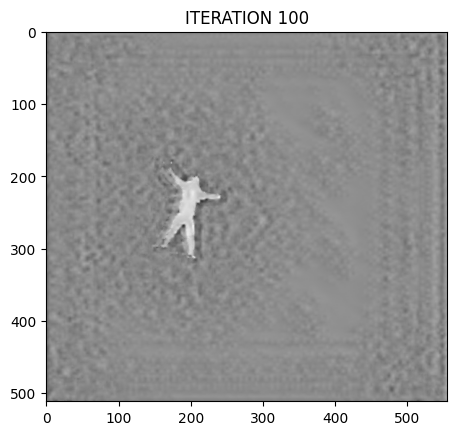

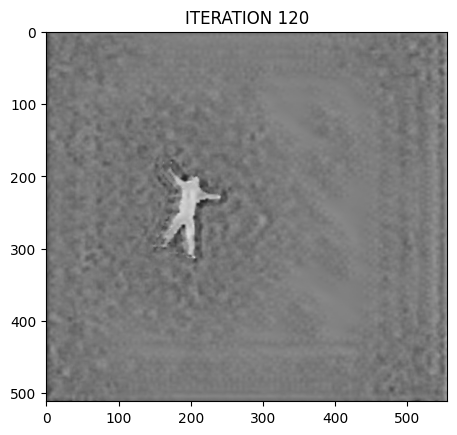

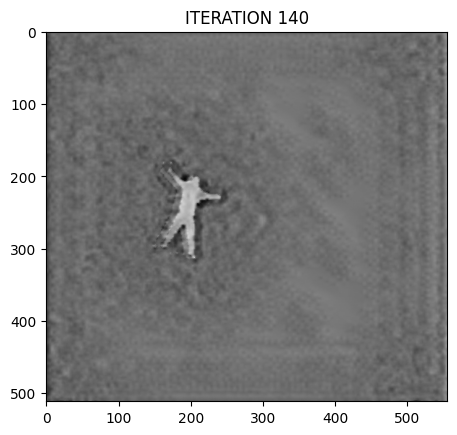

Style Loss: 0.3533 Content Loss: 3.4773



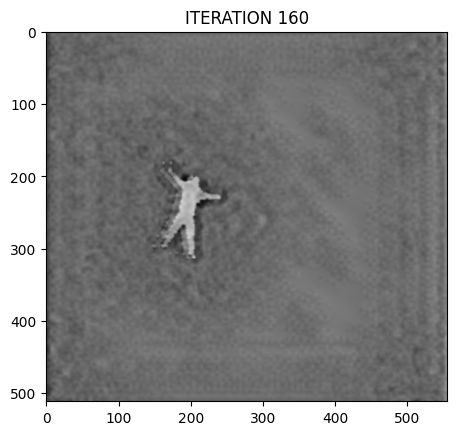

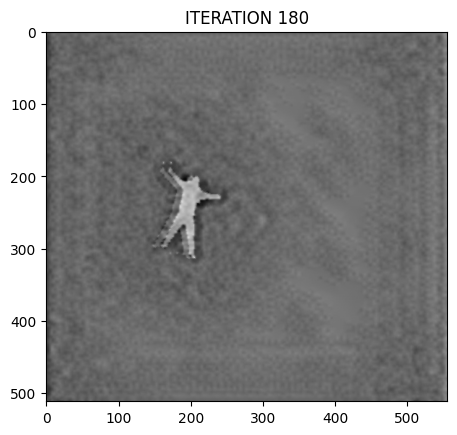

Style Loss: 0.2337 Content Loss: 3.3071



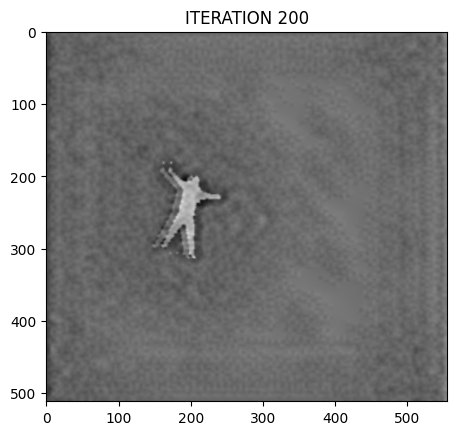

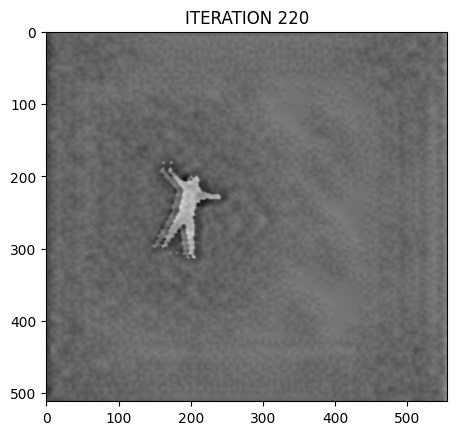

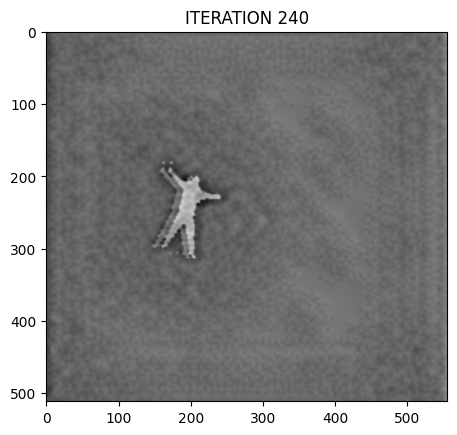

Style Loss: 0.2388 Content Loss: 3.2433



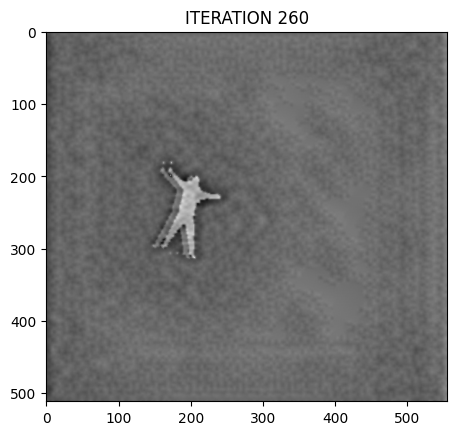

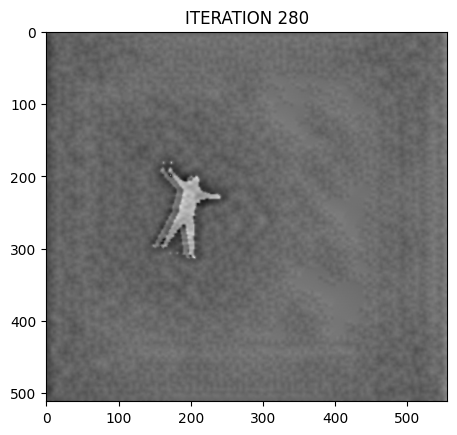

Style Loss: 0.2393 Content Loss: 3.2239



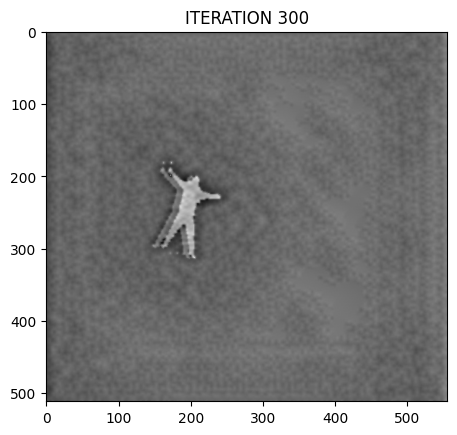

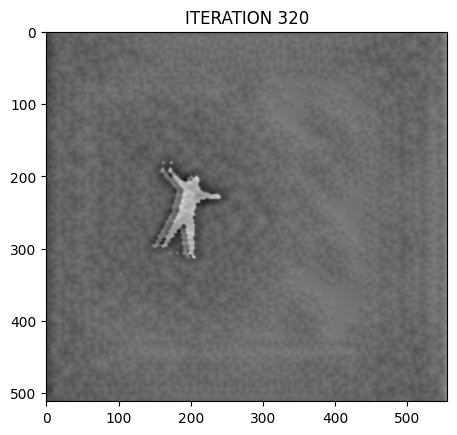

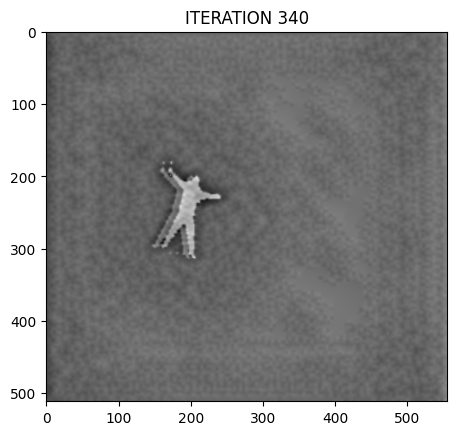

Style Loss: 0.2392 Content Loss: 3.2157



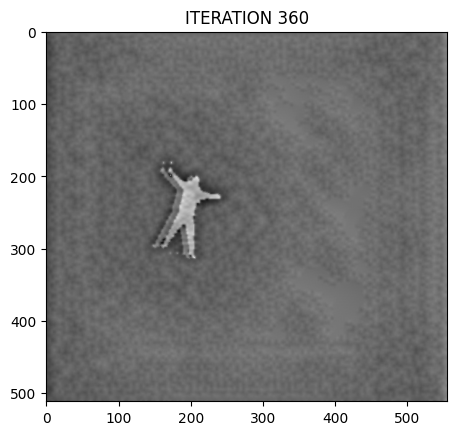

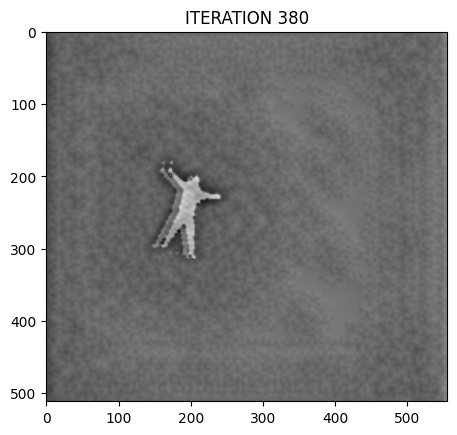

Style Loss: 0.2389 Content Loss: 3.2104



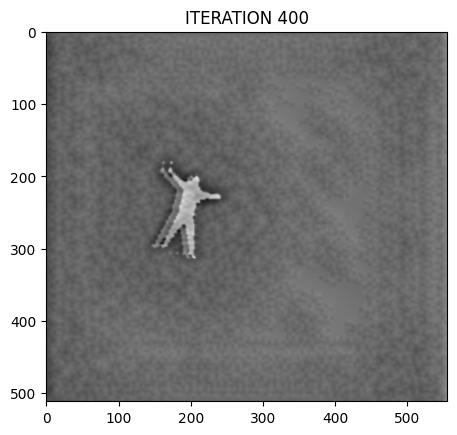

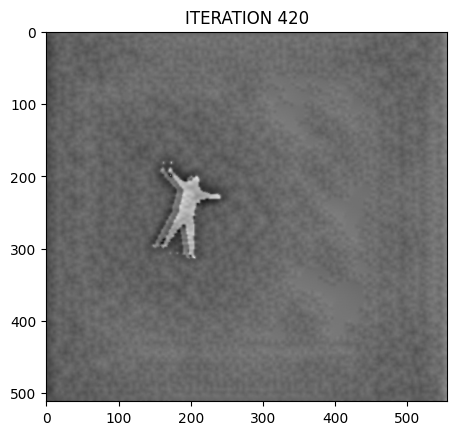

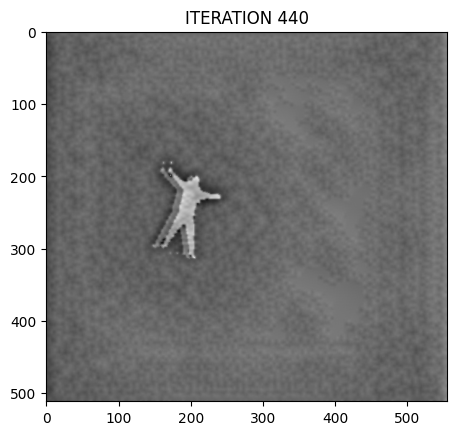

Style Loss: 0.2384 Content Loss: 3.2069



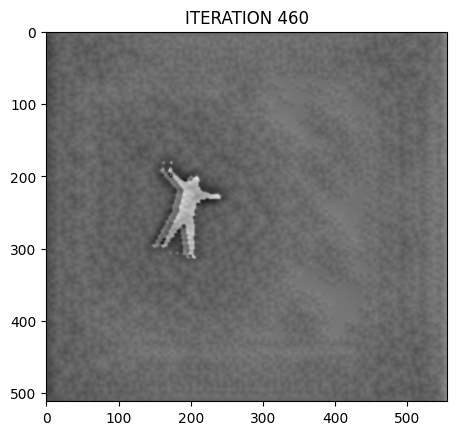

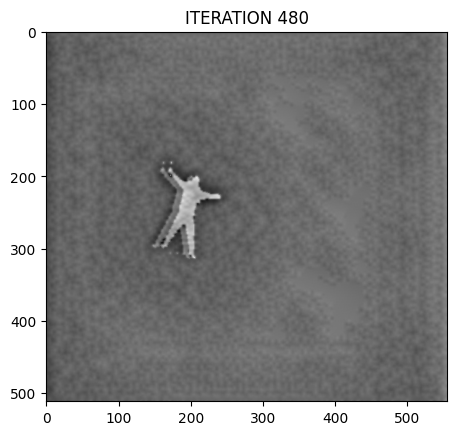

Style Loss: 0.2383 Content Loss: 3.2039



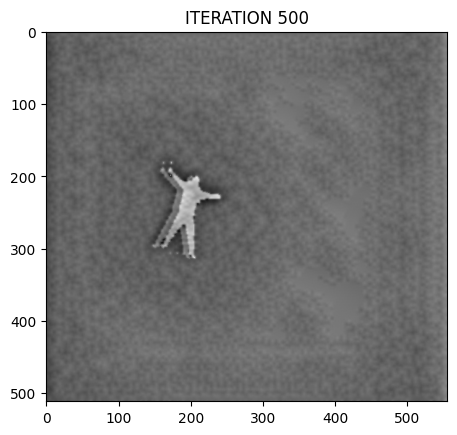

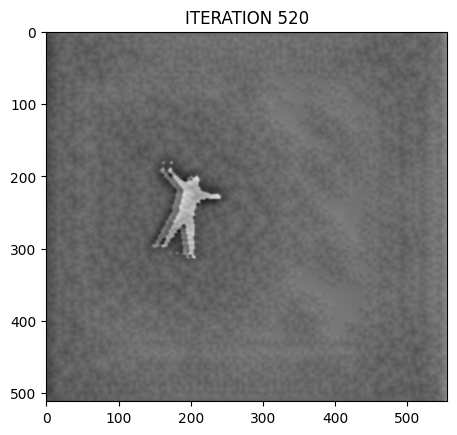

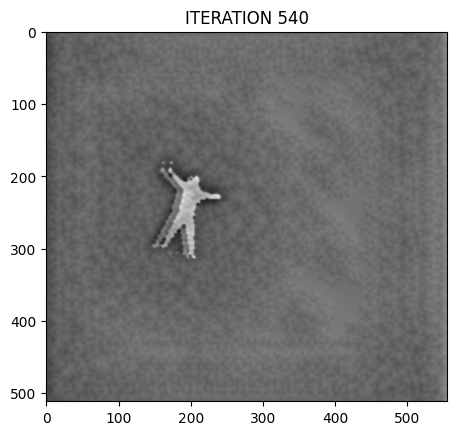

Style Loss: 0.2377 Content Loss: 3.2019



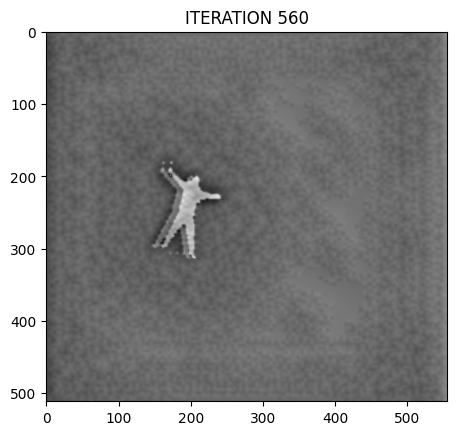

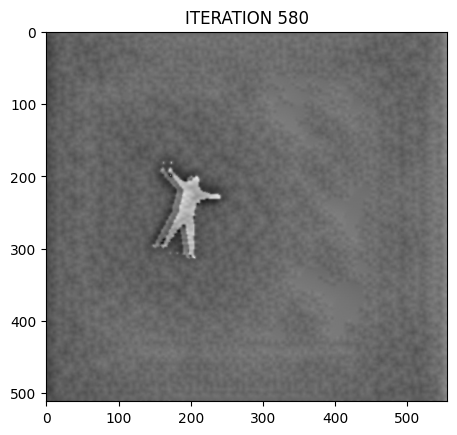

Style Loss: 0.2371 Content Loss: 3.1998



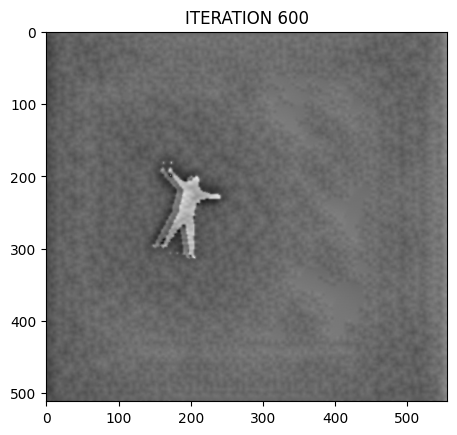

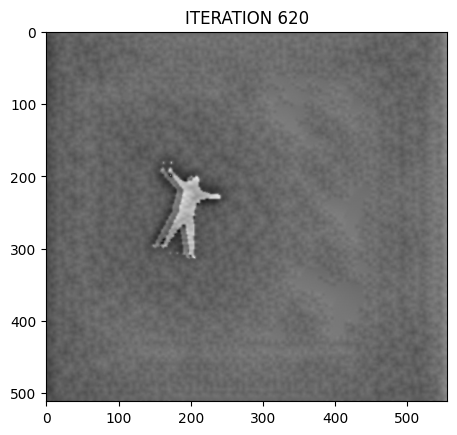

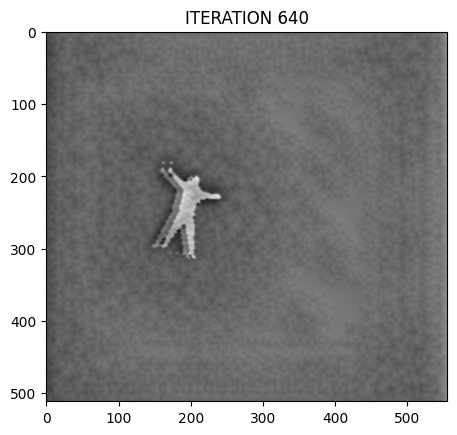

Style Loss: 0.2363 Content Loss: 3.1979



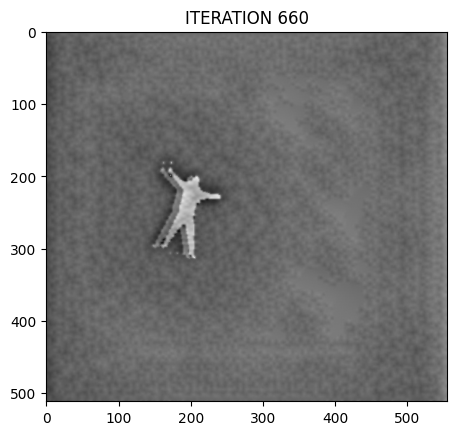

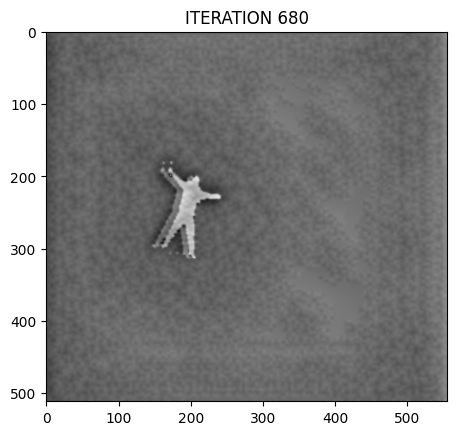

Style Loss: 0.2352 Content Loss: 3.1964



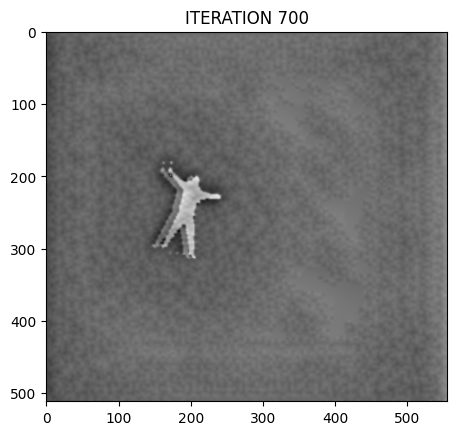

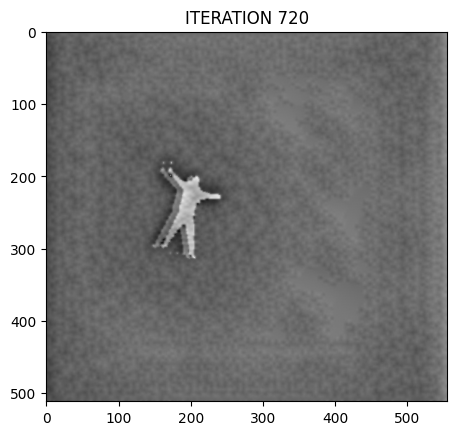

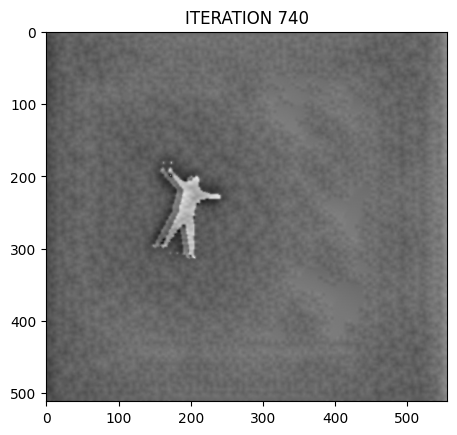

Style Loss: 0.2344 Content Loss: 3.1950



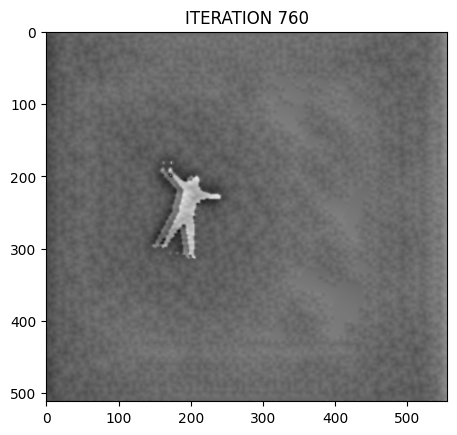

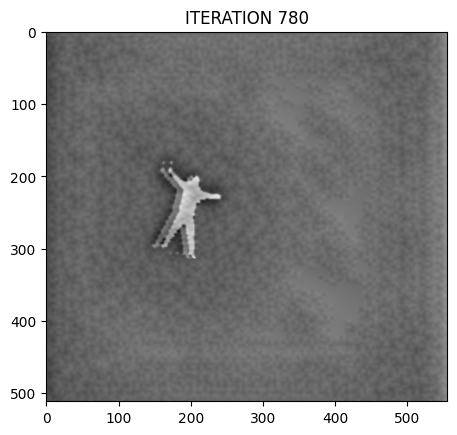

Style Loss: 0.2334 Content Loss: 3.1938



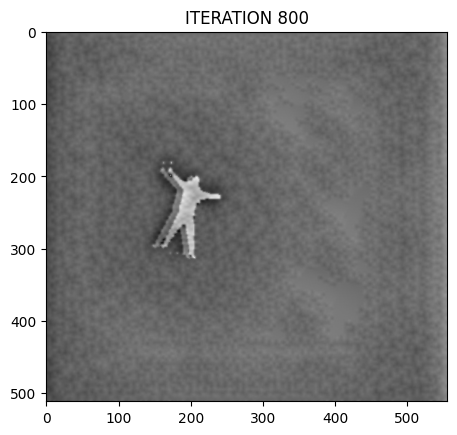

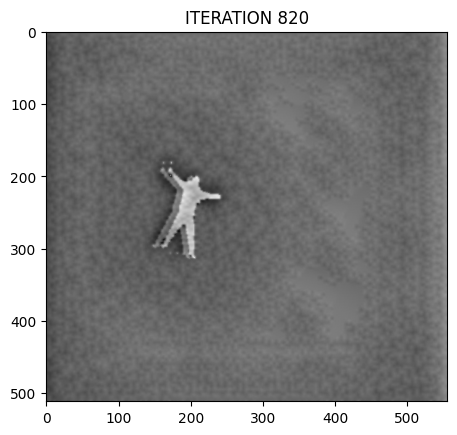

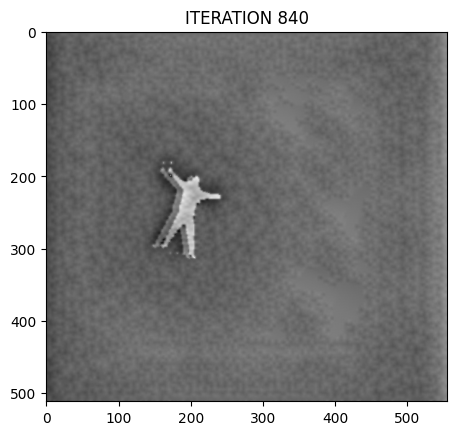

Style Loss: 0.2317 Content Loss: 3.1929



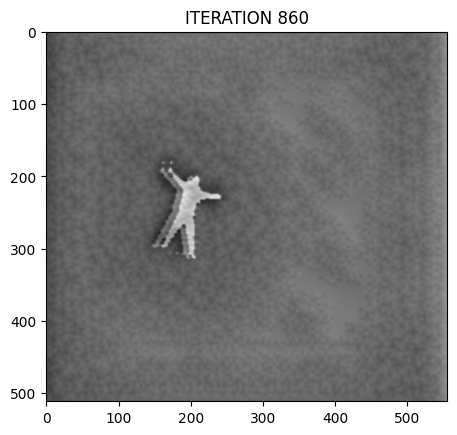

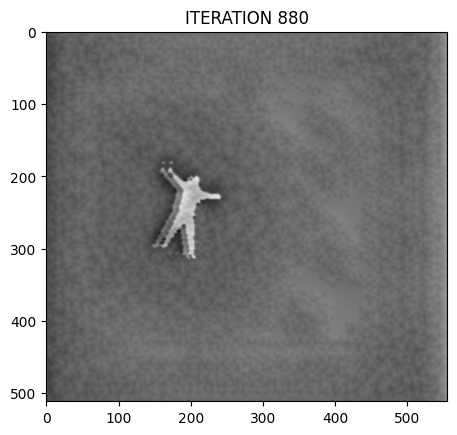

Style Loss: 0.2295 Content Loss: 3.1921



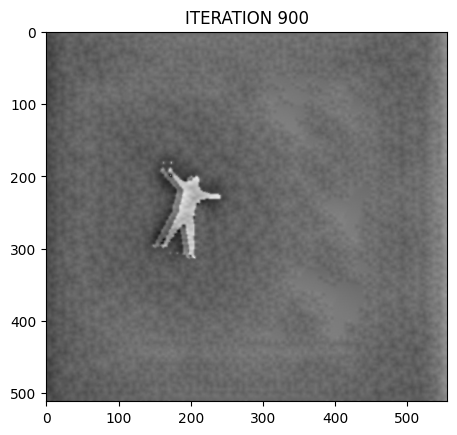

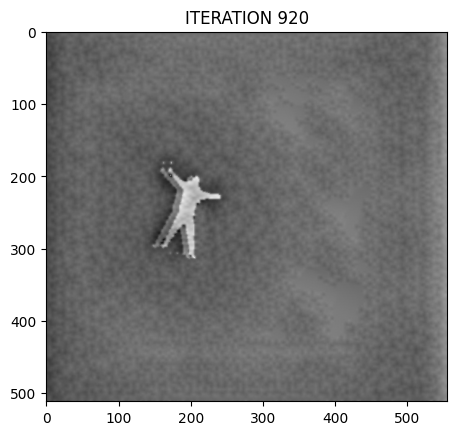

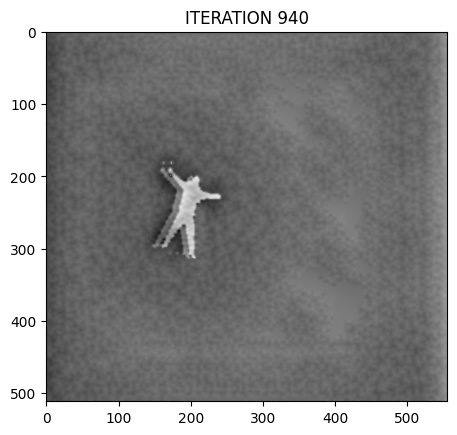

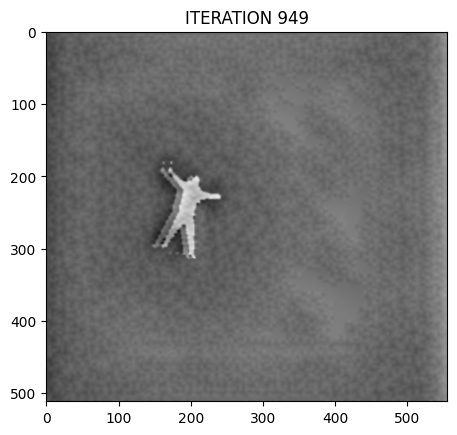

Style Loss: 0.2265 Content Loss: 3.1917



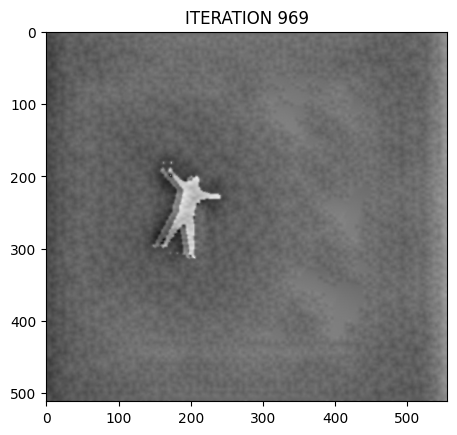

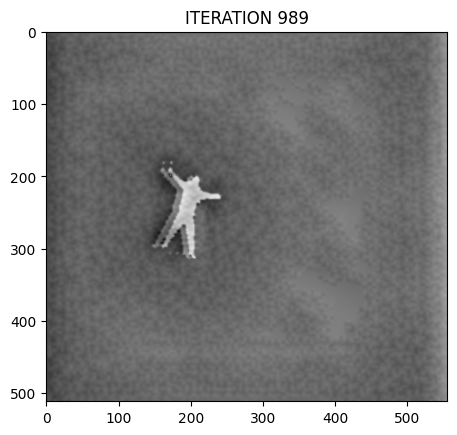

Style Loss: 0.2228 Content Loss: 3.1913



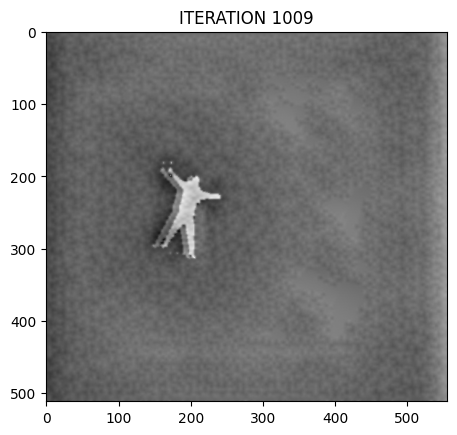

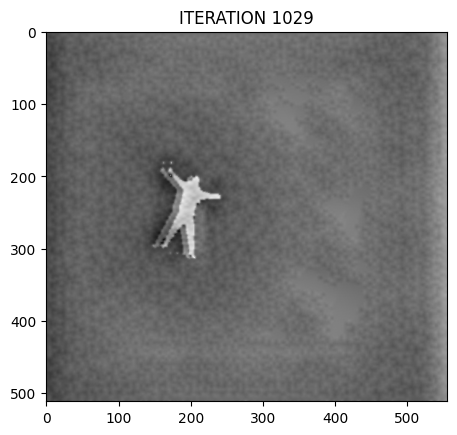

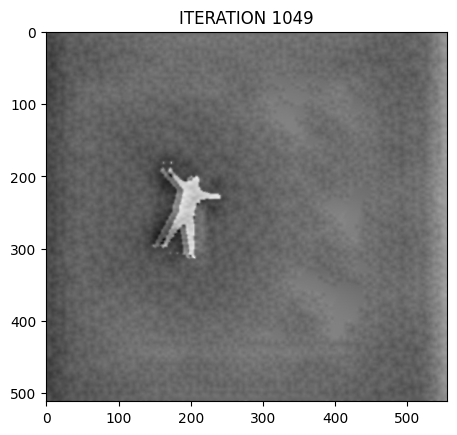

Style Loss: 0.2178 Content Loss: 3.1918



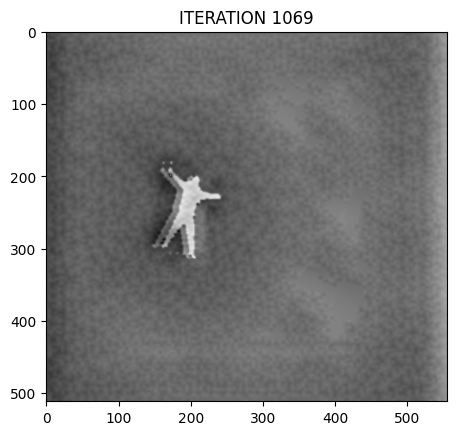

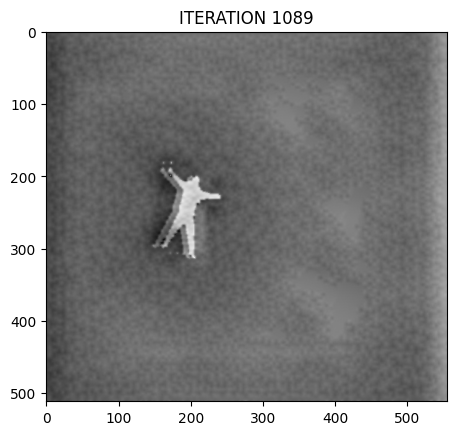

Style Loss: 0.2124 Content Loss: 3.1928



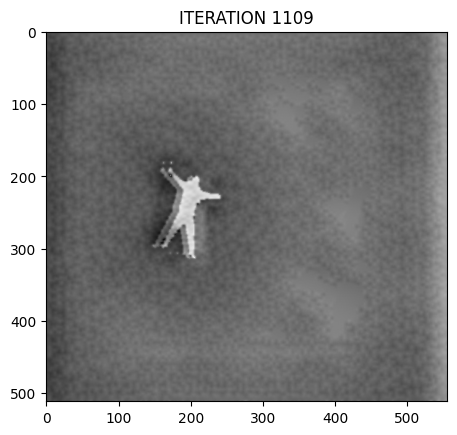

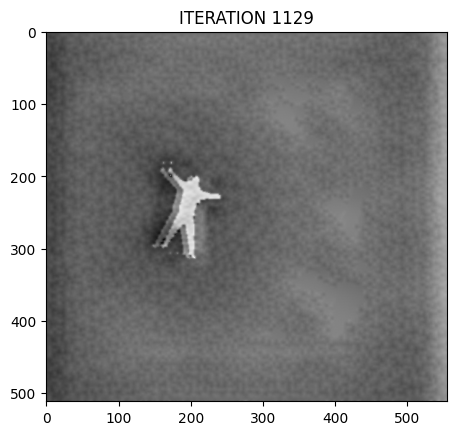

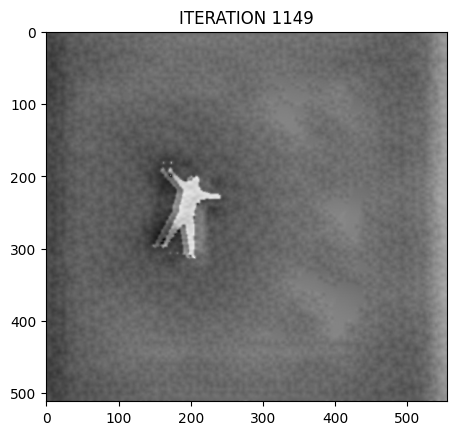

Style Loss: 0.2083 Content Loss: 3.1921



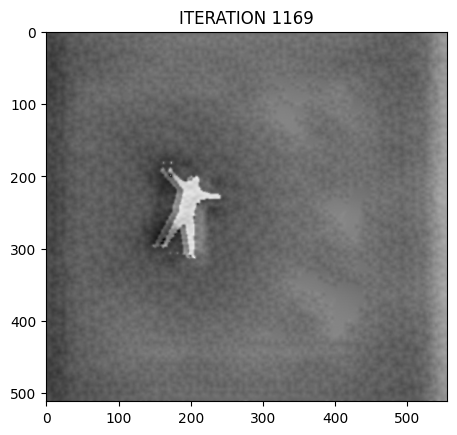

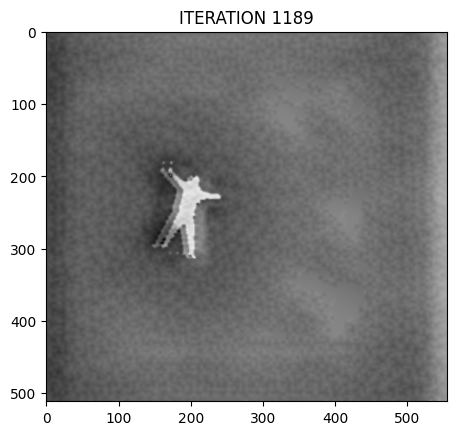

Style Loss: 0.2022 Content Loss: 3.1943



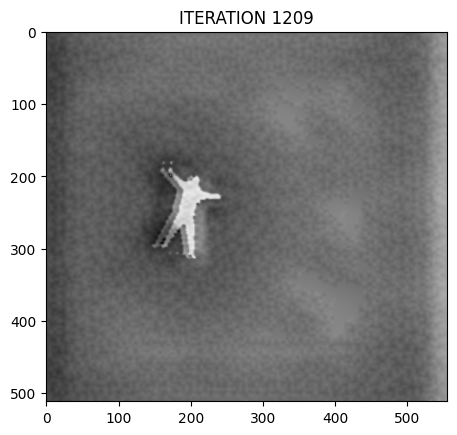

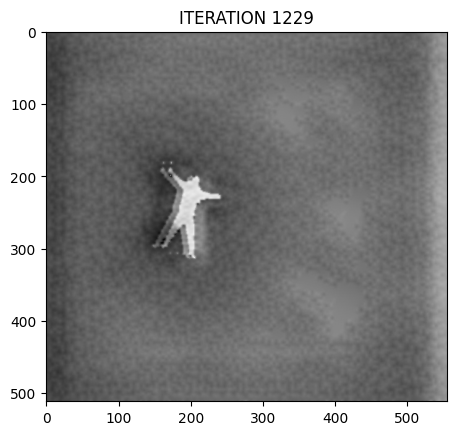

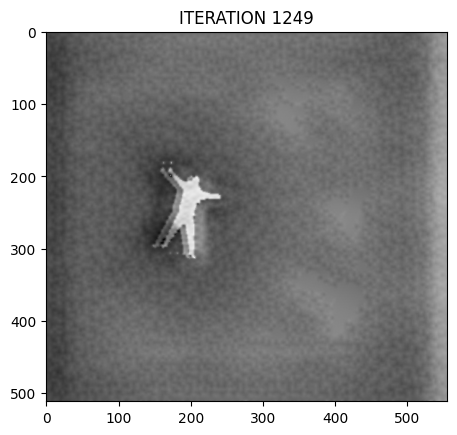

Style Loss: 0.1972 Content Loss: 3.1959



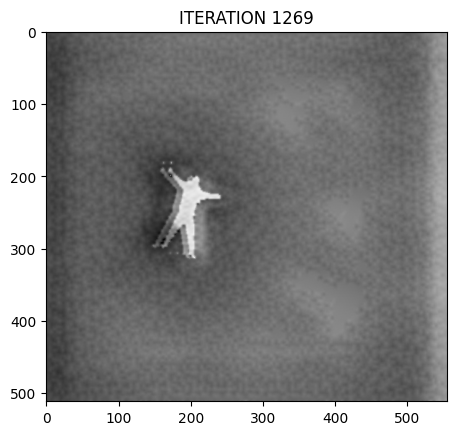

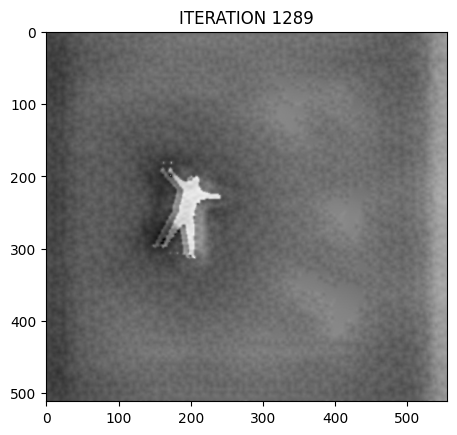

Style Loss: 0.1926 Content Loss: 3.1970



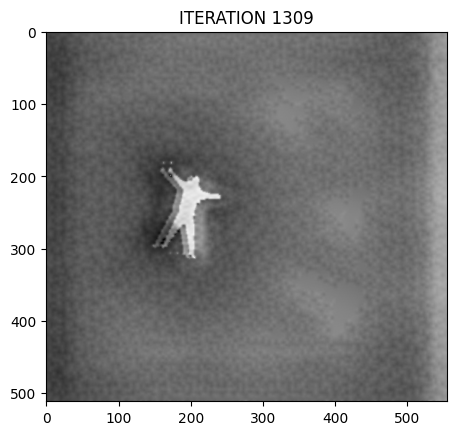

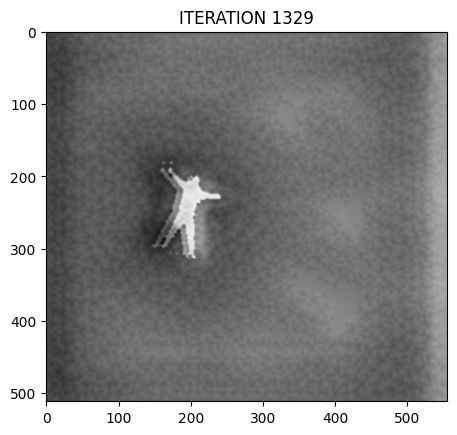

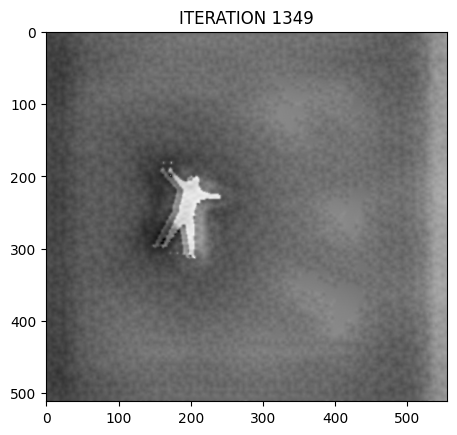

Style Loss: 0.1897 Content Loss: 3.1969



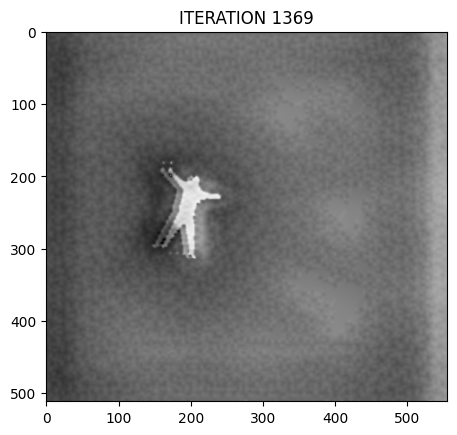

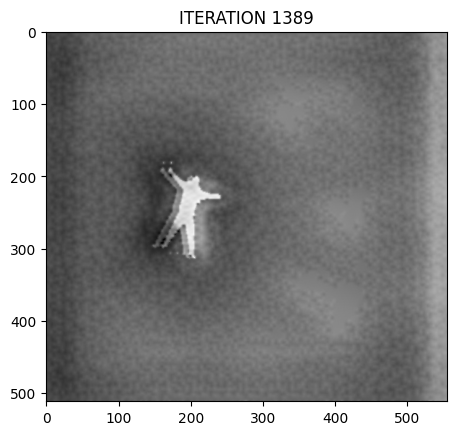

Style Loss: 0.1869 Content Loss: 3.1969



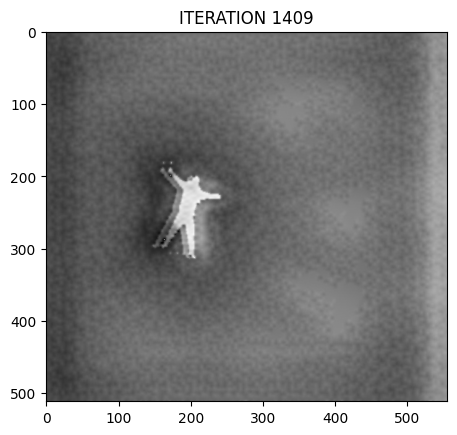

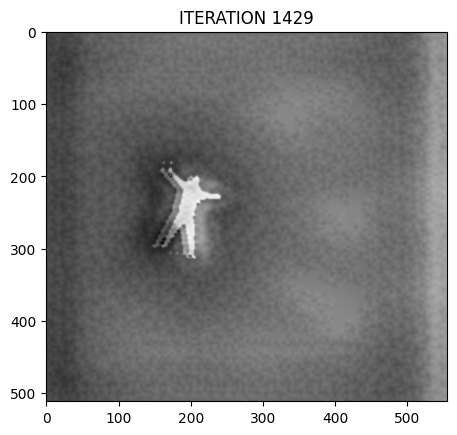

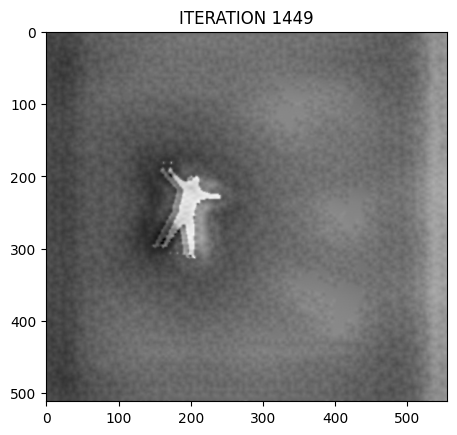

Style Loss: 0.1848 Content Loss: 3.1963



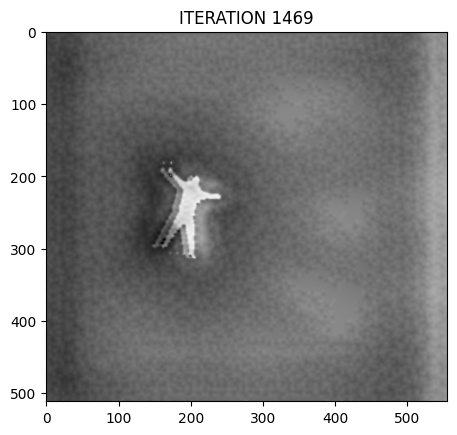

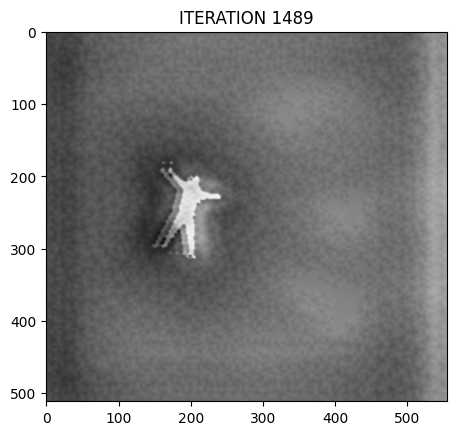

Style Loss: 0.1847 Content Loss: 3.1929



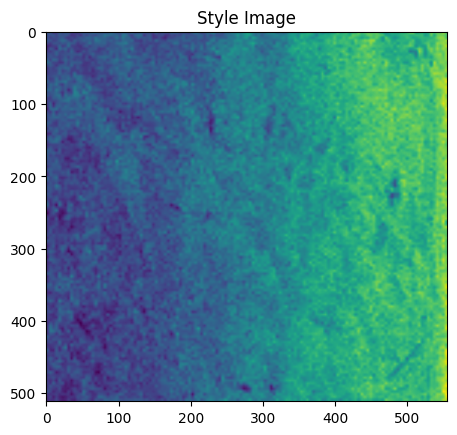

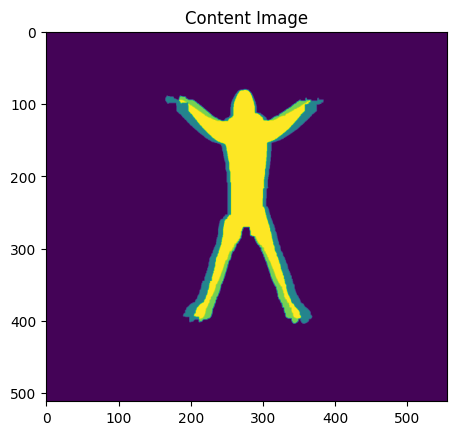

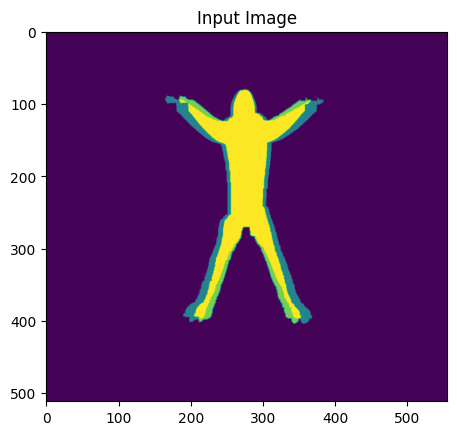

Model Building


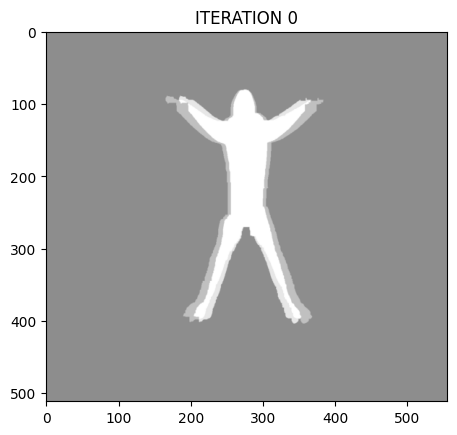

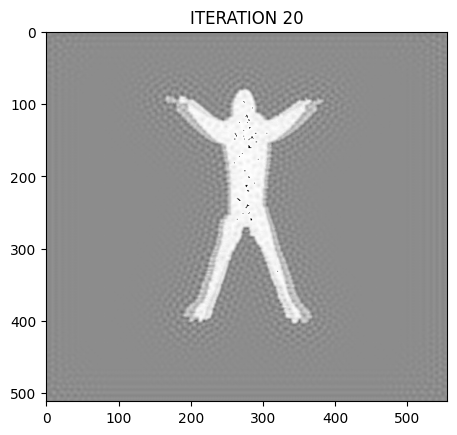

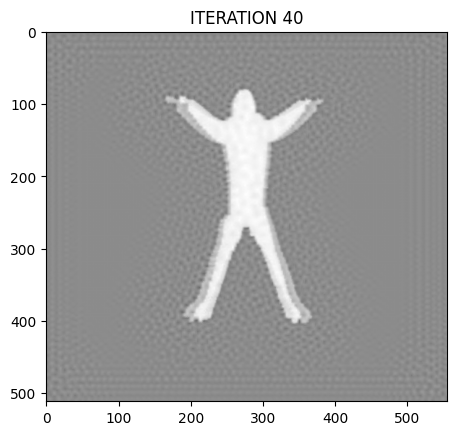

Style Loss: 4.6928 Content Loss: 3.2959



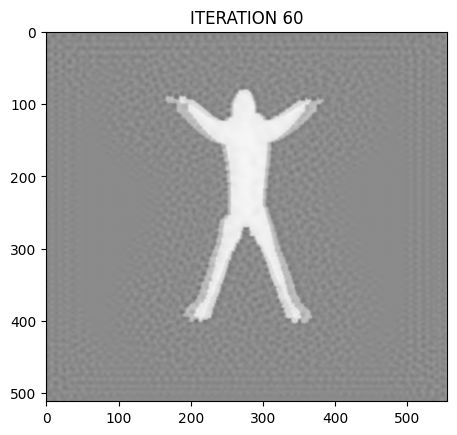

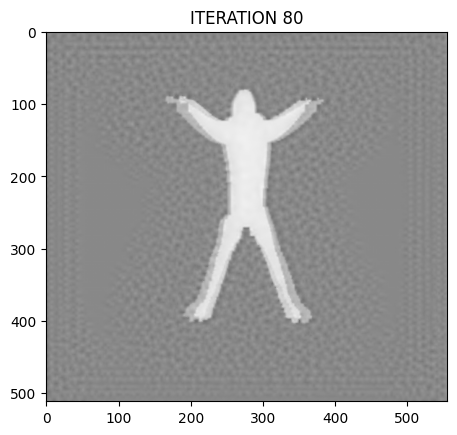

Style Loss: 2.5496 Content Loss: 3.4043



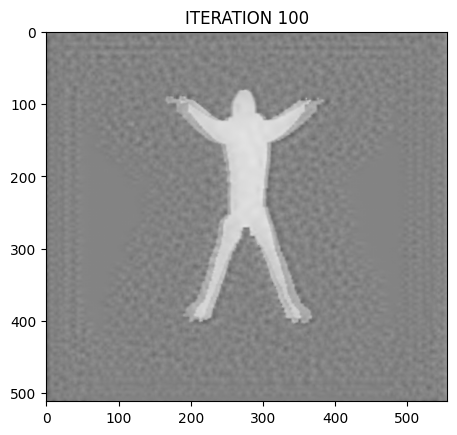

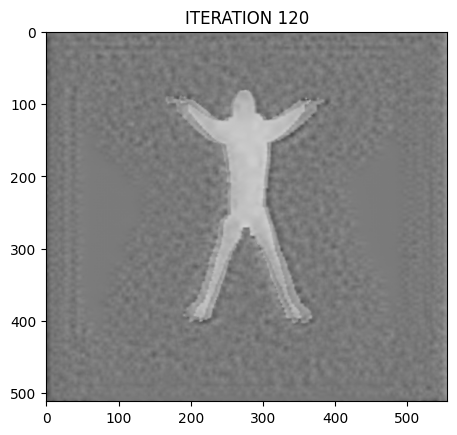

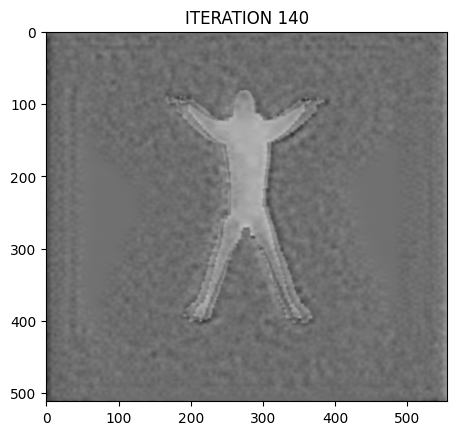

Style Loss: 0.4864 Content Loss: 3.4806



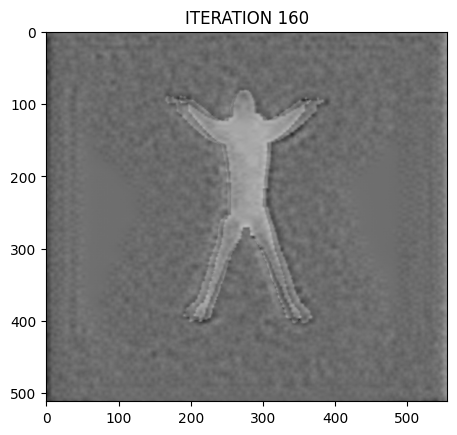

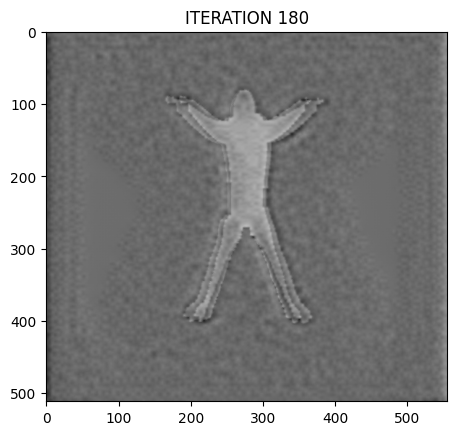

Style Loss: 0.2941 Content Loss: 3.2601



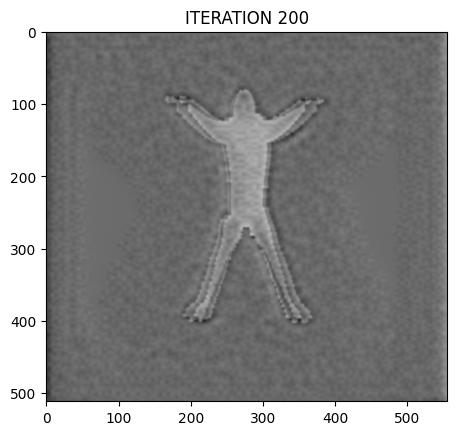

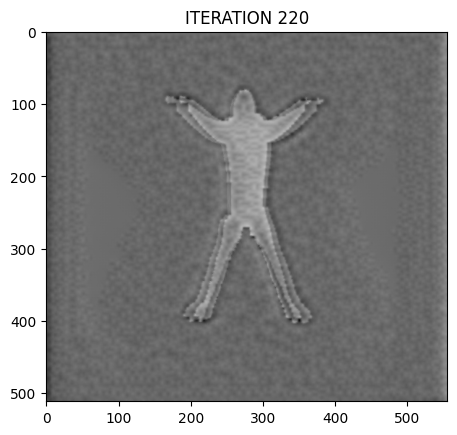

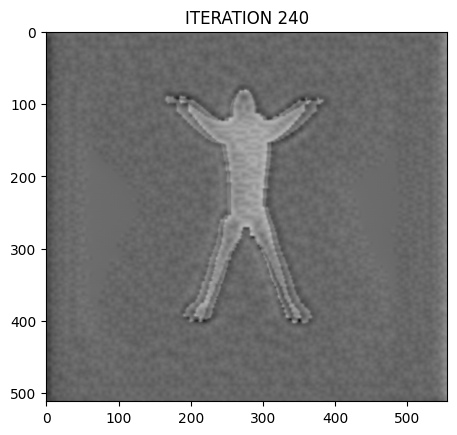

Style Loss: 0.2951 Content Loss: 3.1405



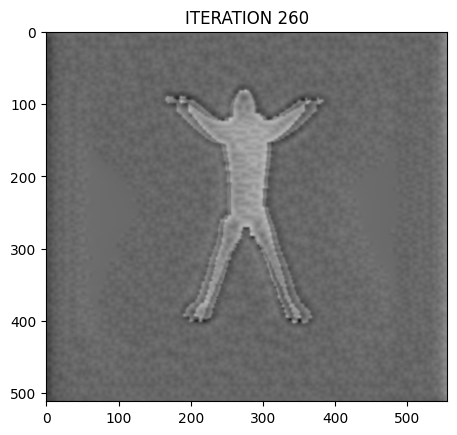

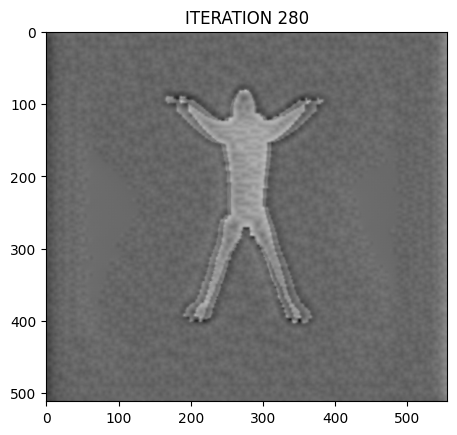

Style Loss: 0.2930 Content Loss: 3.0855



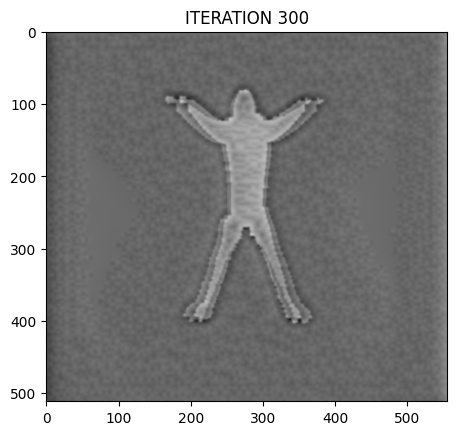

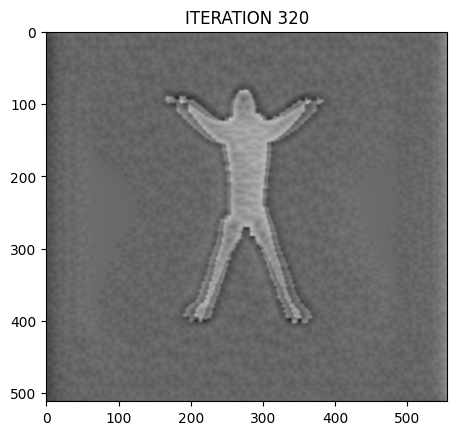

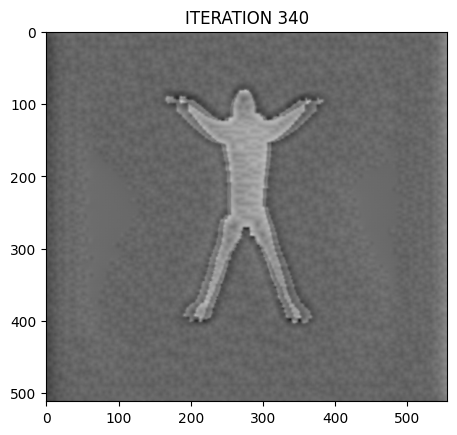

Style Loss: 0.2942 Content Loss: 3.0598



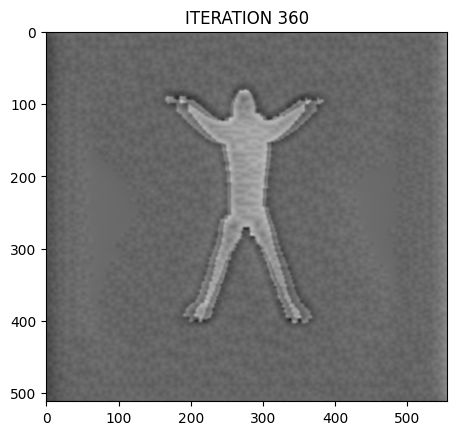

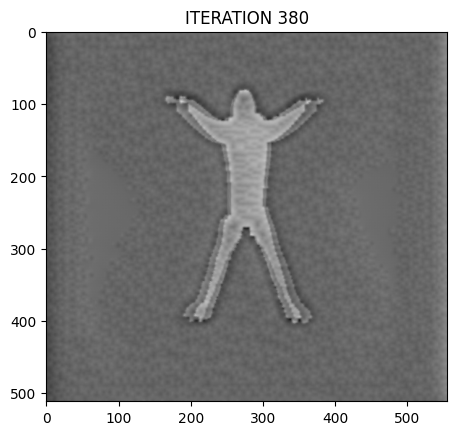

Style Loss: 0.2942 Content Loss: 3.0472



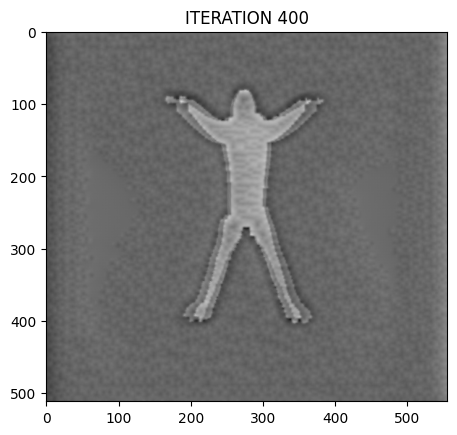

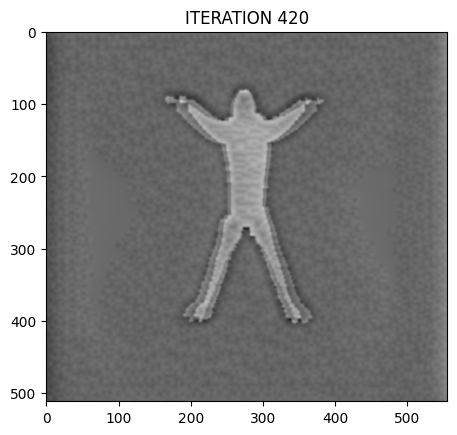

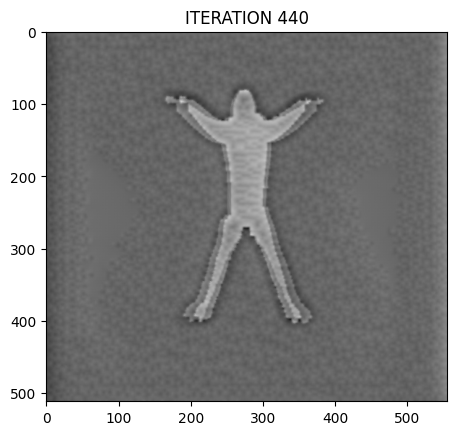

Style Loss: 0.2945 Content Loss: 3.0388



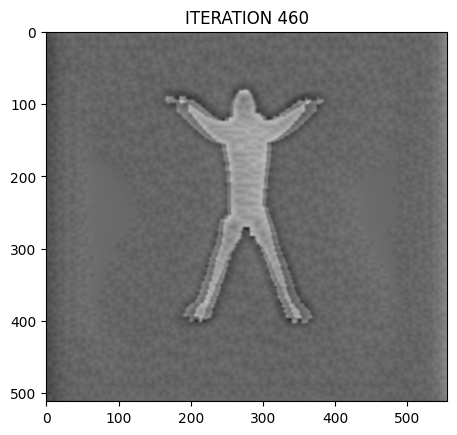

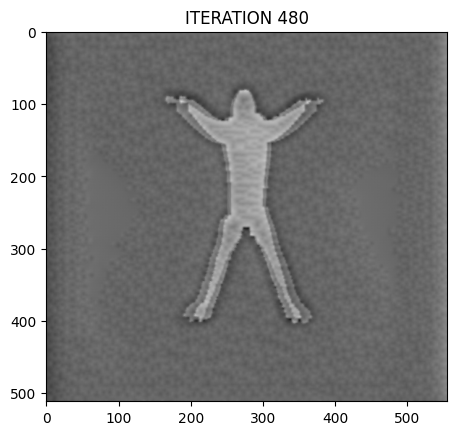

Style Loss: 0.2950 Content Loss: 3.0328



In [ ]:
for i in range(5,11):
  NST(i)

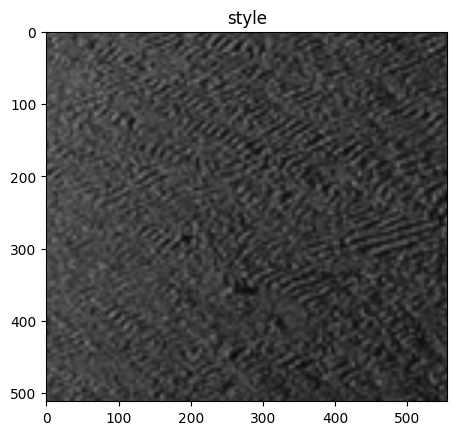

In [ ]:
import torch



# Replicate the grayscale channel to create three channels for RGB
rgb_image_tensor = style_img.expand(-1, 3, -1, -1)

# Now, `rgb_image_tensor` is a 3-channel RGB image tensor with the same content as the original grayscale image.

# Verify the shape of the resulting tensor
imshow(rgb_image_tensor,"style")  # It should be [1, 3, 512, 556]


In [ ]:
print(style_img.shape)
print(content_img.shape)

torch.Size([1, 3, 512, 556])
torch.Size([1, 3, 512, 556])


This code is often used in neural style transfer, and the optimizer choice, in this case, is L-BFGS (Limited-memory Broyden-Fletcher-Goldfarb-Shanno). L-BFGS is a popular optimization algorithm for unconstrained optimization problems, and it's commonly used for style transfer due to its effectiveness in handling optimization challenges specific to this task.

The reason L-BFGS is commonly used in neural style transfer is that it's well-suited for optimizing high-dimensional problems like image generation, where the generated image pixels are the optimization variables. L-BFGS efficiently handles optimization problems with a large number of variables by approximating the inverse Hessian matrix and using it to guide the optimization process.



The VGG-19 model that you imported has a total of 19 layers. It's a deep convolutional neural network architecture that consists of 16 convolutional layers and 3 fully connected layers. The "19" in the model's name refers to the total number of layers in the network.

The architecture is organized into blocks, where each block contains multiple convolutional layers followed by a pooling layer. The first few blocks focus on capturing low-level features like edges and textures, while the deeper blocks capture higher-level features like object parts and complex patterns.

Here's a breakdown of the layers in VGG-19:

Convolutional Blocks (with ReLU activation and optional BatchNormalization):

2 or 3 Convolutional layers (with small filters like 3x3)
1 MaxPooling layer (typically with 2x2 kernel and stride)
Fully Connected (FC) Layers:

3 FC layers
The last FC layer produces the final classification scores (1000 classes for ImageNet)